In [ ]:
# extract year of publication
import json
from crossref.restful import Works


def extract_year_from_crossref(doi):
    works = Works()
    try:
        meta = works.doi(doi)
        return meta['published']['date-parts'][0][0]
    except Exception:
        return None
    

list_path = 'enhanced_doi_list.json'
with open(list_path, 'r') as file:
    data_languages = json.load(file)


with open('../../doi_extraction/doi_output.json', 'r') as file:
    data_dois = json.load(file)


doi_list = data_dois['doi_list']

doi_to_year = {}

# extract the year of publication out of the DOIs
for doi in doi_list:
    year = extract_year_from_crossref(doi)
    if year:
        doi_to_year[doi] = year

# save year of publication in enhanced doi list
for entry in data_languages:
    doi = entry.get('paper', '')
    year = doi_to_year.get(doi, None)
    if year:
        entry['year'] = year


with open(list_path, 'w') as file:
    json.dump(data_languages, file, indent=4)

In [1]:
# copy precision to enhanced doi list
import json

# Load JSON files
with open('selected_entries.json', 'r') as file:
    selected_entries = json.load(file)

with open('enhanced_doi_list.json', 'r') as file:
    enhanced_doi_list = json.load(file)

# Create a mapping from 'out' to precision from selected_entries
out_to_precision = {entry['out']: entry['precision'] for entry in selected_entries if 'precision' in entry}

# Update the enhanced_doi_list with precision values
for entry in enhanced_doi_list:
    if entry['out'] in out_to_precision:
        entry['precision'] = out_to_precision[entry['out']]

# Save the updated enhanced_doi_list
with open('enhanced_doi_list.json', 'w') as file:
    json.dump(enhanced_doi_list, file, indent=4)

print("Updated enhanced_doi_list.json with precision values.")


Updated enhanced_doi_list.json with precision values.


In [6]:
# eliminate duplicates
import json


with open('enhanced_doi_list.json', 'r') as file:
    data = json.load(file)


unique_papers = {}
for entry in data:
    paper = entry['paper']
    if paper not in unique_papers:
        unique_papers[paper] = entry

unique_data = list(unique_papers.values())

with open('enhanced_doi_list_unique.json', 'w') as file:
    json.dump(unique_data, file, indent=4)


print(f"Original number of entries: {len(data)}")
print(f"Number of entries after removing duplicates: {len(unique_data)}")

Original number of entries: 866
Number of entries after removing duplicates: 410


In [4]:
import json
import matplotlib.pyplot as plt
import numpy as np

# Load JSON file
with open('enhanced_doi_list.json', 'r') as file:
    data_quality = json.load(file)

# Lists to store data
years = []
precisions = []
colors = []
precision_scores = []

# Collect data for all entries with precision and precision_score
for entry in data_quality:
    if 'precision' in entry and entry['precision'] is not None and 'precision_score' in entry and entry['precision_score'] is not None:
        year = entry.get('year')
        precision = entry['precision']
        precision_score = entry['precision_score']
        
        if year is not None:
            years.append(year)
            precisions.append(precision)
            precision_scores.append(precision_score)
            # Determine color based on precision_score
            if precision_score == 0:
                colors.append('yellow')
            else:
                colors.append('blue')

# Calculate average precision for all points
average_precision_all = np.mean(precisions)

# Calculate average precision for points with precision_score == 1
precisions_with_score_1 = [precision for precision, score in zip(precisions, precision_scores) if score == 1]
average_precision_score_1 = np.mean(precisions_with_score_1)

# Output the results
print(f'Average precision (all points): {average_precision_all}')
print(f'Average precision (points with precision_score == 1): {average_precision_score_1}')


Average precision (all points): 0.7681893960740114
Average precision (points with precision_score == 1): 0.9386263736263736


In [8]:
with open('enhanced_doi_list_unique.json', 'r') as file:
    data = json.load(file)

precision_score_0 = 0
precision_score_1 = 0

for entry in data:
    if 'precision_score' in entry:
        if entry['precision_score'] == 0:
            precision_score_0 += 1
        elif entry['precision_score'] == 1:
            precision_score_1 += 1

print(f"Number of entries with precision_score 0: {precision_score_0}")
print(f"Number of entries with precision_score 1: {precision_score_1}")

Number of entries with precision_score 0: 67
Number of entries with precision_score 1: 329


In [14]:
import os
import copolextractor.analyzer as az
import yaml

folder_path = '../../test_data'

results = []

file_count = 0
reaction_count = 0
input_files = sorted([f for f in os.listdir(folder_path) if f.endswith(".yaml")])

for filename in input_files:
    file_count += 1
    file_path = os.path.join(folder_path, filename)
    print(file_path)
    try:
        with open(file_path, 'r') as file:
            data = yaml.safe_load(file)
    except yaml.YAMLError:
        continue
    if isinstance(data, dict):
        reaction_count += az.get_total_number_of_reaction_conditions(data)
    else:
        print(f"Unexpected file format of {filename}")

print('number of reactions: ', reaction_count)

../../test_data/paper1.yaml
../../test_data/paper10.yaml
../../test_data/paper2.yaml
../../test_data/paper3.yaml
../../test_data/paper4.yaml
../../test_data/paper5.yaml
../../test_data/paper6.yaml
../../test_data/paper7.yaml
../../test_data/paper8.yaml
../../test_data/paper9.yaml
number of reactions:  33


In [18]:
import json

json_file_path = 'extracted_data_collected.json'

unique_smiles = set()
i=0

with open(json_file_path, 'r') as file:
        data_list = json.load(file)
        for data in data_list:
            i+=1
            unique_smiles.add(data['monomer1'])
            unique_smiles.add(data['monomer2'])

print('Number of unique SMILES:', len(unique_smiles))
print('Number of reactions', i)

Number of unique SMILES: 347
Number of reactions 1138


In [10]:
import datamol as dm
from molfeat.trans.fp import FPVecTransformer
import json
import numpy as np

json_file_path = './collected_data/extracted_data_collected_without_fp.json'

def convert_smiles_to_fingerprint(smiles: str):
    converted_smiles = dm.freesolv().iloc[:100].smiles
    
    transformer = FPVecTransformer(kind='fcfp', dtype=float)
    features = transformer(converted_smiles)
    return features[0].tolist()
    

with open(json_file_path, 'r') as file:
        data_list = json.load(file)

for data in data_list:
    print('processing ', data)
    smiles_1 = data['monomer1']
    smiles_2 = data['monomer2']
    solvent_smiles = data['solvent']
    
    fingerprint_1 = convert_smiles_to_fingerprint(smiles_1)
    fingerprint_2 = convert_smiles_to_fingerprint(smiles_2)
    if solvent_smiles is not None:
        fingerprint_solvent = convert_smiles_to_fingerprint(solvent_smiles)
    else:
        transformer = FPVecTransformer(kind='fcfp', dtype=float)
        dummy_smiles = dm.freesolv().iloc[:1].smiles
        features = transformer(dummy_smiles)
        zero_fingerprint = np.zeros_like(features[0])
        fingerprint_solvent = zero_fingerprint.tolist()
    
    
    data['fingerprint_1'] = fingerprint_1
    data['fingerprint_2'] = fingerprint_2
    data['solvent_fingerprint'] = fingerprint_solvent
    
    try:
        with open('extracted_data_with_fp', 'w') as file:
            json.dump(data_list, file, indent=4)
    except Exception as e:
        print(f"Error writing to JSON file: {e}")

processing  {'file': 'paper01.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methacrylic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.54, 'constant_2': 0.06}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'ClC(Cl)(Cl)Cl', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper01.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methacrylic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.51, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper01.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methacrylic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.43, 'constant_2': 0.65}, 'conf_intervals': {'constant_conf_1': 0.0, 'constant_conf_2': 0.02}, 't

[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerator
[12:55:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper01.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methacrylic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.06, 'constant_2': 0.29}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.0}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper02.json', 'monomer1_s': 'C=Cc1ccccn1', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': '2-Vinylpyridine', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 1.55, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': None, 'method': 'bulk', 'r-product': None}
processing  {'file': 'paper_0.json', 'monomer1_s': 'C=C', 'monomer2_s': 'C=O', 'monomer1': 'ethylene', 'monomer2': 'carbon monoxide', 'r_values': {'constant_1': 22.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 20.0, 'solvent': 

[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_10.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methacrylic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.51, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'solvent', 'r-product': 0.04}
processing  {'file': 'paper_10.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methacrylic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.43, 'constant_2': 0.65}, 'conf_intervals': {'constant_conf_1': 0.0, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.27}
processing  {'file': 'paper_10.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methacrylic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.41, 'constant_2': 0.59}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.05}, 'temp

[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_100.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': 'styrene', 'monomer2': 'maleimide', 'r_values': {'constant_1': 0.1, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_100.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': 'vinylidene chloride', 'monomer2': 'maleimide', 'r_values': {'constant_1': 0.71, 'constant_2': 0.48}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_100.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': 'methyl methacrylate', 'monomer2': 'maleimide', 'r_values': {'constant_1': 2.5, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2'

[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_100.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'CC1=CC(=O)N(C)C1=O', 'monomer1': 'methyl methacrylate', 'monomer2': 'N-methyl citraconimide', 'r_values': {'constant_1': 3.24, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_102.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'methyl methacrylate', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 2.0, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_102.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'methyl methacrylate', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 2.0, 'constant_2': 0.2}

[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerator
[12:55:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_102.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'methyl acrylate', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 0.5, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_102.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'methyl acrylate', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 0.5, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_102.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'styrene', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 5.7, 'constant_2': 0.035}, 'conf_intervals': {'constant_

[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_102.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'styrene', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 5.5, 'constant_2': 0.012}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_102.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'vinylidene chloride', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 0.02, 'constant_2': 3.7}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_102.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'vinylidene chloride', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 0.02, 'constant_2': 3.7}, 'conf_intervals': {'con

[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_102.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'vinyl acetate', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 0.126, 'constant_2': 2.68}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_102.json', 'monomer1_s': 'C=Cc1cc(Cl)ccc1Cl', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': '2,5-dichlorostyrene', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 8.0, 'constant_2': 0.016}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_107.json', 'monomer1_s': 'C=CC(=O)NCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'N-Octadecylacrylamide', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.44, 'constant_2': 1.1}, 'conf_i

[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_107.json', 'monomer1_s': 'C=CC(=O)NCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'N-Octadecylacrylamide', 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 1.37, 'constant_2': 0.438}, 'conf_intervals': {'constant_conf_1': 0.008, 'constant_conf_2': 0.008}, 'temperature': 60.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_107.json', 'monomer1_s': 'C=CC(=O)NCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Octadecylacrylamide', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 6.11, 'constant_2': 0.027}, 'conf_intervals': {'constant_conf_1': 0.045, 'constant_conf_2': 0.009}, 'temperature': 60.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_107.json', 'monomer1_s': 'C=CCNC(=O)CCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'N-Allylstearamide', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.118, 'constant_2

[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerator
[12:55:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_107.json', 'monomer1_s': 'C=CCNC(=O)CCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'N-Allylstearamide', 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 0.0, 'constant_2': 5.23}, 'conf_intervals': {'constant_conf_1': 0.136, 'constant_conf_2': 0.067}, 'temperature': 80.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_107.json', 'monomer1_s': 'C=CCNC(=O)CCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Allylstearamide', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.532, 'constant_2': 0.74}, 'conf_intervals': {'constant_conf_1': 0.012, 'constant_conf_2': 0.087}, 'temperature': 80.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_108.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CN1CCOC1=O', 'monomer1': 'vinyl acetate', 'monomer2': 'vinyl oxazolidinone', 'r_values': {'constant_1': 0.6, 'constant_2': 1.5}, 'conf_interv

[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_108.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=CN1CCOC1=O', 'monomer1': 'vinylidene chloride', 'monomer2': 'vinyl oxazolidinone', 'r_values': {'constant_1': 1.35, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_108.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CN1CCOC1=O', 'monomer1': 'methyl methacrylate', 'monomer2': 'vinyl oxazolidinone', 'r_values': {'constant_1': 6.0, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_109.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CN1C(=O)CCC1=O', 'monomer1': 'Styrene', 'monomer2': 'N-Vinylsuccinimide', 'r_values': {'constant_1': 0.07, 'constant_2': 10.5}, 'conf_intervals': {'constant_conf_

[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_109.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CN1C(=O)CCC1=O', 'monomer1': 'Methylmethacrylate', 'monomer2': 'N-Vinylsuccinimide', 'r_values': {'constant_1': 0.064, 'constant_2': 9.5}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}
processing  {'file': 'paper_109.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=CN1C(=O)CCC1=O', 'monomer1': 'Vinylidene chloride', 'monomer2': 'N-Vinylsuccinimide', 'r_values': {'constant_1': 0.32, 'constant_2': 1.44}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}
processing  {'file': 'paper_109.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CN1C(=O)CCC1=O', 'monomer1': 'Vinyl acetate', 'monomer2': 'N-Vinylsuccinimide', 'r_values': {'constant_1': 6.1, 'constant_2': 0.14}, 'conf_intervals': {'constant_conf_1': None, 

[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_110.json', 'monomer1_s': 'COC(=O)C=C(CC(=O)OC)C(=O)OC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Trimethyl aconitate', 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 0.01, 'constant_2': 54.0}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 5.0}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_112.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': "2-Phenyl-5-(4'-vinyl)phenyltetrazole", 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.26, 'constant_2': 0.89}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.06}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerator
[12:55:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_112.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': "2-Phenyl-5-(4'-vinyl)phenyltetrazole", 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.67, 'constant_2': 0.98}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_112.json', 'monomer1_s': None, 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': "2-Phenyl-5-(4'-vinyl)phenyltetrazole", 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 2.24, 'constant_2': 0.24}, 'conf_intervals': {'constant_conf_1': 0.25, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_112.json', 'monomer1_s': None, 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': "2-Phenyl-5-(4'-vinyl)phenyltetrazole", 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 1.49, 'constant_2': 0.26}, 'conf_intervals': {'constant_conf_1': 0.15, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_112.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': "2-Phenyl-5-(4'-vinyl)phenyltetrazole", 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.22, 'constant_2': 0.73}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_112.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': "2-Phenyl-5-(4'-vinyl)phenyltetrazole", 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.55, 'constant_2': 0.86}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.2}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_123.json', 'monomer1_s': 'C=Cc1ccccn1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-Vinyl pyridine', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.81, 'constant_2': 0.55}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_123.json', 'monomer1_s': 'C=Cc1ccccn1', 'monomer2_s': 'C=CC(=C)C', 'monomer1': '2-Vinyl pyridine', 'monomer2': 'Isoprene', 'r_values': {'constant_1': 0.47, 'constant_2': 0.59}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}
processing  {'file': 'paper_123.json', 'monomer1_s': 'C=Cc1ccccn1', 'monomer2_s': 'C=CC(=C)Cl', 'monomer1': '2-Vinyl pyridine', 'monomer2': 'Chloroprene', 'r_values': {'constant_1': 0.06, 'constant_2': 5.19}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerator
[12:56:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_123.json', 'monomer1_s': 'C=Cc1ccccn1', 'monomer2_s': 'C=CC#N', 'monomer1': '2-Vinyl pyridine', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 21.88, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 5.52, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}
processing  {'file': 'paper_123.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-Vinyl quinoline', 'monomer2': 'Styrene', 'r_values': {'constant_1': 2.09, 'constant_2': 0.49}, 'conf_intervals': {'constant_conf_1': 0.55, 'constant_conf_2': 0.14}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_123.json', 'monomer1_s': None, 'monomer2_s': 'C=CC(=C)C', 'monomer1': '2-Vinyl quinoline', 'monomer2': 'Isoprene', 'r_values': {'constant_1': 1.88, 'constant_2': 0.53}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}
processing  {'file': 'paper_123.json', 'monomer1_s': None, 'monomer2_s': 'C=CC(=C)Cl', 'monomer1': '2-Vinyl quinoline', 'monomer2': 'Chloroprene', 'r_values': {'constant_1': 0.38, 'constant_2': 2.1}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_124.json', 'monomer1_s': 'C=CC=CF', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Fluorobutadiene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.61, 'constant_2': 0.16}, 'conf_intervals': {'constant_conf_1': 0.24, 'constant_conf_2': 0.08}, 'temperature': 5.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}
processing  {'file': 'paper_124.json', 'monomer1_s': 'C=CC=CF', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Fluorobutadiene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.55, 'constant_2': 0.5}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_124.json', 'monomer1_s': 'C=CC=CF', 'monomer2_s': 'C=CC#N', 'monomer1': 'Fluorobutadiene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.55, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.03}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}
processing  {'file': 'paper_124.json', 'monomer1_s': 'C=CC=CF', 'monomer2_s': 'C=CC(=C)C', 'monomer1': 'Fluorobutadiene', 'monomer2': 'Isoprene', 'r_values': {'constant_1': 2.05, 'constant_2': 0.19}, 'conf_intervals': {'constant_conf_1': 0.19, 'constant_conf_2': 0.1}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerator
[12:56:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_124.json', 'monomer1_s': 'C=CC=CF', 'monomer2_s': 'C=C(C)c1ccccc1', 'monomer1': 'Fluorobutadiene', 'monomer2': 'Alpha methyl styrene', 'r_values': {'constant_1': 1.77, 'constant_2': 0.38}, 'conf_intervals': {'constant_conf_1': 0.19, 'constant_conf_2': 0.1}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}
processing  {'file': 'paper_124.json', 'monomer1_s': 'C=CC=CF', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Fluorobutadiene', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 1.54, 'constant_2': 0.64}, 'conf_intervals': {'constant_conf_1': 0.8, 'constant_conf_2': 0.08}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_125.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': 1.06, 'constant_2': 6.41}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 6.79}
processing  {'file': 'paper_125.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': 0.88, 'constant_2': 1.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': 1.04}


[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_125.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=C(C)C(N)=O', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': 'Methacrylamide', 'r_values': {'constant_1': 0.29, 'constant_2': 3.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.88}
processing  {'file': 'paper_125.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=C(C)C(N)=O', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': 'Methacrylamide', 'r_values': {'constant_1': 0.37, 'constant_2': 2.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': 0.76}


[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_125.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=C(C)C(=O)NC', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': "N,N'-dimethylacrylamide", 'r_values': {'constant_1': 0.95, 'constant_2': 0.26}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.83}
processing  {'file': 'paper_133.json', 'monomer1_s': 'C=CC(=O)O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'Acrylic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': 1.73, 'constant_2': 0.48}, 'conf_intervals': {'constant_conf_1': 0.21, 'constant_conf_2': 0.06}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerator
[12:56:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_133.json', 'monomer1_s': 'C=CC(=O)O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'Acrylic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': 0.56, 'constant_2': 0.56}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.09}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_133.json', 'monomer1_s': 'C=CC(=O)O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'Acrylic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': 0.45, 'constant_2': 0.67}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_133.json', 'monomer1_s': 'C=CC(=O)O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'Acrylic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': 0.42, 'constant_2': 0.95}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_133.json', 'monomer1_s': 'C=CC(=O)O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'Acrylic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': 0.35, 'constant_2': 1.32}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.12}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_135.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'acrylamide', 'monomer2': 'styrene', 'r_values': {'constant_1': 1.38, 'constant_2': 1.27}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.17}, 'temperature': 70.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_135.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'acrylamide', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.59, 'constant_2': 1.13}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.05}, 'temperature': 70.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerator
[12:56:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_135.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'acrylamide', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.3, 'constant_2': 1.44}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.22}, 'temperature': 70.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_135.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'acrylamide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 2.45, 'constant_2': 2.55}, 'conf_intervals': {'constant_conf_1': 0.35, 'constant_conf_2': 0.4}, 'temperature': 70.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_135.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'acrylamide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.82, 'constant_2': 2.53}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.22}, 'temperature': 70.0, 'solvent': None, 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_135.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'acrylamide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.44, 'constant_2': 2.6}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.21}, 'temperature': 70.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_138.json', 'monomer1_s': 'C=CNC(C)=O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'N-Vinylacetamide', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': 0.3, 'constant_2': 1.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': 0.42}
processing  {'file': 'paper_138.json', 'monomer1_s': 'C=CNC(C)=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Vinylacetamide', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 5.5, 'constant_2': 0.6}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': 3.3}


[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_138.json', 'monomer1_s': 'C=CNC(C)=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Vinylacetamide', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 21.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_138.json', 'monomer1_s': 'C=CNC(C)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-Vinylacetamide', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.19, 'constant_2': 2.65}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': 0.5}


[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerator
[12:56:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_138.json', 'monomer1_s': 'C=CNC(C)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-Vinylacetamide', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.71, 'constant_2': 1.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.83}
processing  {'file': 'paper_138.json', 'monomer1_s': 'C=CNC(C)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-Vinylacetamide', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.01, 'constant_2': 2.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.21}


[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_139.json', 'monomer1_s': 'C/C=C\\C(=O)O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'cis-Crotonic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': -0.21, 'constant_2': 4.0}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.3}, 'temperature': 20.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.25}
processing  {'file': 'paper_139.json', 'monomer1_s': 'C/C=C/C(=O)O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'trans-Crotonic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': -0.09, 'constant_2': 6.5}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.4}, 'temperature': 20.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.15}


[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_139.json', 'monomer1_s': 'O=C(O)/C=C\\Br', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'cis-3-Bromoacrylic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': -0.14, 'constant_2': 12.0}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.5}, 'temperature': 20.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.08}
processing  {'file': 'paper_139.json', 'monomer1_s': 'O=C(O)/C=C/Br', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'trans-3-Bromoacrylic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': -0.21, 'constant_2': 6.5}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.6}, 'temperature': 20.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.15}


[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerator
[12:56:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_139.json', 'monomer1_s': 'O=C(O)/C=C\\c1ccccc1', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'cis-Cinnamic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': -0.22, 'constant_2': 6.7}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.6}, 'temperature': 20.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.15}
processing  {'file': 'paper_139.json', 'monomer1_s': 'O=C(O)/C=C/c1ccccc1', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'trans-Cinnamic acid', 'monomer2': 'Acrylamide', 'r_values': {'constant_1': -0.26, 'constant_2': 3.0}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.2}, 'temperature': 20.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.33}


[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_151.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 0.98, 'constant_2': 0.68}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.05}, 'temperature': 45.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_151.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 0.55, 'constant_2': 1.55}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.06}, 'temperature': 45.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerator
[12:56:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_151.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Styrene', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 1.1, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.03}, 'temperature': 45.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_151.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Styrene', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 0.2, 'constant_2': 0.66}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.08}, 'temperature': 45.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_151.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'Methyl Acrylate', 'monomer2': 'Acrylic Acid', 'r_values': {'constant_1': 0.98, 'constant_2': 0.42}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 45.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_151.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'Methyl Acrylate', 'monomer2': 'Acrylic Acid', 'r_values': {'constant_1': 0.95, 'constant_2': 1.1}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.06}, 'temperature': 45.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_154.json', 'monomer1_s': 'C=CC(=O)N(C)C', 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'N,N-Dimethylacrylamide', 'monomer2': 'Acrylic Acid', 'r_values': {'constant_1': 0.5, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.05}, 'temperature': 75.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_158.json', 'monomer1_s': None, 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'alpha-Phenylvinylphosphinic acid', 'monomer2': 'Acrylic acid', 'r_values': {'constant_1': 0.44, 'constant_2': 0.98}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.08}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.43}


[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerator
[12:56:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_158.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'alpha-Phenylvinylphosphinic acid', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.32, 'constant_2': 0.69}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.18}, 'temperature': 70.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': 0.22}


[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_16.json', 'monomer1_s': 'C=C(CC)C(=O)O', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': '2-Ethylacrylic acid', 'monomer2': 'Methacrylic acid', 'r_values': {'constant_1': 1.14, 'constant_2': 0.23}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}
processing  {'file': 'paper_16.json', 'monomer1_s': 'C=C(CC)C(=O)O', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': '2-Ethylacrylic acid', 'monomer2': 'Methacrylic acid', 'r_values': {'constant_1': 1.91, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_160.json', 'monomer1_s': None, 'monomer2_s': None, 'monomer1': 'Diethylcarbamidsäurevinylester', 'monomer2': 'Acrylsäuremethylester', 'r_values': {'constant_1': 0.01, 'constant_2': 4.45}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 9.0}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_160.json', 'monomer1_s': None, 'monomer2_s': None, 'monomer1': 'Diethylcarbamidsäurevinylester', 'monomer2': 'Acrylsäure', 'r_values': {'constant_1': 0.09, 'constant_2': 5.55}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 2.0}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_160.json', 'monomer1_s': None, 'monomer2_s': None, 'monomer1': 'Diethylcarbamidsäurevinylester', 'monomer2': 'Maleinsäureanhydrid', 'r_values': {'constant_1': 0.035, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.055, 'constant_conf_2': 0.003}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerator
[12:56:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_161.json', 'monomer1_s': 'C=CCCNC(=O)OCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Vinylethylurethane', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.33, 'constant_2': 0.33}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': 0.109}
processing  {'file': 'paper_161.json', 'monomer1_s': 'C=CCCNC(=O)OCC', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'N-Vinylethylurethane', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 0.42, 'constant_2': 2.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': 0.84}


[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_162.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1cc(O)ccc1O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Vinylhydroquinone', 'r_values': {'constant_1': 0.62, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerator
[12:56:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_162.json', 'monomer1_s': 'C=Cc1ccncc1', 'monomer2_s': 'C=Cc1cc(O)ccc1O', 'monomer1': '4-Vinylpyridine', 'monomer2': 'Vinylhydroquinone', 'r_values': {'constant_1': 0.58, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_162.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=Cc1cc(O)ccc1O', 'monomer1': 'Acrylamide', 'monomer2': 'Vinylhydroquinone', 'r_values': {'constant_1': 0.35, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}
processing  {'file': 'paper_163.json', 'monomer1_s': 'C=Cc1cc(O)ccc1O.O=C(O)c1ccccc1.O=C(O)c1ccccc1', 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'vinylhydroquinone dibenzoate', 'monomer2': 'acrylic acid', 'r_values': {'constant_1': 0.44, 'constant_2': 0.95}, 'conf_intervals': {'constant_conf_1': 0.13, 'constant_conf_2': 0.002}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_163.json', 'monomer1_s': 'C=Cc1cc(O)ccc1O.O=C(O)c1ccccc1.O=C(O)c1ccccc1', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'vinylhydroquinone dibenzoate', 'monomer2': 'methacrylic acid', 'r_values': {'constant_1': 1.91, 'constant_2': 0.91}, 'conf_intervals': {'constant_conf_1': 0.23, 'constant_conf_2': 0.25}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_165.json', 'monomer1_s': 'C=C(C)C(N)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Methacrylamide', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.47, 'constant_2': 1.5}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.02}, 'temperature': 65.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': 1.42}


[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerator
[12:56:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_165.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Methacrylic acid', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 1.5, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.05}, 'temperature': 65.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 2.22}


[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_165.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=C(C)C(N)=O', 'monomer1': 'Methacrylic acid', 'monomer2': 'Methacrylamide', 'r_values': {'constant_1': 2.0, 'constant_2': 0.22}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': 2.28}


[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_169.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cc1cccc2c1[nH]c1ccccc12', 'monomer1': 'Styrene', 'monomer2': 'Vinyl Carbazole', 'r_values': {'constant_1': 5.5, 'constant_2': 0.012}, 'conf_intervals': {'constant_conf_1': 0.825, 'constant_conf_2': 0.0018}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_169.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1cccc2c1[nH]c1ccccc12', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Vinyl Carbazole', 'r_values': {'constant_1': 2.0, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.03}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_169.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(Cl)CCl', 'monomer1': 'Styrene', 'monomer2': '1,2-Dichloro-2-propene', 'r_values': {'constant_1': 5.0, 'constant_2': 0.06}, 'conf_intervals': {'constant_conf_1': 0.75, 'constant_conf_2': 0.009}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerator
[12:56:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_169.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(Cl)CCl', 'monomer1': 'Methyl Methacrylate', 'monomer2': '1,2-Dichloro-2-propene', 'r_values': {'constant_1': 5.5, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': 0.825, 'constant_conf_2': 0.0255}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_171.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'FC(F)=C(F)Cl', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Chlorotrifluoroethylene', 'r_values': {'constant_1': 0.005, 'constant_2': 75.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.3, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_171.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'FC(F)=C(F)Cl', 'monomer1': 'Styrene', 'monomer2': 'Chlorotrifluoroethylene', 'r_values': {'constant_1': 0.001, 'constant_2': 7.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.3, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_171.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'FC(F)=C(F)Cl', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Chlorotrifluoroethylene', 'r_values': {'constant_1': 0.01, 'constant_2': 0.6}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.3, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': None}


[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerator
[12:56:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_173.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 4.781, 'constant_2': 0.006}, 'conf_intervals': {'constant_conf_1': 0.236, 'constant_conf_2': 2.286}, 'temperature': 60.0, 'solvent': 'COC(=O)C(C)C', 'method': 'solvent', 'r-product': None}


[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_173.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 5.932, 'constant_2': 0.014}, 'conf_intervals': {'constant_conf_1': 0.198, 'constant_conf_2': 0.899}, 'temperature': 60.0, 'solvent': 'CN1CCCC1=O', 'method': 'solvent', 'r-product': None}


[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_173.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 2.073, 'constant_2': 0.027}, 'conf_intervals': {'constant_conf_1': 0.247, 'constant_conf_2': 0.0624}, 'temperature': 60.0, 'solvent': 'C1CCCCC1', 'method': 'solvent', 'r-product': None}


[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_173.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 4.041, 'constant_2': 0.066}, 'conf_intervals': {'constant_conf_1': 0.956, 'constant_conf_2': 0.965}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCC', 'monomer1': 'methyl methacrylate', 'monomer2': 'ethyl methacrylate', 'r_values': {'constant_1': 0.92, 'constant_2': 1.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerator
[12:56:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCC', 'monomer1': 'methyl methacrylate', 'monomer2': 'ethyl methacrylate', 'r_values': {'constant_1': 0.98, 'constant_2': 1.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC1CCCCC1', 'monomer1': 'methyl methacrylate', 'monomer2': 'cyclohexyl methacrylate', 'r_values': {'constant_1': 0.86, 'constant_2': 1.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC1CCCCC1', 'monomer1': 'methyl methacrylate', 'monomer2': 'cyclohexyl methacrylate', 'r_values': {'constant_1': 1.96, 'constant_2': 0.49}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCc1ccccc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'benzyl methacrylate', 'r_values': {'constant_1': 0.93, 'constant_2': 1.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerator
[12:56:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCc1ccccc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'benzyl methacrylate', 'r_values': {'constant_1': 0.9, 'constant_2': 1.17}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1ccccc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'phenyl methacrylate', 'r_values': {'constant_1': 0.53, 'constant_2': 1.67}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1ccccc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'phenyl methacrylate', 'r_values': {'constant_1': 0.58, 'constant_2': 1.69}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OCc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)Oc1ccccc1', 'monomer1': 'benzyl methacrylate', 'monomer2': 'phenyl methacrylate', 'r_values': {'constant_1': 0.65, 'constant_2': 1.42}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerator
[12:56:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_174.json', 'monomer1_s': 'C=C(C)C(=O)OCc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)Oc1ccccc1', 'monomer1': 'benzyl methacrylate', 'monomer2': 'phenyl methacrylate', 'r_values': {'constant_1': 0.65, 'constant_2': 1.42}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_177.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.41, 'constant_2': 0.57}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_177.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)c1ccccc1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Alpha-methyl styrene', 'r_values': {'constant_1': 0.42, 'constant_2': 0.22}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_177.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(C)c1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'Alpha-methyl styrene', 'r_values': {'constant_1': 0.03, 'constant_2': 0.14}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerator
[12:56:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_177.json', 'monomer1_s': 'C=C(C)C#N', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methacrylonitrile', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.21, 'constant_2': 0.34}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_177.json', 'monomer1_s': 'C=C(C)C(=O)OCCCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Butyl methacrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.59, 'constant_2': 0.74}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_179.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'acrylamide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 3.05, 'constant_2': 0.982}, 'conf_intervals': {'constant_conf_1': 0.274, 'constant_conf_2': 0.09}, 'temperature': 65.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 2.995}


[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_179.json', 'monomer1_s': 'C=CC(=O)NC', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-methylacrylamide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.202, 'constant_2': 0.178}, 'conf_intervals': {'constant_conf_1': 0.11, 'constant_conf_2': 0.025}, 'temperature': 65.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.214}


[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerator
[12:56:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_179.json', 'monomer1_s': 'C=CC(=O)N(C)C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N,N-dimethylacrylamide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 2.65, 'constant_2': 0.218}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.017}, 'temperature': 65.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.578}


[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_179.json', 'monomer1_s': 'C=CN1CCCC1=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '1-vinyl-2-pyrrolidone', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 3.963, 'constant_2': 0.023}, 'conf_intervals': {'constant_conf_1': 0.048, 'constant_conf_2': 0.011}, 'temperature': 65.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.091}


[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_179.json', 'monomer1_s': 'C=Cc1ccncc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '4-vinylpyridine', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.543, 'constant_2': 1.05}, 'conf_intervals': {'constant_conf_1': 0.025, 'constant_conf_2': 0.02}, 'temperature': 65.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': 0.57}


[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_179.json', 'monomer1_s': 'C=C(C)C(=O)OCCN(C)C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-dimethylaminoethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.416, 'constant_2': 0.963}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.015}, 'temperature': 65.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.401}


[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerator
[12:56:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_18.json', 'monomer1_s': 'C=CC(=C)Cl', 'monomer2_s': 'C=C(C)C(C)=O', 'monomer1': '2-Chloro-1,3-butadiene', 'monomer2': 'Methyl isopropenyl ketone', 'r_values': {'constant_1': 3.6, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.05}, 'temperature': 40.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_18.json', 'monomer1_s': 'C=CC(=C)Cl', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': '2-Chloro-1,3-butadiene', 'monomer2': 'Methacrylic acid', 'r_values': {'constant_1': 2.7, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.05}, 'temperature': 40.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_181.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cc1ccc(C)nc1', 'monomer1': 'Styrene', 'monomer2': '2-Methyl-5-vinylpyridine', 'r_values': {'constant_1': 0.812, 'constant_2': 0.91}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerator
[12:56:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_181.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccc(C)nc1', 'monomer1': 'Methyl methacrylate', 'monomer2': '2-Methyl-5-vinylpyridine', 'r_values': {'constant_1': 0.46, 'constant_2': 0.61}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.08}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_181.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=Cc1ccc(C)nc1', 'monomer1': 'Methyl acrylate', 'monomer2': '2-Methyl-5-vinylpyridine', 'r_values': {'constant_1': 0.172, 'constant_2': 0.88}, 'conf_intervals': {'constant_conf_1': 0.007, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_181.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccc(C)nc1', 'monomer1': 'Acrylonitrile', 'monomer2': '2-Methyl-5-vinylpyridine', 'r_values': {'constant_1': 0.116, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': 0.003, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_183.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Acenaphthylene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 2.3, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerator
[12:56:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_183.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Acenaphthylene', 'monomer2': 'Styrene', 'r_values': {'constant_1': None, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 110.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_183.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Acenaphthylene', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 1.05, 'constant_2': 0.38}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_183.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Acenaphthylene', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 1.7, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 110.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_183.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Acenaphthylene', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.5, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerator
[12:56:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_183.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'CCOC(=O)/C=C\\C(=O)OCC', 'monomer1': 'Acenaphthylene', 'monomer2': 'Diethyl Maleate', 'r_values': {'constant_1': 4.7, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_183.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Acenaphthylene', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': None, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_185.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': 'Methyl Acrylate', 'monomer2': '2-Vinyl Pyridine', 'r_values': {'constant_1': 0.2, 'constant_2': 2.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerator
[12:56:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_185.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': 'Methyl Acrylate', 'monomer2': '2-Vinyl Pyridine', 'r_values': {'constant_1': 0.21, 'constant_2': 2.14}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_185.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': 'Methyl Methacrylate', 'monomer2': '2-Vinyl Pyridine', 'r_values': {'constant_1': 0.27, 'constant_2': 1.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_185.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': 'Methyl Methacrylate', 'monomer2': '2-Vinyl Pyridine', 'r_values': {'constant_1': 0.3, 'constant_2': 1.13}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerator
[12:56:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CCOc1nc(OCC=C)nc(OCC=C)n1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Triallyl cyanurate', 'r_values': {'constant_1': 50.2, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 7.5, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CCOc1nc(OCC=C)nc(OCC=C)n1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Triallyl cyanurate', 'r_values': {'constant_1': 46.3, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 5.3, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CCn1c(=O)n(CC=C)c(=O)n(CC=C)c1=O', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Triallyl isocyanurate', 'r_values': {'constant_1': 48.9, 'constant_2': -0.1}, 'conf_intervals': {'constant_conf_1': 7.3, 'constant_conf_2': 0.12}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerator
[12:56:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CCn1c(=O)n(CC=C)c(=O)n(CC=C)c1=O', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Triallyl isocyanurate', 'r_values': {'constant_1': 45.0, 'constant_2': -0.08}, 'conf_intervals': {'constant_conf_1': 5.1, 'constant_conf_2': 0.08}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CCN(CC=C)c1nc(N)nc(N)n1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Diallylmelamine', 'r_values': {'constant_1': 28.9, 'constant_2': -0.18}, 'conf_intervals': {'constant_conf_1': 2.3, 'constant_conf_2': 0.19}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CCN(CC=C)c1nc(N)nc(N)n1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Diallylmelamine', 'r_values': {'constant_1': 27.8, 'constant_2': -0.15}, 'conf_intervals': {'constant_conf_1': 3.2, 'constant_conf_2': 0.18}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerator
[12:56:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CCOc1nc(OCC=C)nc(OCC=C)n1', 'monomer1': 'Styrene', 'monomer2': 'Triallyl cyanurate', 'r_values': {'constant_1': 90.6, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 13.2, 'constant_conf_2': 0.08}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CCOc1nc(OCC=C)nc(OCC=C)n1', 'monomer1': 'Styrene', 'monomer2': 'Triallyl cyanurate', 'r_values': {'constant_1': 80.7, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 9.3, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CCn1c(=O)n(CC=C)c(=O)n(CC=C)c1=O', 'monomer1': 'Styrene', 'monomer2': 'Triallyl isocyanurate', 'r_values': {'constant_1': 90.1, 'constant_2': -0.01}, 'conf_intervals': {'constant_conf_1': 13.1, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CCn1c(=O)n(CC=C)c(=O)n(CC=C)c1=O', 'monomer1': 'Styrene', 'monomer2': 'Triallyl isocyanurate', 'r_values': {'constant_1': 87.6, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 10.0, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerator
[12:56:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CCN(CC=C)c1nc(N)nc(N)n1', 'monomer1': 'Styrene', 'monomer2': 'Diallylmelamine', 'r_values': {'constant_1': 102.3, 'constant_2': -0.13}, 'conf_intervals': {'constant_conf_1': 15.1, 'constant_conf_2': 0.15}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CCN(CC=C)c1nc(N)nc(N)n1', 'monomer1': 'Styrene', 'monomer2': 'Diallylmelamine', 'r_values': {'constant_1': 103.0, 'constant_2': -0.12}, 'conf_intervals': {'constant_conf_1': 11.8, 'constant_conf_2': 0.15}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCOc1nc(OCC=C)nc(OCC=C)n1', 'monomer1': 'Vinyl acetate', 'monomer2': 'Triallyl cyanurate', 'r_values': {'constant_1': 0.71, 'constant_2': 0.62}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerator
[12:56:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCOc1nc(OCC=C)nc(OCC=C)n1', 'monomer1': 'Vinyl acetate', 'monomer2': 'Triallyl cyanurate', 'r_values': {'constant_1': 0.77, 'constant_2': 0.52}, 'conf_intervals': {'constant_conf_1': 0.15, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCn1c(=O)n(CC=C)c(=O)n(CC=C)c1=O', 'monomer1': 'Vinyl acetate', 'monomer2': 'Triallyl isocyanurate', 'r_values': {'constant_1': 0.91, 'constant_2': 0.75}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.06}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCn1c(=O)n(CC=C)c(=O)n(CC=C)c1=O', 'monomer1': 'Vinyl acetate', 'monomer2': 'Triallyl isocyanurate', 'r_values': {'constant_1': 0.95, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': 0.18, 'constant_conf_2': 0.09}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerator
[12:56:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCN(CC=C)c1nc(N)nc(N)n1', 'monomer1': 'Vinyl acetate', 'monomer2': 'Diallylmelamine', 'r_values': {'constant_1': 1.41, 'constant_2': 0.19}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.004}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_186.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCN(CC=C)c1nc(N)nc(N)n1', 'monomer1': 'Vinyl acetate', 'monomer2': 'Diallylmelamine', 'r_values': {'constant_1': 1.44, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.28, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_188.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Butyl acrylate', 'r_values': {'constant_1': 2.75, 'constant_2': 0.105}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.01}, 'temperature': None, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerator
[12:56:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_188.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Butyl acrylate', 'r_values': {'constant_1': 3.0, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.01}, 'temperature': None, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_188.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCC(C)C', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Isobutyl methacrylate', 'r_values': {'constant_1': 0.9, 'constant_2': 0.49}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.02}, 'temperature': None, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_188.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCC(C)C', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Isobutyl methacrylate', 'r_values': {'constant_1': 0.77, 'constant_2': 0.36}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.02}, 'temperature': None, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerator
[12:56:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_188.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCCCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Butyl methacrylate', 'r_values': {'constant_1': 0.27, 'constant_2': 1.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_188.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OCC(C)C', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Isobutyl acrylate', 'r_values': {'constant_1': 3.7, 'constant_2': 0.11}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.01}, 'temperature': None, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_188.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCC1CO1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Glycidyl methacrylate', 'r_values': {'constant_1': 0.68, 'constant_2': 0.54}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.04}, 'temperature': None, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerator
[12:56:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_189.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)NC(C)(C)C', 'monomer1': 'Acrylonitrile', 'monomer2': 'N-tert-butyl Acrylamide', 'r_values': {'constant_1': 1.14, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_189.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)NC(C)(C)C', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'N-tert-butyl Acrylamide', 'r_values': {'constant_1': 2.83, 'constant_2': 0.25}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerator
[12:56:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_190.json', 'monomer1_s': 'C#Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Phenylacetylene', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 1.07, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_191.json', 'monomer1_s': 'C=CP(=O)(OCCCl)OCCCl', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'bis(beta-chloroethyl) vinylphosphonate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.16, 'constant_2': 2.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_191.json', 'monomer1_s': 'C=CP(=O)(OCCCl)OCCCl', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'bis(beta-chloroethyl) vinylphosphonate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.26, 'constant_2': 29.9}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerator
[12:56:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(C)(c1ccccc1)c1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': '1,1-Diphenylethyl Methacrylate', 'r_values': {'constant_1': 0.72, 'constant_2': 0.77}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(C)(c1ccccc1)c1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': '1,1-Diphenylethyl Methacrylate', 'r_values': {'constant_1': 1.13, 'constant_2': 1.62}, 'conf_intervals': {'constant_conf_1': 0.35, 'constant_conf_2': 1.0}, 'temperature': -78.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerator
[12:56:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(C)(C)c1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'α,α-Dimethylbenzyl Methacrylate', 'r_values': {'constant_1': 0.81, 'constant_2': 0.92}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.08}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(C)(C)c1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'α,α-Dimethylbenzyl Methacrylate', 'r_values': {'constant_1': 1.52, 'constant_2': 1.49}, 'conf_intervals': {'constant_conf_1': 0.25, 'constant_conf_2': 0.34}, 'temperature': -78.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerator
[12:56:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(C)(C)C', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'tert-Butyl Methacrylate', 'r_values': {'constant_1': 0.96, 'constant_2': 1.35}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.19}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(C)(C)C', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'tert-Butyl Methacrylate', 'r_values': {'constant_1': 6.95, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': 0.98, 'constant_conf_2': 0.1}, 'temperature': -78.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerator
[12:56:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(c1ccccc1)c1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Diphenylmethyl Methacrylate', 'r_values': {'constant_1': 0.81, 'constant_2': 1.07}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.08}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(c1ccccc1)c1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Diphenylmethyl Methacrylate', 'r_values': {'constant_1': 1.15, 'constant_2': 1.77}, 'conf_intervals': {'constant_conf_1': 0.29, 'constant_conf_2': 0.83}, 'temperature': -78.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerator
[12:56:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Phenyl Methacrylate', 'r_values': {'constant_1': 0.66, 'constant_2': 1.55}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.14}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Phenyl Methacrylate', 'r_values': {'constant_1': 0.19, 'constant_2': 29.2}, 'conf_intervals': {'constant_conf_1': 0.0, 'constant_conf_2': 10.9}, 'temperature': -78.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1cccc2ccccc12', 'monomer1': 'Methyl Methacrylate', 'monomer2': '1-Naphthyl Methacrylate', 'r_values': {'constant_1': 0.61, 'constant_2': 1.52}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.16}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerator
[12:56:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_193.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1cccc2ccccc12', 'monomer1': 'Methyl Methacrylate', 'monomer2': '1-Naphthyl Methacrylate', 'r_values': {'constant_1': 0.06, 'constant_2': 36.4}, 'conf_intervals': {'constant_conf_1': 0.0, 'constant_conf_2': 16.0}, 'temperature': -78.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerator
[12:56:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_195.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccc(OC)cc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'p-methoxystyrene', 'r_values': {'constant_1': 0.29, 'constant_2': 0.32}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_195.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cc1cccc(O)c1', 'monomer1': 'styrene', 'monomer2': 'm-vinyl phenol', 'r_values': {'constant_1': 0.91, 'constant_2': 1.21}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 1.1}


[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerator
[12:56:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_196.json', 'monomer1_s': 'C=Cc1ccc(C)cc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '4-Methylstyrene', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.46, 'constant_2': 0.35}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_196.json', 'monomer1_s': 'C=Cc1ccc(C)cc1', 'monomer2_s': 'C=CC#N', 'monomer1': '4-Methylstyrene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.27, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.01}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerator
[12:56:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_197.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methacrylic anhydride', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.33, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_197.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'methacrylic anhydride', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.7, 'constant_2': 0.22}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_197.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'methacrylic anhydride', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 4.75, 'constant_2': 0.16}, 'conf_intervals': {'constant_conf_1': 0.15, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerator
[12:56:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_198.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)C(C)(C)C', 'monomer1': 'Methyl Methacrylate', 'monomer2': 't-Butyl Vinyl Ketone', 'r_values': {'constant_1': 0.8, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_198.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)c1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Phenyl Vinyl Ketone', 'r_values': {'constant_1': 0.64, 'constant_2': 1.97}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerator
[12:56:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_198.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)CC', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Ethyl Vinyl Ketone', 'r_values': {'constant_1': 0.79, 'constant_2': 0.79}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_198.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)C(C)C', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Isopropyl Vinyl Ketone', 'r_values': {'constant_1': 0.81, 'constant_2': 1.44}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerator
[12:56:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_198.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)C(C)(C)C', 'monomer1': 'Vinyl Acetate', 'monomer2': 't-Butyl Vinyl Ketone', 'r_values': {'constant_1': 0.15, 'constant_2': 7.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_198.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)c1ccccc1', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Phenyl Vinyl Ketone', 'r_values': {'constant_1': 0.1, 'constant_2': 6.5}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerator
[12:56:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_198.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)CC', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Ethyl Vinyl Ketone', 'r_values': {'constant_1': 0.13, 'constant_2': 8.68}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_198.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)C(C)C', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Isopropyl Vinyl Ketone', 'r_values': {'constant_1': 0.3, 'constant_2': 7.87}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerator
[12:56:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_199.json', 'monomer1_s': 'C=Cc1c(C)cc(C)cc1C', 'monomer2_s': 'C=CC#N', 'monomer1': 'Vinylmesitylene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.16, 'constant_2': 0.98}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 138.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerator
[12:56:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_199.json', 'monomer1_s': 'C=Cc1c(C)cc(C)cc1C', 'monomer2_s': 'C=Cc1ccc(Cl)cc1', 'monomer1': 'Vinylmesitylene', 'monomer2': 'p-Chlorostyrene', 'r_values': {'constant_1': 0.06, 'constant_2': 10.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 130.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_199.json', 'monomer1_s': 'C=Cc1c(C)cc(C)cc1C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Vinylmesitylene', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.05, 'constant_2': 1.1}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.3}, 'temperature': 130.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerator
[12:56:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_199.json', 'monomer1_s': 'C=Cc1c(C)cc(C)cc1C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Vinylmesitylene', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.08, 'constant_2': 1.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 85.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=COC=O', 'monomer1': 'vinyl acetate', 'monomer2': 'vinyl formate', 'r_values': {'constant_1': 0.94, 'constant_2': 0.95}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerator
[12:56:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=COC(=O)CC', 'monomer1': 'vinyl acetate', 'monomer2': 'vinyl propionate', 'r_values': {'constant_1': 0.98, 'constant_2': 0.98}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerator
[12:56:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=COC(=O)CCC', 'monomer1': 'vinyl acetate', 'monomer2': 'vinyl butyrate', 'r_values': {'constant_1': 1.0, 'constant_2': 0.97}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerator
[12:56:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=COC(=O)Cc1ccccc1', 'monomer1': 'vinyl acetate', 'monomer2': 'vinyl phenylacetate', 'r_values': {'constant_1': 0.96, 'constant_2': 0.92}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=COC(=O)c1ccccc1', 'monomer1': 'vinyl acetate', 'monomer2': 'vinyl benzoate', 'r_values': {'constant_1': 0.7, 'constant_2': 1.13}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerator
[12:56:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=COC=O', 'monomer1': 'methyl methacrylate', 'monomer2': 'vinyl formate', 'r_values': {'constant_1': 28.6, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 2.5, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'methyl methacrylate', 'monomer2': 'vinyl acetate', 'r_values': {'constant_1': 26.0, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 2.5, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerator
[12:56:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=COC(=O)CC', 'monomer1': 'methyl methacrylate', 'monomer2': 'vinyl propionate', 'r_values': {'constant_1': 24.0, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 2.5, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=COC(=O)CCC', 'monomer1': 'methyl methacrylate', 'monomer2': 'vinyl butyrate', 'r_values': {'constant_1': 25.0, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 2.5, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerator
[12:56:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=COC(=O)Cc1ccccc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'vinyl phenylacetate', 'r_values': {'constant_1': 26.4, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 2.5, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_200.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=COC(=O)c1ccccc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'vinyl benzoate', 'r_values': {'constant_1': 20.3, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': 2.5, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerator
[12:56:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 7.14, 'constant_2': 0.012}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 7.48, 'constant_2': 0.009}, 'conf_intervals': {'constant_conf_1': 0.001, 'constant_conf_2': 0.001}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerator
[12:56:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 9.2, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 0.003, 'constant_conf_2': 0.008}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'ethyl acrylate', 'r_values': {'constant_1': 13.546, 'constant_2': 0.337}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerator
[12:56:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'ethyl acrylate', 'r_values': {'constant_1': 13.53, 'constant_2': 0.373}, 'conf_intervals': {'constant_conf_1': 0.003, 'constant_conf_2': 0.043}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'ethyl acrylate', 'r_values': {'constant_1': 14.5, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': 0.4, 'constant_conf_2': 0.003}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerator
[12:56:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'n-butyl acrylate', 'r_values': {'constant_1': 5.414, 'constant_2': 0.168}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'n-butyl acrylate', 'r_values': {'constant_1': 5.404, 'constant_2': 0.039}, 'conf_intervals': {'constant_conf_1': 0.187, 'constant_conf_2': 0.092}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerator
[12:57:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'n-butyl acrylate', 'r_values': {'constant_1': 5.6, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': 0.123, 'constant_conf_2': 0.001}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.054, 'constant_2': 0.296}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerator
[12:57:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.016, 'constant_2': 0.036}, 'conf_intervals': {'constant_conf_1': 0.284, 'constant_conf_2': 0.091}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_202.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.1, 'constant_2': 0.025}, 'conf_intervals': {'constant_conf_1': 0.001, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerator
[12:57:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_207.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'p-Substituted styrene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.25, 'constant_2': 1.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': None, 'r-product': None}


[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_207.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'p-Substituted styrene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.28, 'constant_2': 1.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': None, 'r-product': None}


[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerator
[12:57:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_207.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'p-Substituted styrene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.54, 'constant_2': 1.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': None, 'r-product': None}


[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_207.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'p-Substituted styrene', 'monomer2': 'Methylmethacrylate', 'r_values': {'constant_1': 1.37, 'constant_2': 1.61}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': None, 'r-product': None}


[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerator
[12:57:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_207.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'p-Substituted styrene', 'monomer2': 'Methylmethacrylate', 'r_values': {'constant_1': 1.2, 'constant_2': 1.31}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': None, 'r-product': None}


[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_207.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'p-Substituted styrene', 'monomer2': 'Methylmethacrylate', 'r_values': {'constant_1': 0.98, 'constant_2': 1.06}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': None, 'r-product': None}


[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerator
[12:57:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_207.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'p-Substituted alpha-methylstyrene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.37, 'constant_2': 0.95}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': None, 'r-product': None}


[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_207.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'p-Substituted alpha-methylstyrene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.64, 'constant_2': 0.91}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': None, 'r-product': None}


[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_211.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'Methylmethacrylate', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 1.8, 'constant_2': 0.06}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 55.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerator
[12:57:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_211.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'Methylmethacrylate', 'monomer2': 'N-vinylcarbazole', 'r_values': {'constant_1': 0.57, 'constant_2': 0.75}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 55.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_215.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccc(C(C)(C)C)cc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'p-t-butylstyrene', 'r_values': {'constant_1': 0.44, 'constant_2': 0.5}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'ClCCl', 'method': 'bulk', 'r-product': None}


[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerator
[12:57:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_215.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccc(C(C)(C)C)cc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'p-t-butylstyrene', 'r_values': {'constant_1': 1.2, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 100.0, 'solvent': 'ClCCl', 'method': 'bulk', 'r-product': None}


[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_215.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccc(C(C)(C)C)cc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'p-t-butylstyrene', 'r_values': {'constant_1': 0.5, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 100.0, 'solvent': 'ClCCl', 'method': 'bulk', 'r-product': None}


[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerator
[12:57:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_215.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccc(C(C)(C)C)cc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'p-t-butylstyrene', 'r_values': {'constant_1': 1.1, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 100.0, 'solvent': 'ClCCl', 'method': 'bulk', 'r-product': None}


[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_22.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'alpha-Phenylvinylphosphinic acid', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.06, 'constant_2': 3.3}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.2}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerator
[12:57:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_22.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'alpha-Phenylvinylphosphinic acid', 'monomer2': 'Methacrylic acid', 'r_values': {'constant_1': 0.36, 'constant_2': 3.5}, 'conf_intervals': {'constant_conf_1': 0.12, 'constant_conf_2': 0.2}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_220.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=Cc1c2ccccc2cc2ccccc12', 'monomer1': 'Methyl acrylate', 'monomer2': '9-Vinylanthracene', 'r_values': {'constant_1': 2.97, 'constant_2': 0.082}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 76.0, 'solvent': 'ClC(Cl)Cl', 'method': 'Solvent', 'r-product': None}


[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerator
[12:57:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_220.json', 'monomer1_s': 'C=CC(=O)OCC', 'monomer2_s': 'C=Cc1c2ccccc2cc2ccccc12', 'monomer1': 'Ethyl acrylate', 'monomer2': '9-Vinylanthracene', 'r_values': {'constant_1': 3.43, 'constant_2': 0.274}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 78.0, 'solvent': 'ClC(Cl)Cl', 'method': 'Solvent', 'r-product': None}


[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_220.json', 'monomer1_s': 'C=CC(=O)OCCCC', 'monomer2_s': 'C=Cc1c2ccccc2cc2ccccc12', 'monomer1': 'Butyl acrylate', 'monomer2': '9-Vinylanthracene', 'r_values': {'constant_1': 3.76, 'constant_2': 0.163}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 78.0, 'solvent': 'ClC(Cl)Cl', 'method': 'Solvent', 'r-product': None}


[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerator
[12:57:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_220.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1c2ccccc2cc2ccccc12', 'monomer1': 'Methyl methacrylate', 'monomer2': '9-Vinylanthracene', 'r_values': {'constant_1': 3.81, 'constant_2': 0.071}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 78.0, 'solvent': 'ClC(Cl)Cl', 'method': 'Solvent', 'r-product': None}


[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_222.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OCCC[Si](OC)(OC)OC', 'monomer1': 'Styrene', 'monomer2': 'γ-Methacryloxypropyl trimethoxy silane', 'r_values': {'constant_1': 0.45, 'constant_2': 0.9}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.01}, 'temperature': 65.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_222.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCCC[Si](OC)(OC)OC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'γ-Methacryloxypropyl trimethoxy silane', 'r_values': {'constant_1': 0.74, 'constant_2': 1.33}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.02}, 'temperature': 65.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerator
[12:57:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_222.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(C)C(=O)OCCC[Si](OC)(OC)OC', 'monomer1': 'Acrylonitrile', 'monomer2': 'γ-Methacryloxypropyl trimethoxy silane', 'r_values': {'constant_1': 0.11, 'constant_2': 3.7}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.02}, 'temperature': 65.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_224.json', 'monomer1_s': 'C=C(C)C(=O)OCCN(C)C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-dimethylaminoethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.25, 'constant_2': 0.71}, 'conf_intervals': {'constant_conf_1': 0.15, 'constant_conf_2': 0.05}, 'temperature': 50.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerator
[12:57:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_224.json', 'monomer1_s': 'C=C(C)C(=O)OCCN(C)C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-dimethylaminoethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.3, 'constant_2': 0.74}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.01}, 'temperature': 50.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_224.json', 'monomer1_s': 'C=C(C)C(=O)OCCN(CC)CC', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-diethylaminoethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.44, 'constant_2': 0.86}, 'conf_intervals': {'constant_conf_1': 0.11, 'constant_conf_2': 0.05}, 'temperature': 50.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerator
[12:57:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_224.json', 'monomer1_s': 'C=C(C)C(=O)OCCN(CC)CC', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-diethylaminoethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.27, 'constant_2': 0.89}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_224.json', 'monomer1_s': 'C=C(C)C(=O)OCCNCCc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-benzylmethylaminoethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.35, 'constant_2': 0.57}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.07}, 'temperature': 50.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerator
[12:57:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_224.json', 'monomer1_s': 'C=C(C)C(=O)OCCNCCc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-benzylmethylaminoethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.36, 'constant_2': 0.6}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': None}


[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_226.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OC(C)C', 'monomer1': 'styrene', 'monomer2': 'isopropyl methacrylate', 'r_values': {'constant_1': 0.47, 'constant_2': 0.74}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerator
[12:57:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_226.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OCCOC', 'monomer1': 'styrene', 'monomer2': 'beta-methoxyethyl methacrylate', 'r_values': {'constant_1': 0.5, 'constant_2': 0.58}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_226.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OC(C)C', 'monomer1': 'methyl methacrylate', 'monomer2': 'isopropyl methacrylate', 'r_values': {'constant_1': 0.89, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': 0.21, 'constant_conf_2': 0.2}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerator
[12:57:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_226.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCCOC', 'monomer1': 'methyl methacrylate', 'monomer2': 'beta-methoxyethyl methacrylate', 'r_values': {'constant_1': 0.86, 'constant_2': 1.06}, 'conf_intervals': {'constant_conf_1': 0.11, 'constant_conf_2': 0.11}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_227.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(CO)C(=O)OCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Ethyl alpha-hydroxymethylacrylate', 'r_values': {'constant_1': 1.264, 'constant_2': 1.285}, 'conf_intervals': {'constant_conf_1': 0.21, 'constant_conf_2': 0.2}, 'temperature': 50.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerator
[12:57:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_229.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CCCl', 'monomer1': 'Styrene', 'monomer2': 'Allyl Chloride', 'r_values': {'constant_1': 0.07, 'constant_2': 0.055}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_229.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'ClC(Cl)=C(Cl)Cl', 'monomer1': 'Styrene', 'monomer2': 'Tetrachloroethylene', 'r_values': {'constant_1': 0.113, 'constant_2': 0.091}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerator
[12:57:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_229.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CCCl', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Allyl Chloride', 'r_values': {'constant_1': 0.052, 'constant_2': 0.026}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_229.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'ClC(Cl)=C(Cl)Cl', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Tetrachloroethylene', 'r_values': {'constant_1': 0.052, 'constant_2': 0.021}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_229.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=CCCl', 'monomer1': 'Methyl Acrylate', 'monomer2': 'Allyl Chloride', 'r_values': {'constant_1': 0.11, 'constant_2': 0.055}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerator
[12:57:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_229.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCCl', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Allyl Chloride', 'r_values': {'constant_1': 0.092, 'constant_2': 0.046}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_23.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'N-(5-Methyl-3-oxa-4-oxo-hexen-5-yl)-dimethylmaleinimid', 'monomer2': 'Methacrylic acid', 'r_values': {'constant_1': 1.36, 'constant_2': 0.77}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.06}, 'temperature': 65.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerator
[12:57:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_23.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-(5-Methyl-3-oxa-4-oxo-hexen-5-yl)-dimethylmaleinimid', 'monomer2': 'Methylmethacrylate', 'r_values': {'constant_1': 1.16, 'constant_2': 0.47}, 'conf_intervals': {'constant_conf_1': 0.17, 'constant_conf_2': 0.17}, 'temperature': 65.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_23.json', 'monomer1_s': None, 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': 'N-(5-Methyl-3-oxa-4-oxo-hexen-5-yl)-dimethylmaleinimid', 'monomer2': 'Ethylacrylate', 'r_values': {'constant_1': 1.6, 'constant_2': 0.44}, 'conf_intervals': {'constant_conf_1': 0.15, 'constant_conf_2': 0.15}, 'temperature': 65.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerator
[12:57:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_233.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC=C', 'monomer1': 'Styrene', 'monomer2': 'Butadiene', 'r_values': {'constant_1': 1.39, 'constant_2': 0.825}, 'conf_intervals': {'constant_conf_1': 0.15, 'constant_conf_2': 0.086}, 'temperature': 30.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_233.json', 'monomer1_s': 'C=Cc1ccc(C)nc1', 'monomer2_s': 'C=CC=C', 'monomer1': '2-Methyl-5-vinylpyridine', 'monomer2': 'Butadiene', 'r_values': {'constant_1': 1.3, 'constant_2': 0.412}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.026}, 'temperature': 30.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerator
[12:57:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_233.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cc1ccc(C)nc1', 'monomer1': 'Styrene', 'monomer2': '2-Methyl-5-vinylpyridine', 'r_values': {'constant_1': 0.738, 'constant_2': 0.801}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': 30.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_234.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Butadiene', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.53, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.03}, 'temperature': 5.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerator
[12:57:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_234.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Butadiene', 'monomer2': 'Methyl acrylate', 'r_values': {'constant_1': 0.76, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.02}, 'temperature': 5.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerator
[12:57:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_234.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Butadiene', 'monomer2': 'Butyl acrylate', 'r_values': {'constant_1': 0.99, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.02}, 'temperature': 5.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_234.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Butadiene', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.36, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.04}, 'temperature': 5.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_234.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Butadiene', 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 1.9, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.05}, 'temperature': 5.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerator
[12:57:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_236.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=Cc1cc(Cl)ccc1Cl', 'monomer1': 'butadiene', 'monomer2': '2,5-dichlorostyrene', 'r_values': {'constant_1': 0.46, 'constant_2': 0.46}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_236.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=CC#N', 'monomer1': 'butadiene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 1.07, 'constant_2': 0.42}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerator
[12:57:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_236.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=CC=CC#N', 'monomer1': 'butadiene', 'monomer2': '1-cyanobutadiene', 'r_values': {'constant_1': -0.08, 'constant_2': 1.7}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerator
[12:57:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_237.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=COCC(C)C', 'monomer1': 'Acrylonitrile', 'monomer2': 'Isobutyl Vinyl Ether', 'r_values': {'constant_1': 0.0, 'constant_2': 1.05}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.1}, 'temperature': 50.0, 'solvent': 'CCCCCC', 'method': 'bulk', 'r-product': None}


[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_239.json', 'monomer1_s': 'C=COCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Ethyl Vinyl Ether', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.03, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.25}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_239.json', 'monomer1_s': 'C=COCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ethyl Vinyl Ether', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.02, 'constant_2': 37.5}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 2.0}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerator
[12:57:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_239.json', 'monomer1_s': 'C=COCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Ethyl Vinyl Ether', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 0.0, 'constant_2': 3.0}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerator
[12:57:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_239.json', 'monomer1_s': 'C=COCC', 'monomer2_s': 'C=CCl', 'monomer1': 'Ethyl Vinyl Ether', 'monomer2': 'Vinyl Chloride', 'r_values': {'constant_1': 0.0, 'constant_2': 2.0}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.2}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-acryloyloxybenzoic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.068, 'constant_2': 0.661}, 'conf_intervals': {'constant_conf_1': 0.055, 'constant_conf_2': 0.643}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerator
[12:57:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-acryloyloxybenzoic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.053, 'constant_2': 0.639}, 'conf_intervals': {'constant_conf_1': 0.017, 'constant_conf_2': 0.014}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-methacryloyloxybenzoic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.155, 'constant_2': 1.175}, 'conf_intervals': {'constant_conf_1': 0.172, 'constant_conf_2': 1.204}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerator
[12:57:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-methacryloyloxybenzoic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.158, 'constant_2': 1.178}, 'conf_intervals': {'constant_conf_1': 0.027, 'constant_conf_2': 0.023}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.445, 'constant_2': 0.592}, 'conf_intervals': {'constant_conf_1': 0.412, 'constant_conf_2': 0.557}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerator
[12:57:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.438, 'constant_2': 0.584}, 'conf_intervals': {'constant_conf_1': 0.017, 'constant_conf_2': 0.021}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)OC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methyl 2-methacryloyloxybenzoate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.245, 'constant_2': 0.433}, 'conf_intervals': {'constant_conf_1': 0.248, 'constant_conf_2': 0.48}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerator
[12:57:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)OC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methyl 2-methacryloyloxybenzoate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.282, 'constant_2': 0.479}, 'conf_intervals': {'constant_conf_1': 0.028, 'constant_conf_2': 0.026}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer1': '2-acryloyloxybenzoic acid', 'monomer2': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'r_values': {'constant_1': 1.67, 'constant_2': 0.152}, 'conf_intervals': {'constant_conf_1': 1.86, 'constant_conf_2': 0.23}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerator
[12:57:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer1': '2-acryloyloxybenzoic acid', 'monomer2': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'r_values': {'constant_1': 2.559, 'constant_2': 0.19}, 'conf_intervals': {'constant_conf_1': 0.008, 'constant_conf_2': 0.026}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)O', 'monomer2_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer1': '2-methacryloyloxybenzoic acid', 'monomer2': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'r_values': {'constant_1': 2.544, 'constant_2': 0.19}, 'conf_intervals': {'constant_conf_1': 2.607, 'constant_conf_2': 0.206}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerator
[12:57:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)O', 'monomer2_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer1': '2-methacryloyloxybenzoic acid', 'monomer2': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'r_values': {'constant_1': 2.08, 'constant_2': 0.194}, 'conf_intervals': {'constant_conf_1': 0.013, 'constant_conf_2': 0.026}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=CC(=O)O', 'monomer2_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer1': 'acrylic acid', 'monomer2': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'r_values': {'constant_1': 2.051, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': 2.205, 'constant_conf_2': 0.22}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerator
[12:57:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=CC(=O)O', 'monomer2_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer1': 'acrylic acid', 'monomer2': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'r_values': {'constant_1': 2.08, 'constant_2': 0.177}, 'conf_intervals': {'constant_conf_1': 0.013, 'constant_conf_2': 0.04}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerator
[12:57:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer1': 'methyl 2-methacryloyloxybenzoate', 'monomer2': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'r_values': {'constant_1': 1.183, 'constant_2': 0.611}, 'conf_intervals': {'constant_conf_1': 1.075, 'constant_conf_2': 0.528}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_24.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCCN(C)c1ccccc1', 'monomer1': 'methyl 2-methacryloyloxybenzoate', 'monomer2': 'N-methyl-N-phenyl-2-aminoethyl methacrylate', 'r_values': {'constant_1': 1.156, 'constant_2': 0.599}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.07}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerator
[12:57:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_240.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CCO', 'monomer1': 'Acrylonitrile', 'monomer2': 'Allyl Alcohol', 'r_values': {'constant_1': 1.6, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 0.13, 'constant_conf_2': 0.1}, 'temperature': 20.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_241.json', 'monomer1_s': 'C=CCC=C', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': '1,4-Pentadiene', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.024, 'constant_2': 0.938}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerator
[12:57:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_241.json', 'monomer1_s': 'C=COC=C', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Divinyl Ether', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.024, 'constant_2': 0.938}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_241.json', 'monomer1_s': 'C=COC=C', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1', 'monomer1': 'Divinyl Ether', 'monomer2': 'N-Phenylmaleimide', 'r_values': {'constant_1': 0.024, 'constant_2': 0.938}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerator
[12:57:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_241.json', 'monomer1_s': 'C=CCC=C', 'monomer2_s': 'C=CC#N', 'monomer1': '1,4-Pentadiene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.0, 'constant_2': 1.13}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_245.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)OCC1CO1', 'monomer1': 'acrylonitrile', 'monomer2': 'glycidyl acrylate', 'r_values': {'constant_1': 1.01, 'constant_2': 1.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerator
[12:57:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_245.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC(=O)OCC1CO1', 'monomer1': 'styrene', 'monomer2': 'glycidyl acrylate', 'r_values': {'constant_1': 0.6, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_245.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(C)C(=O)OCC1CO1', 'monomer1': 'acrylonitrile', 'monomer2': 'glycidyl methacrylate', 'r_values': {'constant_1': 0.14, 'constant_2': 1.32}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerator
[12:57:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_245.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OCC1CO1', 'monomer1': 'styrene', 'monomer2': 'glycidyl methacrylate', 'r_values': {'constant_1': 0.44, 'constant_2': 0.53}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_247.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=CC#N', 'monomer1': 'butadiene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.18, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 5.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerator
[12:57:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_247.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'C=CC#N', 'monomer1': 'butadiene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.29, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 5.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerator
[12:57:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_248.json', 'monomer1_s': 'C=C(C)C', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Isobutene', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.31, 'constant_2': 2.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_248.json', 'monomer1_s': 'C=C(C)C', 'monomer2_s': 'C=CC#N', 'monomer1': 'Isobutene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.0, 'constant_2': 0.8}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerator
[12:57:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_248.json', 'monomer1_s': 'C=CCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'n-Butene', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.34, 'constant_2': 2.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_248.json', 'monomer1_s': 'C=CCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'n-Butene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.1, 'constant_2': 8.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerator
[12:57:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_248.json', 'monomer1_s': 'C/C=C/C', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'trans-Butene', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.07, 'constant_2': 7.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerator
[12:57:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_248.json', 'monomer1_s': 'C/C=C/C', 'monomer2_s': 'C=CC#N', 'monomer1': 'trans-Butene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.0, 'constant_2': 14.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_248.json', 'monomer1_s': 'C/C=C\\C', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'cis-Butene', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.07, 'constant_2': 8.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerator
[12:57:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_248.json', 'monomer1_s': 'C/C=C\\C', 'monomer2_s': 'C=CC#N', 'monomer1': 'cis-Butene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.0, 'constant_2': 14.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_25.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methacrylic Acid Sulpholanate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.5, 'constant_2': 0.22}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.01}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.33}


[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerator
[12:57:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_25.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Methacrylic Acid Sulpholanate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 3.34, 'constant_2': 0.67}, 'conf_intervals': {'constant_conf_1': 0.25, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 2.24}


[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerator
[12:57:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_25.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Methacrylic Acid Sulpholanate', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 1.0, 'constant_2': 0.83}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.83}


[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_251.json', 'monomer1_s': 'C=CC=O', 'monomer2_s': 'C=CC#N', 'monomer1': 'Acrolein', 'monomer2': 'Acrylonitril', 'r_values': {'constant_1': 1.6, 'constant_2': 0.52}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerator
[12:57:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_251.json', 'monomer1_s': 'C=CC=O', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'Acrolein', 'monomer2': 'Acrylamid', 'r_values': {'constant_1': 1.69, 'constant_2': 0.21}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_251.json', 'monomer1_s': 'C=CC=O', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Acrolein', 'monomer2': 'Methacrylnitril', 'r_values': {'constant_1': 0.72, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.08}, 'temperature': 50.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerator
[12:57:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_251.json', 'monomer1_s': 'C=CC=O', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': 'Acrolein', 'monomer2': '2-Vinylpyridin', 'r_values': {'constant_1': 4.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_251.json', 'monomer1_s': 'C=C(C)C=O', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Methacrolein', 'monomer2': 'Methacrylnitril', 'r_values': {'constant_1': 1.78, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.04}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerator
[12:57:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_256.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C(=O)OC)c1ccccc1', 'monomer1': 'Styrene', 'monomer2': 'Atropic acid methyl ester', 'r_values': {'constant_1': 0.055, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerator
[12:57:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_256.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(C(=O)OC)c1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'Atropic acid methyl ester', 'r_values': {'constant_1': 0.075, 'constant_2': 6.7}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_256.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=C(C(=O)OC)c1ccccc1', 'monomer1': 'Methyl acrylate', 'monomer2': 'Atropic acid methyl ester', 'r_values': {'constant_1': 0.055, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerator
[12:57:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_256.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C(=O)OC)c1ccccc1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Atropic acid methyl ester', 'r_values': {'constant_1': 0.21, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_26.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Naphthyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 2.46, 'constant_2': 0.25}, 'conf_intervals': {'constant_conf_1': 0.25, 'constant_conf_2': 0.06}, 'temperature': 60.0, 'solvent': 'ClC(Cl)(Cl)Cl', 'method': 'solvent', 'r-product': 0.61}


[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerator
[12:57:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_26.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Naphthyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 2.62, 'constant_2': 0.44}, 'conf_intervals': {'constant_conf_1': 0.35, 'constant_conf_2': 0.11}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'solvent', 'r-product': 1.15}


[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerator
[12:57:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_26.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Naphthyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 2.62, 'constant_2': 0.44}, 'conf_intervals': {'constant_conf_1': 0.35, 'constant_conf_2': 0.11}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 1.15}


[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_26.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Naphthyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 4.13, 'constant_2': 0.45}, 'conf_intervals': {'constant_conf_1': 0.35, 'constant_conf_2': 0.11}, 'temperature': 55.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 1.86}


[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerator
[12:57:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_26.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Naphthyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 3.7, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.05}, 'temperature': 55.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': 1.11}


[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerator
[12:58:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_268.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CSCC(C)C', 'monomer1': 'acrylonitrile', 'monomer2': 'isobutyl vinyl sulfide', 'r_values': {'constant_1': 0.065, 'constant_2': 0.055}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0036}


[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_268.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CSCC(C)C', 'monomer1': 'methyl methacrylate', 'monomer2': 'isobutyl vinyl sulfide', 'r_values': {'constant_1': 0.94, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0376}


[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerator
[12:58:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_268.json', 'monomer1_s': 'C=CC(=O)OCC', 'monomer2_s': 'C=CSCC(C)C', 'monomer1': 'ethyl acrylate', 'monomer2': 'isobutyl vinyl sulfide', 'r_values': {'constant_1': 0.35, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0175}


[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_268.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=CSCC(C)C', 'monomer1': 'methyl acrylate', 'monomer2': 'isobutyl vinyl sulfide', 'r_values': {'constant_1': 0.35, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0175}


[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerator
[12:58:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_27.json', 'monomer1_s': 'C=C', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Ethylene', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 1.01, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 150.0, 'solvent': None, 'method': 'bulk', 'r-product': 1.0}


[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_27.json', 'monomer1_s': 'C=C', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Ethylene', 'monomer2': 'Methyl acrylate', 'r_values': {'constant_1': 0.2, 'constant_2': 11.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 150.0, 'solvent': None, 'method': 'bulk', 'r-product': 2.2}


[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerator
[12:58:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_27.json', 'monomer1_s': 'C=C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Ethylene', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.2, 'constant_2': 17.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 150.0, 'solvent': None, 'method': 'bulk', 'r-product': 3.4}


[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerator
[12:58:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_27.json', 'monomer1_s': 'C=C', 'monomer2_s': 'CCOC(=O)/C=C\\C(=O)OCC', 'monomer1': 'Ethylene', 'monomer2': 'Diethyl maleate', 'r_values': {'constant_1': 0.25, 'constant_2': 10.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 150.0, 'solvent': None, 'method': 'bulk', 'r-product': 2.5}


[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_27.json', 'monomer1_s': 'C=C', 'monomer2_s': 'CCOC(=O)/C=C/C(=O)OCC', 'monomer1': 'Ethylene', 'monomer2': 'Diethyl fumarate', 'r_values': {'constant_1': 0.25, 'constant_2': 10.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 150.0, 'solvent': None, 'method': 'bulk', 'r-product': 2.5}


[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerator
[12:58:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_275.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C#N)C(F)(F)F', 'monomer1': 'Styrene', 'monomer2': 'alpha-(Trifluoromethyl)acrylonitrile', 'r_values': {'constant_1': 0.03, 'constant_2': 0.24}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_275.json', 'monomer1_s': 'C=Cc1ccc(Cl)cc1', 'monomer2_s': 'C=C(C#N)C(F)(F)F', 'monomer1': 'p-Chlorostyrene', 'monomer2': 'alpha-(Trifluoromethyl)acrylonitrile', 'r_values': {'constant_1': 0.07, 'constant_2': 0.63}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.11}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerator
[12:58:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_275.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C#N)C(F)(F)F', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'alpha-(Trifluoromethyl)acrylonitrile', 'r_values': {'constant_1': 0.05, 'constant_2': 0.21}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerator
[12:58:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_275.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C(=O)OC)C(F)(F)F', 'monomer1': 'Styrene', 'monomer2': 'Methyl alpha-(Trifluoromethyl)acrylate', 'r_values': {'constant_1': 0.24, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_275.json', 'monomer1_s': 'C=Cc1ccc(Cl)cc1', 'monomer2_s': 'C=C(C(=O)OC)C(F)(F)F', 'monomer1': 'p-Chlorostyrene', 'monomer2': 'Methyl alpha-(Trifluoromethyl)acrylate', 'r_values': {'constant_1': 0.24, 'constant_2': 3.2}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.2}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerator
[12:58:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_275.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C(=O)OC)C(F)(F)F', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Methyl alpha-(Trifluoromethyl)acrylate', 'r_values': {'constant_1': 0.1, 'constant_2': 2.3}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.2}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerator
[12:58:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_276.json', 'monomer1_s': 'C=Cc1ccc(C(=O)O)cc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'p-Vinylbenzoic acid', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.8, 'constant_2': 0.076}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.001}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.14}


[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_276.json', 'monomer1_s': 'C=Cc1ccc(C(=O)O)cc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'p-Vinylbenzoic acid', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.26, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.08}, 'temperature': 50.0, 'solvent': 'O', 'method': 'solvent', 'r-product': 0.023}


[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerator
[12:58:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_276.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'Styrene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.37, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'O', 'method': 'solvent', 'r-product': 0.02}


[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'ClC(Cl)=Cc1ccccc1', 'monomer1': 'styrene', 'monomer2': 'dichlorostyrene', 'r_values': {'constant_1': 0.11, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 41.5, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerator
[12:58:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'ClC(Cl)=Cc1ccccc1', 'monomer1': 'styrene', 'monomer2': 'dichlorostyrene', 'r_values': {'constant_1': 0.26, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerator
[12:58:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'ClC(Cl)=Cc1ccccc1', 'monomer1': 'styrene', 'monomer2': 'dichlorostyrene', 'r_values': {'constant_1': 0.37, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 86.5, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'styrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.35, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 41.5, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerator
[12:58:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'styrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.42, 'constant_2': -0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'styrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.44, 'constant_2': -0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 86.5, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerator
[12:58:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'ClC(Cl)=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'dichlorostyrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.08, 'constant_2': 0.24}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 38.5, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerator
[12:58:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'ClC(Cl)=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'dichlorostyrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.02, 'constant_2': 0.19}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 67.5, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_277.json', 'monomer1_s': 'ClC(Cl)=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'dichlorostyrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.01, 'constant_2': 0.14}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 86.5, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerator
[12:58:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_278.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1Cl', 'monomer1': 'acrylonitrile', 'monomer2': 'N-2-chlorophenylmaleimide', 'r_values': {'constant_1': 0.96, 'constant_2': 1.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_278.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1Cl', 'monomer1': 'acrylonitrile', 'monomer2': 'N-2-chlorophenylmaleimide', 'r_values': {'constant_1': 0.9, 'constant_2': 1.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerator
[12:58:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_278.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccc(Cl)cc1', 'monomer1': 'acrylonitrile', 'monomer2': 'N-4-chlorophenylmaleimide', 'r_values': {'constant_1': 0.97, 'constant_2': 0.73}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerator
[12:58:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_278.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccc(Cl)cc1', 'monomer1': 'acrylonitrile', 'monomer2': 'N-4-chlorophenylmaleimide', 'r_values': {'constant_1': 0.97, 'constant_2': 0.73}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_278.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1Br', 'monomer1': 'acrylonitrile', 'monomer2': 'N-2-bromophenylmaleimide', 'r_values': {'constant_1': 2.1, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerator
[12:58:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_278.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1Br', 'monomer1': 'acrylonitrile', 'monomer2': 'N-2-bromophenylmaleimide', 'r_values': {'constant_1': 2.03, 'constant_2': 0.33}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerator
[12:58:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_278.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'CCCCCCCCCCCCCCCCCCN1C(=O)C=CC1=O', 'monomer1': 'acrylonitrile', 'monomer2': 'N-octadecylmaleimide', 'r_values': {'constant_1': 2.36, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_278.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'CCCCCCCCCCCCCCCCCCN1C(=O)C=CC1=O', 'monomer1': 'acrylonitrile', 'monomer2': 'N-octadecylmaleimide', 'r_values': {'constant_1': 2.36, 'constant_2': 0.38}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerator
[12:58:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_284.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)OCc1ccccc1', 'monomer1': 'acrylonitrile', 'monomer2': 'benzyl acrylate', 'r_values': {'constant_1': 0.294, 'constant_2': 0.636}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.187}


[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerator
[12:58:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_284.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(C)C(=O)OCc1ccccc1', 'monomer1': 'acrylonitrile', 'monomer2': 'benzyl methacrylate', 'r_values': {'constant_1': 0.206, 'constant_2': 0.81}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.167}


[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_284.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)OCC1CCCO1', 'monomer1': 'acrylonitrile', 'monomer2': 'tetrahydrofurfuryl acrylate', 'r_values': {'constant_1': 0.602, 'constant_2': 0.773}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.465}


[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerator
[12:58:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_284.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(C)C(=O)OCC1CCCO1', 'monomer1': 'acrylonitrile', 'monomer2': 'tetrahydrofurfuryl methacrylate', 'r_values': {'constant_1': 0.154, 'constant_2': 0.71}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.11}


[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_287.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': 'Acrylonitrile', 'monomer2': 'Ethyl Acrylate', 'r_values': {'constant_1': 1.12, 'constant_2': 0.93}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': 1.04}


[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerator
[12:58:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_287.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': 'Acrylonitrile', 'monomer2': 'Ethyl Acrylate', 'r_values': {'constant_1': 1.12, 'constant_2': 0.93}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': 1.04}


[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerator
[12:58:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_287.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.058, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_287.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.0576, 'constant_2': 0.398}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerator
[12:58:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_287.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Acrylonitrile', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.43, 'constant_2': 1.69}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': 0.73}


[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerator
[12:58:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_290.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)Oc1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'Phenyl acrylate', 'r_values': {'constant_1': 0.46, 'constant_2': 0.36}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_290.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)Oc1ccc(C)cc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'p-Cresyl acrylate', 'r_values': {'constant_1': 0.73, 'constant_2': 0.8}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerator
[12:58:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_290.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)Oc1ccc(Cl)cc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'p-Chlorophenyl acrylate', 'r_values': {'constant_1': 0.33, 'constant_2': 0.94}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerator
[12:58:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_290.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)Oc1ccc(Br)cc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'p-Bromophenyl acrylate', 'r_values': {'constant_1': 0.82, 'constant_2': 1.02}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_290.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)Oc1ccccc1Cl', 'monomer1': 'Acrylonitrile', 'monomer2': 'o-Chlorophenyl acrylate', 'r_values': {'constant_1': 1.12, 'constant_2': 1.16}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerator
[12:58:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_290.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)Oc1cccc(Cl)c1', 'monomer1': 'Acrylonitrile', 'monomer2': 'm-Chlorophenyl acrylate', 'r_values': {'constant_1': 1.26, 'constant_2': 0.86}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerator
[12:58:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_291.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'trans pentadiene-1,3', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.079, 'constant_2': 0.114}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_291.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'trans pentadiene-1,3', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.079, 'constant_2': 0.114}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerator
[12:58:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_291.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'cis pentadiene-1,3', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.033, 'constant_2': 0.188}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerator
[12:58:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_291.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'cis pentadiene-1,3', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.033, 'constant_2': 0.188}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_293.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'acroleindiethylacetal', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.02, 'constant_2': 11.19}, 'conf_intervals': {'constant_conf_1': 0.0, 'constant_conf_2': 0.5}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerator
[12:58:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_293.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'acroleindiethylacetal', 'monomer2': 'maleic anhydride', 'r_values': {'constant_1': 0.18, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.01}, 'temperature': None, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerator
[12:58:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'n-Octadecyl acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.44, 'constant_2': 0.18}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.45}, 'temperature': 60.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}


[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'n-Octadecyl acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.79, 'constant_2': 0.31}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.31}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerator
[12:58:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'n-Octadecyl acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.75, 'constant_2': 0.34}, 'conf_intervals': {'constant_conf_1': 0.12, 'constant_conf_2': 0.06}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerator
[12:58:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'n-Octadecyl acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.61, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': 0.34, 'constant_conf_2': 0.12}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'n-Octadecyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 2.36, 'constant_2': 0.48}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.12}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerator
[12:58:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'n-Octadecyl acrylate', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 2.23, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerator
[12:58:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'n-Octadecyl acrylate', 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 0.91, 'constant_2': 1.01}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)NCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-n-Octadecylacrylamide', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 3.85, 'constant_2': 0.44}, 'conf_intervals': {'constant_conf_1': 0.17, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerator
[12:58:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_294.json', 'monomer1_s': 'C=CC(=O)NCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N-n-Octadecylacrylamide', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.41, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerator
[12:58:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_301.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cc1cccc2ccccc12', 'monomer1': 'styrene', 'monomer2': '1-vinyl naphthalene', 'r_values': {'constant_1': 0.7, 'constant_2': 2.02}, 'conf_intervals': {'constant_conf_1': 0.23, 'constant_conf_2': 0.4}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_301.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1cccc2ccccc12', 'monomer1': 'methyl methacrylate', 'monomer2': '1-vinyl naphthalene', 'r_values': {'constant_1': 0.32, 'constant_2': 0.57}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerator
[12:58:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_301.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1cccc2ccccc12', 'monomer1': 'acrylonitrile', 'monomer2': '1-vinyl naphthalene', 'r_values': {'constant_1': 0.11, 'constant_2': 0.45}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.09}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerator
[12:58:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_304.json', 'monomer1_s': 'C/C=C(\\OC)C(=O)OC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl alpha-methoxycrotonate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.04, 'constant_2': 18.4}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_304.json', 'monomer1_s': 'C/C=C(\\OC)C(=O)OC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl alpha-methoxycrotonate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.0, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerator
[12:58:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_304.json', 'monomer1_s': 'C/C=C(\\OC)C(=O)OC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Methyl alpha-methoxycrotonate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.0, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerator
[12:58:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_304.json', 'monomer1_s': 'C/C=C(\\Cl)C(=O)OCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ethyl alpha-chlorocrotonate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.0, 'constant_2': 27.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_304.json', 'monomer1_s': 'C/C=C(\\Cl)C(=O)OCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Ethyl alpha-chlorocrotonate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.0, 'constant_2': 25.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerator
[12:58:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_304.json', 'monomer1_s': 'C/C=C(\\Cl)C(=O)OCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ethyl alpha-chlorocrotonate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.0, 'constant_2': 5.13}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerator
[12:58:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_304.json', 'monomer1_s': 'C/C=C(\\Cl)C(=O)OCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Ethyl alpha-chlorocrotonate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.0, 'constant_2': 9.53}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerator
[12:58:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_306.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'N-Substituted Phenyl Methacrylamide', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.6, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerator
[12:58:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_306.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-Substituted Phenyl Methacrylamide', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.63, 'constant_2': 1.51}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': None}


[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_306.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-Substituted Phenyl Methacrylamide', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.52, 'constant_2': 1.6}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerator
[12:58:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_306.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-Substituted Phenyl Methacrylamide', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.48, 'constant_2': 1.67}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerator
[12:58:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_306.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-Substituted Phenyl Methacrylamide', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.63, 'constant_2': 1.51}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_312.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Methyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.4, 'constant_2': 0.95}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'O', 'method': 'bulk', 'r-product': None}


[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerator
[12:58:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_312.json', 'monomer1_s': 'C=CC(=O)OCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Butyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.2, 'constant_2': 0.89}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.08}, 'temperature': 60.0, 'solvent': 'O', 'method': 'bulk', 'r-product': None}


[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerator
[12:58:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_312.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Dodecyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 3.2, 'constant_2': 1.3}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': 'O', 'method': 'bulk', 'r-product': None}


[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_312.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Octadecyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 4.1, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': 0.8, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': 'O', 'method': 'bulk', 'r-product': None}


[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerator
[12:58:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_313.json', 'monomer1_s': 'C=C1CC(=O)OC1=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Itaconic Anhydride', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 3.08, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.2156}


[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerator
[12:58:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_313.json', 'monomer1_s': 'C=C1CC(=O)OC1=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Itaconic Anhydride', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 2.3, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.03}, 'temperature': 64.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.23}


[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerator
[12:58:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_313.json', 'monomer1_s': 'C=C1CC(=O)OC1=O', 'monomer2_s': 'C=CC(=O)OCCCl', 'monomer1': 'Itaconic Anhydride', 'monomer2': '2-Chloroethyl Acrylate', 'r_values': {'constant_1': 2.42, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.1936}


[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_313.json', 'monomer1_s': 'C=C1CC(=O)OC1=O', 'monomer2_s': 'C=CC(=O)OCCCl', 'monomer1': 'Itaconic Anhydride', 'monomer2': '2-Chloroethyl Acrylate', 'r_values': {'constant_1': 3.1, 'constant_2': 0.32}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.04}, 'temperature': 64.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.992}


[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerator
[12:58:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_313.json', 'monomer1_s': 'C=C1CC(=O)OC1=O', 'monomer2_s': 'C=CC#N', 'monomer1': 'Itaconic Anhydride', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 4.8, 'constant_2': 0.13}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.02}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.624}


[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerator
[12:58:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_313.json', 'monomer1_s': 'C=C1CC(=O)OC1=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Itaconic Anhydride', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.53, 'constant_2': 0.018}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.003}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0095}


[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerator
[12:58:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_318.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC[SiH](OCC)OCC', 'monomer1': 'Styrene', 'monomer2': 'Vinylmethyldiethoxysilane', 'r_values': {'constant_1': 4.01, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.0}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'Solvent', 'r-product': None}


[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_318.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC[SiH](OCC)OCC', 'monomer1': 'Styrene', 'monomer2': 'Vinylmethyldiethoxysilane', 'r_values': {'constant_1': 5.7, 'constant_2': 0.13}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.06}, 'temperature': 60.0, 'solvent': None, 'method': 'Bulk', 'r-product': None}


[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerator
[12:59:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_318.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC[SiH](OCC)OCC', 'monomer1': 'Styrene', 'monomer2': 'Vinylmethyldiethoxysilane', 'r_values': {'constant_1': 1.17, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.0}, 'temperature': 60.0, 'solvent': None, 'method': 'Bulk', 'r-product': None}


[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerator
[12:59:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_318.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC[SiH](OCC)OCC', 'monomer1': 'Acrylonitrile', 'monomer2': 'Vinylmethyldiethoxysilane', 'r_values': {'constant_1': 2.26, 'constant_2': 0.25}, 'conf_intervals': {'constant_conf_1': 0.25, 'constant_conf_2': 0.0}, 'temperature': 50.0, 'solvent': None, 'method': 'Bulk', 'r-product': None}


[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerator
[12:59:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_32.json', 'monomer1_s': 'C=C', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'ethylene', 'monomer2': 'maleic anhydride', 'r_values': {'constant_1': 0.045, 'constant_2': 0.019}, 'conf_intervals': {'constant_conf_1': 0.019, 'constant_conf_2': 0.0}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_32.json', 'monomer1_s': 'C=C', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'ethylene', 'monomer2': 'maleic anhydride', 'r_values': {'constant_1': 0.045, 'constant_2': 0.019}, 'conf_intervals': {'constant_conf_1': 0.019, 'constant_conf_2': 0.0}, 'temperature': 130.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerator
[12:59:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_326.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=CC#N', 'monomer1': '2-naphthyl methacrylate', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.96, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'solvent', 'r-product': None}


[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerator
[12:59:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_326.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=CC#N', 'monomer1': '2-naphthyl methacrylate', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.84, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerator
[12:59:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_326.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=CC#N', 'monomer1': '2-naphthyl methacrylate', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.52, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_326.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer2_s': 'C=CC#N', 'monomer1': '2-naphthyl methacrylate', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.51, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': None}


[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerator
[12:59:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_329.json', 'monomer1_s': 'C=CC(=O)OCC(CC)[N+](=O)[O-]', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-Nitrobutyl acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.115, 'constant_2': 0.58}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerator
[12:59:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_329.json', 'monomer1_s': 'C=CC(=O)OCC(CC)[N+](=O)[O-]', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Nitrobutyl acrylate', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.22, 'constant_2': 1.6}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerator
[12:59:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_329.json', 'monomer1_s': 'C=CC(=O)OCC(CC)[N+](=O)[O-]', 'monomer2_s': 'C=CC#N', 'monomer1': '2-Nitrobutyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.58, 'constant_2': 0.9}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_33.json', 'monomer1_s': 'C=C', 'monomer2_s': 'C=CC', 'monomer1': 'Ethylene', 'monomer2': 'Propylene', 'r_values': {'constant_1': 3.2, 'constant_2': 0.62}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 130.0, 'solvent': None, 'method': None, 'r-product': None}


[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerator
[12:59:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_33.json', 'monomer1_s': 'C=C', 'monomer2_s': 'C=CCC', 'monomer1': 'Ethylene', 'monomer2': 'Butene-1', 'r_values': {'constant_1': 3.2, 'constant_2': 0.64}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 130.0, 'solvent': None, 'method': None, 'r-product': None}


[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerator
[12:59:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_33.json', 'monomer1_s': 'C=C', 'monomer2_s': 'C=CCCCCCC', 'monomer1': 'Ethylene', 'monomer2': 'Octene-1', 'r_values': {'constant_1': 3.2, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 130.0, 'solvent': None, 'method': None, 'r-product': None}


[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_33.json', 'monomer1_s': 'C=C', 'monomer2_s': 'C=C(C)C', 'monomer1': 'Ethylene', 'monomer2': 'Isobutylene', 'r_values': {'constant_1': 2.1, 'constant_2': 0.49}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 130.0, 'solvent': None, 'method': None, 'r-product': None}


[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerator
[12:59:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_33.json', 'monomer1_s': 'C=C', 'monomer2_s': None, 'monomer1': 'Ethylene', 'monomer2': 'trans-Butene-2', 'r_values': {'constant_1': 7.5, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 130.0, 'solvent': None, 'method': None, 'r-product': None}


[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerator
[12:59:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_330.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(O[Si](C)(C)C)c1ccccc1', 'monomer1': 'Styrene', 'monomer2': 'alpha-Trimethylsilyloxystyrene', 'r_values': {'constant_1': 1.48, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerator
[12:59:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_330.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(O[Si](C)(C)C)c1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'alpha-Trimethylsilyloxystyrene', 'r_values': {'constant_1': 0.05, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'methyl vinyl sulfide', 'monomer2': 'styrene', 'r_values': {'constant_1': 5.0, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerator
[12:59:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'ethyl vinyl sulfide', 'monomer2': 'styrene', 'r_values': {'constant_1': 4.4, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerator
[12:59:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSC(C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'isopropyl vinyl sulfide', 'monomer2': 'styrene', 'r_values': {'constant_1': 4.3, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerator
[12:59:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCCCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'n-butyl vinyl sulfide', 'monomer2': 'styrene', 'r_values': {'constant_1': 4.0, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCC(C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'isobutyl vinyl sulfide', 'monomer2': 'styrene', 'r_values': {'constant_1': 4.0, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerator
[12:59:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSC(C)(C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 't-butyl vinyl sulfide', 'monomer2': 'styrene', 'r_values': {'constant_1': 4.7, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerator
[12:59:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCc1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'benzyl vinyl sulfide', 'monomer2': 'styrene', 'r_values': {'constant_1': 4.7, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerator
[12:59:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSc1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'phenyl vinyl sulfide', 'monomer2': 'styrene', 'r_values': {'constant_1': 3.88, 'constant_2': 0.36}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCC', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'ethyl vinyl sulfide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.93, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerator
[12:59:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSC(C)C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'isopropyl vinyl sulfide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.85, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerator
[12:59:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCC(C)C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'isobutyl vinyl sulfide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.94, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerator
[12:59:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'phenyl vinyl sulfide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.85, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerator
[12:59:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'ethyl vinyl sulfide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.065, 'constant_2': 0.055}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.0036}


[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'n-butyl vinyl sulfide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.097, 'constant_2': 0.046}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.0045}


[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerator
[12:59:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSCC(C)C', 'monomer2_s': 'C=CC#N', 'monomer1': 'isobutyl vinyl sulfide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.068, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.0034}


[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerator
[12:59:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSC(C)(C)C', 'monomer2_s': 'C=CC#N', 'monomer1': 't-butyl vinyl sulfide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.13, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.0013}


[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerator
[12:59:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_331.json', 'monomer1_s': 'C=CSc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'phenyl vinyl sulfide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.11, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.0077}


[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerator
[12:59:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_333.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)[O-].C=CC(=O)[O-].[Zn+2]', 'monomer1': 'Acrylonitrile', 'monomer2': 'Zinc acrylate', 'r_values': {'constant_1': 0.44, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_333.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)[O-].C=CC(=O)[O-].[Zn+2]', 'monomer1': 'Acrylonitrile', 'monomer2': 'Zinc acrylate', 'r_values': {'constant_1': 0.41, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerator
[12:59:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_333.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)[O-].C=CC(=O)[O-].[Zn+2]', 'monomer1': 'Acrylonitrile', 'monomer2': 'Zinc acrylate', 'r_values': {'constant_1': 0.33, 'constant_2': 0.24}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerator
[12:59:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_334.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CS(=O)CC', 'monomer1': 'Styrene', 'monomer2': 'Ethyl Vinyl Sulfoxide', 'r_values': {'constant_1': 7.0, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerator
[12:59:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_334.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CS(=O)CC', 'monomer1': 'Styrene', 'monomer2': 'Ethyl Vinyl Sulfoxide', 'r_values': {'constant_1': 2.0, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_334.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CS(=O)CC', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Ethyl Vinyl Sulfoxide', 'r_values': {'constant_1': 10.0, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerator
[12:59:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_334.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CS(=O)CC', 'monomer1': 'Acrylonitrile', 'monomer2': 'Ethyl Vinyl Sulfoxide', 'r_values': {'constant_1': 3.0, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerator
[12:59:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_336.json', 'monomer1_s': 'C=CN1C(=O)CCC1=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Vinylsuccinimide', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 6.05, 'constant_2': 0.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerator
[12:59:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_336.json', 'monomer1_s': 'C=CN1C(=O)CCC1=O', 'monomer2_s': 'C=CC#N', 'monomer1': 'N-Vinylsuccinimide', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.16, 'constant_2': 0.54}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerator
[12:59:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_336.json', 'monomer1_s': 'C=CN1C(=O)CCC1=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N-Vinylsuccinimide', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.09, 'constant_2': 7.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_336.json', 'monomer1_s': 'C=CN1C(=O)CCC1=O', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'N-Vinylsuccinimide', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 0.4, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerator
[12:59:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_336.json', 'monomer1_s': 'C=CN1C(=O)CCC1=O', 'monomer2_s': 'C=COCCCC', 'monomer1': 'N-Vinylsuccinimide', 'monomer2': 'n-Butyl Vinyl Ether', 'r_values': {'constant_1': 15.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerator
[12:59:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_336.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'N,N-Methyl Vinyl p-Toluenesulfonamide', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.0, 'constant_2': 0.42}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerator
[12:59:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_336.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N,N-Methyl Vinyl p-Toluenesulfonamide', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.0, 'constant_2': 4.68}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerator
[12:59:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_336.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N,N-Methyl Vinyl p-Toluenesulfonamide', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.0, 'constant_2': 12.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_337.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': 'Acrylonitrile', 'monomer2': '2-Vinyl pyridine', 'r_values': {'constant_1': 0.113, 'constant_2': 0.47}, 'conf_intervals': {'constant_conf_1': 0.002, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CC(=O)O', 'method': 'bulk', 'r-product': None}


[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerator
[12:59:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_337.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccncc1', 'monomer1': 'Acrylonitrile', 'monomer2': '4-Vinyl pyridine', 'r_values': {'constant_1': 0.113, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': 0.09}, 'temperature': 60.0, 'solvent': 'CC(=O)O', 'method': 'bulk', 'r-product': None}


[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerator
[12:59:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_337.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccc(CC)cn1', 'monomer1': 'Acrylonitrile', 'monomer2': '5-Ethyl-2-vinyl pyridine', 'r_values': {'constant_1': 0.02, 'constant_2': 0.43}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'CC(=O)O', 'method': 'bulk', 'r-product': None}


[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerator
[12:59:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_34.json', 'monomer1_s': 'C=C', 'monomer2_s': 'O=P([O-])([O-])C=C(c1ccccc1)c1ccccc1', 'monomer1': 'ethylene', 'monomer2': 'diphenylvinylphosphonate', 'r_values': {'constant_1': 0.05, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': 0.004, 'constant_conf_2': 1.09}, 'temperature': 160.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerator
[12:59:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_34.json', 'monomer1_s': 'C=C', 'monomer2_s': None, 'monomer1': 'ethylene', 'monomer2': '2,2-dichlorodiethylvinylphosphonate', 'r_values': {'constant_1': 0.17, 'constant_2': 2.85}, 'conf_intervals': {'constant_conf_1': 0.022, 'constant_conf_2': 1.94}, 'temperature': 160.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerator
[12:59:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_342.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1cccc2sc(S)nc12', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Vinyl Mercaptobenzothiazole', 'r_values': {'constant_1': 1.5, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': 0.6}


[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_342.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1cccc2sc(S)nc12', 'monomer1': 'Acrylonitrile', 'monomer2': 'Vinyl Mercaptobenzothiazole', 'r_values': {'constant_1': 0.2, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': 0.04}


[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerator
[12:59:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_342.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=Cc1cccc2sc(S)nc12', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Vinyl Mercaptobenzothiazole', 'r_values': {'constant_1': 0.05, 'constant_2': 3.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': 0.15}


[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerator
[12:59:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_342.json', 'monomer1_s': 'C=CSc1ccccc1', 'monomer2_s': 'C=Cc1cccc2sc(S)nc12', 'monomer1': 'Phenyl Vinyl Sulfide', 'monomer2': 'Vinyl Mercaptobenzothiazole', 'r_values': {'constant_1': 0.15, 'constant_2': 0.95}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': 0.14}


[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerator
[12:59:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_347.json', 'monomer1_s': 'C=COCC', 'monomer2_s': 'C=C(OC)c1ccccc1', 'monomer1': 'Vinyl ethyl ether', 'monomer2': 'alpha-Methoxystyrene', 'r_values': {'constant_1': 0.99, 'constant_2': 1.17}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': -78.0, 'solvent': 'ClCCl', 'method': 'solvent', 'r-product': None}


[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerator
[12:59:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_347.json', 'monomer1_s': 'C=COCC', 'monomer2_s': 'C=C(OC)c1ccccc1', 'monomer1': 'Vinyl ethyl ether', 'monomer2': 'alpha-Methoxystyrene', 'r_values': {'constant_1': 0.5, 'constant_2': 0.67}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': -70.0, 'solvent': 'ClCCl', 'method': 'solvent', 'r-product': None}


[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_347.json', 'monomer1_s': 'C=COCC', 'monomer2_s': 'C=C(OC)c1ccccc1', 'monomer1': 'Vinyl ethyl ether', 'monomer2': 'alpha-Methoxystyrene', 'r_values': {'constant_1': 0.25, 'constant_2': 0.22}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': -70.0, 'solvent': 'ClCCl', 'method': 'solvent', 'r-product': None}


[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerator
[12:59:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_347.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(OC)c1ccccc1', 'monomer1': 'Styrene', 'monomer2': 'alpha-Methoxystyrene', 'r_values': {'constant_1': 2.7, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.6, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerator
[12:59:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_347.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(OC)c1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'alpha-Methoxystyrene', 'r_values': {'constant_1': 0.06, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerator
[12:59:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_347.json', 'monomer1_s': 'C=C(C)C(=O)[O-]', 'monomer2_s': 'C=C(OC)c1ccccc1', 'monomer1': 'Methacrylate', 'monomer2': 'alpha-Methoxystyrene', 'r_values': {'constant_1': 0.17, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerator
[12:59:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_347.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(OC)c1ccccc1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'alpha-Methoxystyrene', 'r_values': {'constant_1': 2.5, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerator
[12:59:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_35.json', 'monomer1_s': 'FC(F)=C(F)F', 'monomer2_s': 'C=C', 'monomer1': 'tetrafluoroethylene', 'monomer2': 'ethylene', 'r_values': {'constant_1': 0.0646, 'constant_2': 0.575}, 'conf_intervals': {'constant_conf_1': 0.027, 'constant_conf_2': 0.09}, 'temperature': 64.85000000000002, 'solvent': 'O', 'method': 'suspension', 'r-product': None}


[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_35.json', 'monomer1_s': 'FC(F)=C(F)F', 'monomer2_s': 'C=C', 'monomer1': 'tetrafluoroethylene', 'monomer2': 'ethylene', 'r_values': {'constant_1': 0.045, 'constant_2': 0.14}, 'conf_intervals': {'constant_conf_1': 0.008, 'constant_conf_2': 0.03}, 'temperature': 64.85000000000002, 'solvent': 'O', 'method': 'suspension', 'r-product': None}


[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerator
[12:59:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_350.json', 'monomer1_s': 'COC1(OC)C=C1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '3,3-Dimethoxycyclopropene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.241, 'constant_2': 1.4}, 'conf_intervals': {'constant_conf_1': 0.053, 'constant_conf_2': 0.045}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerator
[12:59:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_350.json', 'monomer1_s': 'C1=CC12OCCCO2', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '4,8-Dioxaspiro(2,5)oct-1-ene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.248, 'constant_2': 1.78}, 'conf_intervals': {'constant_conf_1': 0.038, 'constant_conf_2': 0.038}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerator
[12:59:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_350.json', 'monomer1_s': 'CC1(C)COC2(C=C2)OC1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '6,6-Dimethyl-4,8-dioxaspiro(2,5)oct-1-ene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.254, 'constant_2': 1.84}, 'conf_intervals': {'constant_conf_1': 0.061, 'constant_conf_2': 0.053}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerator
[12:59:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_350.json', 'monomer1_s': 'CC1(C)COC2(C=C2)OC1', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': '6,6-Dimethyl-4,8-dioxaspiro(2,5)oct-1-ene', 'monomer2': '2-Vinylpyridine', 'r_values': {'constant_1': 0.071, 'constant_2': 2.08}, 'conf_intervals': {'constant_conf_1': 0.011, 'constant_conf_2': 0.014}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerator
[12:59:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_350.json', 'monomer1_s': 'CC1(C)COC2(C=C2)OC1', 'monomer2_s': 'C=CC#N', 'monomer1': '6,6-Dimethyl-4,8-dioxaspiro(2,5)oct-1-ene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.2, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': 0.4, 'constant_conf_2': 0.3}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_352.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC(=C)O[Si](C)(C)C', 'monomer1': 'styrene', 'monomer2': '2-trimethylsilyloxy-1,3-butadiene', 'r_values': {'constant_1': 0.64, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'bulk', 'r-product': None}


[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerator
[12:59:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_352.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=C)O[Si](C)(C)C', 'monomer1': 'acrylonitrile', 'monomer2': '2-trimethylsilyloxy-1,3-butadiene', 'r_values': {'constant_1': 0.036, 'constant_2': 0.065}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'bulk', 'r-product': None}


[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerator
[12:59:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_36.json', 'monomer1_s': 'C=CC(=O)OCCCC', 'monomer2_s': 'C=C', 'monomer1': 'n-Butyl acrylate', 'monomer2': 'Ethylene', 'r_values': {'constant_1': 11.9, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 2.5, 'constant_conf_2': 0.01}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': 0.36}


[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerator
[13:00:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_36.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=C', 'monomer1': 'Vinyl chloride', 'monomer2': 'Ethylene', 'r_values': {'constant_1': 3.6, 'constant_2': 0.24}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.07}, 'temperature': 90.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': 0.85}


[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerator
[13:00:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_36.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=C', 'monomer1': 'Vinyl acetate', 'monomer2': 'Ethylene', 'r_values': {'constant_1': 1.08, 'constant_2': 1.07}, 'conf_intervals': {'constant_conf_1': 0.19, 'constant_conf_2': 0.06}, 'temperature': 90.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': 1.16}


[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerator
[13:00:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_36.json', 'monomer1_s': 'C=CF', 'monomer2_s': 'C=C', 'monomer1': 'Vinyl fluoride', 'monomer2': 'Ethylene', 'r_values': {'constant_1': 0.16, 'constant_2': 4.39}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.77}, 'temperature': 160.0, 'solvent': 'Cc1ccccc1', 'method': 'bulk', 'r-product': 0.7}


[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_361.json', 'monomer1_s': 'O=C(O)C=CC=CC(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Muconic acid', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.52, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerator
[13:00:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_361.json', 'monomer1_s': 'O=C(O)C=CC=CC(=O)O', 'monomer2_s': 'C=CC#N', 'monomer1': 'Muconic acid', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 4.0, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerator
[13:00:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_361.json', 'monomer1_s': 'CCOC(=O)/C=C/C=C/C(=O)[O-]', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ethyl muconate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.56, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerator
[13:00:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_361.json', 'monomer1_s': 'CCOC(=O)/C=C/C=C/C(=O)[O-]', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': 'Ethyl muconate', 'monomer2': '2-vinylpyridine', 'r_values': {'constant_1': 0.8, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 20.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerator
[13:00:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_361.json', 'monomer1_s': 'CCOC(=O)/C=C/C=C/C(=O)[O-]', 'monomer2_s': 'C=CC#N', 'monomer1': 'Ethyl muconate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 3.2, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 20.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerator
[13:00:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_374.json', 'monomer1_s': 'C=C(C)c1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'alpha-Methylstyrene', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.45, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerator
[13:00:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_374.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)c1ccccc1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'alpha-Methylstyrene', 'r_values': {'constant_1': 0.6, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_374.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=C(C)c1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'alpha-Methylstyrene', 'r_values': {'constant_1': 0.83, 'constant_2': 0.06}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerator
[13:00:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_374.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=C(C)c1ccccc1', 'monomer1': 'Vinylidene chloride', 'monomer2': 'alpha-Methylstyrene', 'r_values': {'constant_1': 6.3, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerator
[13:00:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_374.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=C(C)c1ccccc1', 'monomer1': 'Vinyl acetate', 'monomer2': 'alpha-Methylstyrene', 'r_values': {'constant_1': 50.0, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerator
[13:00:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_374.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)c1ccccc1', 'monomer1': 'Styrene', 'monomer2': 'alpha-Methylstyrene', 'r_values': {'constant_1': 0.13, 'constant_2': 0.52}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerator
[13:00:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_38.json', 'monomer1_s': 'FC(F)=C(F)F', 'monomer2_s': 'C=C', 'monomer1': 'tetrafluoroethylene', 'monomer2': 'ethylene', 'r_values': {'constant_1': 0.067, 'constant_2': 0.52}, 'conf_intervals': {'constant_conf_1': 0.12, 'constant_conf_2': 0.18}, 'temperature': 69.85000000000002, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerator
[13:00:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_380.json', 'monomer1_s': 'C=Cn1cnnn1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '1-Vinyltetrazole', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.2, 'constant_2': 3.74}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.09}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerator
[13:00:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_380.json', 'monomer1_s': 'C=Cn1cnnn1', 'monomer2_s': 'C=CC#N', 'monomer1': '1-Vinyltetrazole', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.34, 'constant_2': 0.57}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.05}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerator
[13:00:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_380.json', 'monomer1_s': 'C=Cn1cnnn1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '1-Vinyltetrazole', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.29, 'constant_2': 6.68}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.09}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_382.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=CC(=O)OCC1CCC2OC2C1', 'monomer1': 'Acrylonitrile', 'monomer2': '3,4-Epoxyhexahydrobenzyl Acrylate', 'r_values': {'constant_1': 0.41, 'constant_2': 2.12}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.24}, 'temperature': 59.85000000000002, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerator
[13:00:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_382.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC(=O)OCC1CCC2OC2C1', 'monomer1': 'Styrene', 'monomer2': '3,4-Epoxyhexahydrobenzyl Acrylate', 'r_values': {'constant_1': 0.24, 'constant_2': 0.59}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 59.85000000000002, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerator
[13:00:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_384.json', 'monomer1_s': 'C=C(C)C(=O)ON1C(=O)c2ccccc2C1=O', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'N-methacryloyloxyphthalimide', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 1.223, 'constant_2': 0.208}, 'conf_intervals': {'constant_conf_1': 0.097, 'constant_conf_2': 0.029}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.254}


[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerator
[13:00:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_384.json', 'monomer1_s': 'C=C(C)C(=O)ON1C(=O)c2ccccc2C1=O', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'N-methacryloyloxyphthalimide', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 1.147, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': 0.049, 'constant_conf_2': 0.039}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.254}


[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerator
[13:00:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_384.json', 'monomer1_s': 'C=C(C)C(=O)ON1C(=O)c2ccccc2C1=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-methacryloyloxyphthalimide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.441, 'constant_2': 0.704}, 'conf_intervals': {'constant_conf_1': 0.179, 'constant_conf_2': 0.11}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 1.014}


[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerator
[13:00:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_384.json', 'monomer1_s': 'C=C(C)C(=O)ON1C(=O)c2ccccc2C1=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-methacryloyloxyphthalimide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.37, 'constant_2': 0.641}, 'conf_intervals': {'constant_conf_1': 0.254, 'constant_conf_2': 0.239}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 1.014}


[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerator
[13:00:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_384.json', 'monomer1_s': 'C=C(C)C(=O)ON1C(=O)c2ccccc2C1=O', 'monomer2_s': 'C=CC#N', 'monomer1': 'N-methacryloyloxyphthalimide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 1.496, 'constant_2': 0.228}, 'conf_intervals': {'constant_conf_1': 0.162, 'constant_conf_2': 0.019}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.341}


[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerator
[13:00:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_384.json', 'monomer1_s': 'C=C(C)C(=O)ON1C(=O)c2ccccc2C1=O', 'monomer2_s': 'C=CC#N', 'monomer1': 'N-methacryloyloxyphthalimide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 1.4, 'constant_2': 0.223}, 'conf_intervals': {'constant_conf_1': 0.211, 'constant_conf_2': 0.021}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.341}


[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerator
[13:00:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_388.json', 'monomer1_s': 'C[SH+]C=Cc1ccccc1.F[B-](F)(F)F', 'monomer2_s': 'C=CC#N', 'monomer1': 'methylphenylvinylsulfonium tetrafluoroborate', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.1, 'constant_2': 2.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': None}


[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerator
[13:00:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_388.json', 'monomer1_s': 'C[SH+]C=Cc1ccccc1.F[B-](F)(F)F', 'monomer2_s': 'C=CC(N)=O', 'monomer1': 'methylphenylvinylsulfonium tetrafluoroborate', 'monomer2': 'acrylamide', 'r_values': {'constant_1': 0.1, 'constant_2': 2.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': None}


[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerator
[13:00:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_389.json', 'monomer1_s': 'C=Cc1cc(O)ccc1O', 'monomer2_s': 'C=CC#N', 'monomer1': 'Vinylhydroquinone', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.46, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 35.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerator
[13:00:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_390.json', 'monomer1_s': 'C=C(C)C(=O)CC(C)=O', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Methacryloyl Acetone', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 5.38, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.005}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerator
[13:00:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_390.json', 'monomer1_s': 'C=C(C)C(=O)CC(C)=O', 'monomer2_s': 'C=CC#N', 'monomer1': 'Methacryloyl Acetone', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 3.6, 'constant_2': 0.015}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.005}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerator
[13:00:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_390.json', 'monomer1_s': 'C=C(C)C(=O)CC(C)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methacryloyl Acetone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.7, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.005}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerator
[13:00:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_391.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccc(C(C)(C)O)cc1', 'monomer1': 'acrylonitrile', 'monomer2': 'p-vinylphenyldimethylcarbinol', 'r_values': {'constant_1': 0.05, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.02}


[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerator
[13:00:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_391.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccc(CCO)cc1', 'monomer1': 'acrylonitrile', 'monomer2': 'p-vinylphenylmethylcarbinol', 'r_values': {'constant_1': 0.06, 'constant_2': 0.39}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.02}


[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerator
[13:00:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_391.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccc(C(O)(CC)CC)cc1', 'monomer1': 'acrylonitrile', 'monomer2': 'p-vinylphenyl diethylcarbinol', 'r_values': {'constant_1': 0.04, 'constant_2': 0.38}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.02}


[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_391.json', 'monomer1_s': 'C=Cc1ccc(Cl)cc1', 'monomer2_s': 'C=Cc1ccc(C(C)(C)O)cc1', 'monomer1': 'p-chlorostyrene', 'monomer2': 'p-vinylphenyldimethylcarbinol', 'r_values': {'constant_1': 1.24, 'constant_2': 0.53}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.66}


[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerator
[13:00:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_391.json', 'monomer1_s': 'C=Cc1ccc(Cl)cc1', 'monomer2_s': 'C=Cc1ccc(CCO)cc1', 'monomer1': 'p-chlorostyrene', 'monomer2': 'p-vinylphenylmethylcarbinol', 'r_values': {'constant_1': 1.43, 'constant_2': 0.33}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.47}


[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerator
[13:00:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_391.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cc1ccc(CCO)cc1', 'monomer1': 'styrene', 'monomer2': 'p-vinylphenylmethylcarbinol', 'r_values': {'constant_1': 0.79, 'constant_2': 1.25}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.99}


[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerator
[13:00:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_393.json', 'monomer1_s': 'C=C[Si](C)(C)C', 'monomer2_s': 'C=CC#N', 'monomer1': 'vinyltrimethylsilane', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 3.85, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerator
[13:00:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_393.json', 'monomer1_s': 'C=C[Si](C)(C)C', 'monomer2_s': 'C=CC#N', 'monomer1': 'vinyltrimethylsilane', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 3.85, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerator
[13:00:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_393.json', 'monomer1_s': 'C=C[Si](C)(C)c1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'vinylphenyldimethylsilane', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 3.84, 'constant_2': 0.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerator
[13:00:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_393.json', 'monomer1_s': 'C=C[Si](C)(C)c1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'vinylphenyldimethylsilane', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 3.84, 'constant_2': 0.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerator
[13:00:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_398.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=COC(=O)CCl', 'monomer1': 'acrylonitrile', 'monomer2': 'vinyl chloroacetate', 'r_values': {'constant_1': 4.05, 'constant_2': 0.001}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.001}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerator
[13:00:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_398.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=COC(=O)CCl', 'monomer1': 'acrylonitrile', 'monomer2': 'vinyl chloroacetate', 'r_values': {'constant_1': 3.93, 'constant_2': 0.019}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerator
[13:00:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_398.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=COC(=O)C(Cl)Cl', 'monomer1': 'acrylonitrile', 'monomer2': 'vinyl dichloroacetate', 'r_values': {'constant_1': 7.0, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.25, 'constant_conf_2': 0.015}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerator
[13:00:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_398.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=COC(=O)C(Cl)Cl', 'monomer1': 'acrylonitrile', 'monomer2': 'vinyl dichloroacetate', 'r_values': {'constant_1': 6.97, 'constant_2': -0.013}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerator
[13:00:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_398.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=COC(=O)C(Cl)(Cl)Cl', 'monomer1': 'acrylonitrile', 'monomer2': 'vinyl trichloroacetate', 'r_values': {'constant_1': 7.13, 'constant_2': 0.06}, 'conf_intervals': {'constant_conf_1': 0.25, 'constant_conf_2': 0.015}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerator
[13:00:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_398.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=COC(=O)C(Cl)(Cl)Cl', 'monomer1': 'acrylonitrile', 'monomer2': 'vinyl trichloroacetate', 'r_values': {'constant_1': 6.97, 'constant_2': -0.16}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.08}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_399.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'Potassium Methacrylate Complexed by 18-Crown-6 Ether', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.19, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 65.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerator
[13:00:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_399.json', 'monomer1_s': 'C=C(C)C(=O)[O-].[K+]', 'monomer2_s': 'C=CC#N', 'monomer1': 'Potassium Methacrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.22, 'constant_2': 0.22}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerator
[13:00:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_405.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'ferrocenylmethyl methacrylate', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.3, 'constant_2': 0.11}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerator
[13:00:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_405.json', 'monomer1_s': None, 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'ferrocenylmethyl methacrylate', 'monomer2': 'N-vinyl-2-pyrrolidone', 'r_values': {'constant_1': 3.71, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CCOC(C)=O.c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerator
[13:00:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_405.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'ferrocenylmethyl methacrylate', 'monomer2': 'maleic anhydride', 'r_values': {'constant_1': 0.28, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerator
[13:00:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_405.json', 'monomer1_s': 'C=CC(=O)OC[c-]1cccc1.[Fe+2].c1cc[cH-]c1', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'ferrocenylmethyl acrylate', 'monomer2': 'maleic anhydride', 'r_values': {'constant_1': 0.61, 'constant_2': 0.11}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerator
[13:00:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_409.json', 'monomer1_s': 'C=C(/C=C/C(=O)OCC)OCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ethyl trans-4-ethoxy-2,4-pentadienoate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 12.2, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': 3.4, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.05}


[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerator
[13:00:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_409.json', 'monomer1_s': 'C=C(/C=C/C(=O)OCC)OCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Ethyl trans-4-ethoxy-2,4-pentadienoate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 5.4, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 1.3, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': 0.0}


[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerator
[13:00:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_409.json', 'monomer1_s': 'C=C(/C=C/C#N)OCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'trans-4-Ethoxy-2,4-pentadienenitrile', 'monomer2': 'Styrene', 'r_values': {'constant_1': 11.8, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 2.3, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.07}


[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerator
[13:00:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_410.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'vinylferrocene', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.08, 'constant_2': 2.5}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.2}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.2}


[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerator
[13:00:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_410.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'vinylferrocene', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.08, 'constant_2': 2.5}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.5}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.2}


[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerator
[13:00:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_410.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'vinylferrocene', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.097, 'constant_2': 2.91}, 'conf_intervals': {'constant_conf_1': 0.043, 'constant_conf_2': 0.07}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.28}


[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerator
[13:00:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_410.json', 'monomer1_s': None, 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'vinylferrocene', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 0.82, 'constant_2': 0.63}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.03}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.52}


[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerator
[13:00:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_410.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'vinylferrocene', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.52, 'constant_2': 1.22}, 'conf_intervals': {'constant_conf_1': 0.27, 'constant_conf_2': 0.37}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.64}


[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerator
[13:00:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_410.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'vinylferrocene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.15, 'constant_2': 0.16}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.024}


[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerator
[13:00:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_411.json', 'monomer1_s': 'C=Cc1ccc(OC2OC(=O)c3ccccc32)cc1', 'monomer2_s': 'C=CC#N', 'monomer1': '3-(4-vinylphenoxy)phthalide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.23, 'constant_2': 0.11}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 45.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerator
[13:00:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_411.json', 'monomer1_s': 'C=Cc1ccc(OC2OC(=O)c3ccccc32)cc1', 'monomer2_s': 'C=CC#N', 'monomer1': '3-(4-vinylphenoxy)phthalide', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.41, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 45.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_415.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Vinyl Acetate', 'monomer2': 'N-Vinyl Pyrrolidone', 'r_values': {'constant_1': 0.237, 'constant_2': 2.28}, 'conf_intervals': {'constant_conf_1': 0.037, 'constant_conf_2': 0.19}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerator
[13:01:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_415.json', 'monomer1_s': 'CCCCCCCCOC(=O)/C=C/C(=O)OCCCCCCCC', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Dioctyl Fumarate', 'monomer2': 'N-Vinyl Pyrrolidone', 'r_values': {'constant_1': 0.03, 'constant_2': 0.041}, 'conf_intervals': {'constant_conf_1': 0.033, 'constant_conf_2': 0.007}, 'temperature': 75.0, 'solvent': 'CCCCCCC', 'method': 'solvent', 'r-product': None}


[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerator
[13:01:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_416.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'methyl acrylate', 'monomer2': 'vinyl acetate', 'r_values': {'constant_1': 6.3, 'constant_2': 0.031}, 'conf_intervals': {'constant_conf_1': 0.4, 'constant_conf_2': 0.006}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'bulk', 'r-product': None}


[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_417.json', 'monomer1_s': 'C=C(C)C(=O)OCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'n-Butyl methacrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.08, 'constant_2': 0.31}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 59.8, 'solvent': None, 'method': 'solvent', 'r-product': 0.3348}


[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerator
[13:01:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_417.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)C', 'monomer2_s': 'C=CC#N', 'monomer1': 'Isobutyl methacrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.04, 'constant_2': 0.21}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 59.8, 'solvent': None, 'method': 'solvent', 'r-product': 0.2184}


[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerator
[13:01:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_417.json', 'monomer1_s': 'C=C(C)C(=O)OCCCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'n-Butyl methacrylate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 28.8, 'constant_2': 0.023}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 59.8, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.6624}


[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerator
[13:01:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_417.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)C', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Isobutyl methacrylate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 29.8, 'constant_2': 0.025}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 59.8, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.745}


[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerator
[13:01:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_426.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=C(C#N)C(=O)OC', 'monomer1': 'Methyl acrylate', 'monomer2': 'Methyl alpha-Cyanoacrylate', 'r_values': {'constant_1': 1.2, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.12}


[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerator
[13:01:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_426.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C#N)C(=O)OC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Methyl alpha-Cyanoacrylate', 'r_values': {'constant_1': 0.25, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.01}


[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerator
[13:01:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_426.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C#N)C(=O)OC', 'monomer1': 'Styrene', 'monomer2': 'Methyl alpha-Cyanoacrylate', 'r_values': {'constant_1': 0.03, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0003}


[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerator
[13:01:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_426.json', 'monomer1_s': 'C=C(C)c1ccccc1', 'monomer2_s': 'C=C(C#N)C(=O)OC', 'monomer1': 'Alpha-Methylstyrene', 'monomer2': 'Methyl alpha-Cyanoacrylate', 'r_values': {'constant_1': 0.001, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 5e-05}


[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerator
[13:01:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_426.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=C(C#N)C(=O)OC', 'monomer1': 'Vinyl acetate', 'monomer2': 'Methyl alpha-Cyanoacrylate', 'r_values': {'constant_1': 0.5, 'constant_2': 0.005}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0025}


[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerator
[13:01:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_426.json', 'monomer1_s': 'C=CCCCCCC', 'monomer2_s': 'C=C(C#N)C(=O)OC', 'monomer1': 'Octene-1', 'monomer2': 'Methyl alpha-Cyanoacrylate', 'r_values': {'constant_1': 0.63, 'constant_2': -0.17}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerator
[13:01:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_426.json', 'monomer1_s': 'C=CCCCCCC', 'monomer2_s': 'C=C(C#N)C(=O)OC', 'monomer1': 'Octene-1', 'monomer2': 'Methyl alpha-Cyanoacrylate', 'r_values': {'constant_1': 0.27, 'constant_2': 1.66}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.11}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_427.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Styrene', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 0.16, 'constant_2': 0.62}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.03}, 'temperature': 59.85000000000002, 'solvent': 'C1COCCO1', 'method': 'Bulk', 'r-product': None}


[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerator
[13:01:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_427.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Styrene', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 0.13, 'constant_2': 0.21}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.01}, 'temperature': 59.85000000000002, 'solvent': 'C1COCCO1', 'method': 'Bulk', 'r-product': None}


[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerator
[13:01:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_427.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'Styrene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 16.8, 'constant_2': 0.44}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 39.85000000000002, 'solvent': 'CCC(C)=O', 'method': 'Bulk', 'r-product': None}


[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerator
[13:01:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_427.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'Styrene', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.48, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 39.85000000000002, 'solvent': 'CCC(C)=O', 'method': 'Bulk', 'r-product': None}


[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerator
[13:01:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_427.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Vinylidene Chloride', 'r_values': {'constant_1': 0.12, 'constant_2': 4.7}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.9}, 'temperature': 59.85000000000002, 'solvent': 'C1COCCO1', 'method': 'Bulk', 'r-product': None}


[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerator
[13:01:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_427.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Vinylidene Chloride', 'r_values': {'constant_1': 0.07, 'constant_2': 3.6}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.7}, 'temperature': 59.85000000000002, 'solvent': 'C1COCCO1', 'method': 'Bulk', 'r-product': None}


[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerator
[13:01:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_427.json', 'monomer1_s': 'C=Cc1ccccn1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinyl Pyridine', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 0.11, 'constant_2': 9.9}, 'conf_intervals': {'constant_conf_1': 0.11, 'constant_conf_2': 0.67}, 'temperature': 59.85000000000002, 'solvent': 'C1COCCO1', 'method': 'Bulk', 'r-product': None}


[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerator
[13:01:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_427.json', 'monomer1_s': 'C=Cc1ccccn1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinyl Pyridine', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 0.32, 'constant_2': 4.8}, 'conf_intervals': {'constant_conf_1': 0.11, 'constant_conf_2': 0.1}, 'temperature': 59.85000000000002, 'solvent': 'C1COCCO1', 'method': 'Bulk', 'r-product': None}


[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerator
[13:01:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_428.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Vinyl acetate', 'monomer2': 'Butyl acrylate', 'r_values': {'constant_1': 0.06, 'constant_2': 3.07}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.3}, 'temperature': 70.0, 'solvent': 'CCOC(C)=O', 'method': 'solvent', 'r-product': None}


[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerator
[13:01:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_428.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Vinyl acetate', 'monomer2': 'Butyl acrylate', 'r_values': {'constant_1': 0.06, 'constant_2': 3.07}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.3}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerator
[13:01:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_428.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Vinyl acetate', 'monomer2': 'Butyl acrylate', 'r_values': {'constant_1': 0.06, 'constant_2': 3.07}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.3}, 'temperature': 70.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerator
[13:01:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_428.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'Vinyl acetate', 'monomer2': 'Acrylic acid', 'r_values': {'constant_1': 0.01, 'constant_2': 10.0}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 1.0}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': 100.0}


[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerator
[13:01:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_428.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Vinyl acetate', 'monomer2': 'Methyl acrylate', 'r_values': {'constant_1': 0.1, 'constant_2': 9.0}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 2.5}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': 10.0}


[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerator
[13:01:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_428.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)OCC(CC)CCCC', 'monomer1': 'Vinyl acetate', 'monomer2': '2-Ethylhexyl acrylate', 'r_values': {'constant_1': 0.14, 'constant_2': 6.24}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': 7.1}


[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerator
[13:01:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.33, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerator
[13:01:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 2.0, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerator
[13:01:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=C(C#N)C(=O)OCC', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Ethyl alpha-Cyanoacrylate', 'r_values': {'constant_1': 0.17, 'constant_2': 1.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerator
[13:01:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=C(C#N)C#N', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Vinylidene Cyanide', 'r_values': {'constant_1': 0.41, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerator
[13:01:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 2.0, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerator
[13:01:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=C(F)C(=O)OCC', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Ethyl Fluoroacrylate', 'r_values': {'constant_1': 2.9, 'constant_2': 0.21}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerator
[13:01:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=C(OC)C(=O)OC', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Methyl alpha-Methoxyacrylate', 'r_values': {'constant_1': 0.58, 'constant_2': 0.11}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerator
[13:01:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=C(OC(C)=O)C(=O)OCC', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Ethyl alpha-Acetoxyacrylate', 'r_values': {'constant_1': 1.71, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerator
[13:01:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=C(C#N)OC', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'alpha-Methoxyacrylonitrile', 'r_values': {'constant_1': 0.9, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerator
[13:01:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 2.0, 'constant_2': 0.45}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerator
[13:01:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 3.22, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerator
[13:01:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_431.json', 'monomer1_s': 'C=C(Cl)C(=O)OCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Ethyl alpha-Chloroacrylate', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 30.0, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 30.0, 'solvent': 'ClCCCl', 'method': 'bulk', 'r-product': None}


[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerator
[13:01:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_434.json', 'monomer1_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer2_s': 'C#CC#N', 'monomer1': 'N-Vinyl Carbazole', 'monomer2': 'Cyanoacetylene', 'r_values': {'constant_1': 0.075, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': 0.005}, 'temperature': 30.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.002}


[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerator
[13:01:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_434.json', 'monomer1_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer2_s': 'C=CC#N', 'monomer1': 'N-Vinyl Carbazole', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.04, 'constant_2': 0.28}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 30.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.012}


[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerator
[13:01:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_434.json', 'monomer1_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'N-Vinyl Carbazole', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 0.11, 'constant_2': 0.43}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 30.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.05}


[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerator
[13:01:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_434.json', 'monomer1_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer2_s': 'C=Cc1ccc(Cl)cc1', 'monomer1': 'N-Vinyl Carbazole', 'monomer2': 'p-Chlorostyrene', 'r_values': {'constant_1': 0.023, 'constant_2': 7.0}, 'conf_intervals': {'constant_conf_1': 0.003, 'constant_conf_2': 0.2}, 'temperature': 30.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.16}


[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerator
[13:01:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_434.json', 'monomer1_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'N-Vinyl Carbazole', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.07, 'constant_2': 2.7}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.1}, 'temperature': 30.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.19}


[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerator
[13:01:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_434.json', 'monomer1_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Vinyl Carbazole', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 3.9, 'constant_2': 0.13}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.03}, 'temperature': 30.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.51}


[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerator
[13:01:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_435.json', 'monomer1_s': 'C=CCOC(C)=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl acetate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.7, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.7}


[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerator
[13:01:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_435.json', 'monomer1_s': 'C=CCOC(=O)CC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl propionate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.42, 'constant_2': 1.29}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.54}


[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerator
[13:01:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_435.json', 'monomer1_s': 'C=CCOC(=O)CCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl butyrate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.64, 'constant_2': 0.97}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.62}


[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerator
[13:01:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_435.json', 'monomer1_s': 'C=CCOC(=O)CCCC', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl valerate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.58, 'constant_2': 1.07}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.62}


[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerator
[13:01:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_435.json', 'monomer1_s': 'C=CCOC(=O)C(C)C', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl isobutyrate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.51, 'constant_2': 1.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.53}


[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerator
[13:01:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_435.json', 'monomer1_s': 'C=CCOC(=O)C(C)(C)C', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl trimethylacetate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.34, 'constant_2': 1.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.39}


[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerator
[13:01:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_436.json', 'monomer1_s': 'C=CN(C)C(C)=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Vinyl-N-methylacetamide', 'monomer2': 'Vinylacetat', 'r_values': {'constant_1': 0.74, 'constant_2': 0.51}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 25.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerator
[13:01:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_436.json', 'monomer1_s': 'C=CN(C)C(C)=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Vinyl-N-methylacetamide', 'monomer2': 'Vinylacetat', 'r_values': {'constant_1': 0.74, 'constant_2': 0.51}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerator
[13:01:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_436.json', 'monomer1_s': 'C=CN(C)C(C)=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'N-Vinyl-N-methylacetamide', 'monomer2': 'Vinylacetat', 'r_values': {'constant_1': 0.74, 'constant_2': 0.51}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerator
[13:01:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_436.json', 'monomer1_s': 'C=CN(C)C(C)=O', 'monomer2_s': None, 'monomer1': 'N-Vinyl-N-methylacetamide', 'monomer2': 'Methylmethacrylat', 'r_values': {'constant_1': 0.008, 'constant_2': 4.98}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 25.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerator
[13:01:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_436.json', 'monomer1_s': 'C=CN(C)C(C)=O', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'N-Vinyl-N-methylacetamide', 'monomer2': 'Methylacrylat', 'r_values': {'constant_1': 0.005, 'constant_2': 0.94}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 25.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerator
[13:01:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_438.json', 'monomer1_s': 'C=CC[N+](C)(C)CC=C.[Cl-]', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Dimethyl diallyl ammonium chloride', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 1.95, 'constant_2': 0.35}, 'conf_intervals': {'constant_conf_1': 0.21, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerator
[13:01:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_44.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'Vinyl Chloride', 'monomer2': 'Acrylic Acid', 'r_values': {'constant_1': 0.027, 'constant_2': 8.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 40.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerator
[13:01:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_44.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Vinyl Chloride', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 0.025, 'constant_2': 36.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 40.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerator
[13:02:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_441.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '1-vinylimidazole', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.1, 'constant_2': 10.0}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.2}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerator
[13:02:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_441.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': '1-vinylimidazole', 'monomer2': 'vinyl acetate', 'r_values': {'constant_1': 1.5, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerator
[13:02:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_441.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '1-vinylimidazole', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.03, 'constant_2': 4.1}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerator
[13:02:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_441.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': '1-vinylimidazole', 'monomer2': '1-vinylpyrrolidone', 'r_values': {'constant_1': 0.95, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerator
[13:02:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_441.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'C=C[n+]1ccn(Cc2ccccc2)c1.[Br-]', 'monomer1': '1-vinylimidazole', 'monomer2': '3-benzyl-1-vinylimidazolium bromide', 'r_values': {'constant_1': 0.27, 'constant_2': 0.63}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerator
[13:02:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_441.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'C=C[n+]1ccn(CC)c1.[I-]', 'monomer1': '1-vinylimidazole', 'monomer2': '3-ethyl-1-vinylimidazolium iodide', 'r_values': {'constant_1': 0.3, 'constant_2': 1.6}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerator
[13:02:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_441.json', 'monomer1_s': 'C=Cn1ccnc1C', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-methyl-1-vinylimidazole', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.06, 'constant_2': 3.7}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerator
[13:02:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_441.json', 'monomer1_s': 'C=Cn1ccnc1C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-methyl-1-vinylimidazole', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.1, 'constant_2': 8.66}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerator
[13:02:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_443.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'di-L-menthyl itaconate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.56, 'constant_2': 0.55}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.08}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerator
[13:02:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_443.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'di-L-menthyl itaconate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.0, 'constant_2': 5.6}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.1}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerator
[13:02:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_443.json', 'monomer1_s': None, 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'di-L-menthyl itaconate', 'monomer2': 'vinyl acetate', 'r_values': {'constant_1': 0.0, 'constant_2': 0.25}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.08}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerator
[13:02:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_443.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1C1CCCCC1', 'monomer1': 'di-L-menthyl itaconate', 'monomer2': 'N-cyclohexylmaleimide', 'r_values': {'constant_1': 0.31, 'constant_2': 0.56}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.09}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerator
[13:02:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_444.json', 'monomer1_s': 'Nc1cccc(N)c1', 'monomer2_s': 'O=C(O)c1cccc(C(=O)O)c1.[Cl-].[Cl-]', 'monomer1': 'm-Phenylenediamine', 'monomer2': 'Isophthalic acid dichloride', 'r_values': {'constant_1': 0.87, 'constant_2': 0.541}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 25.010000000000048, 'solvent': 'C1CCOC1', 'method': 'Solvent', 'r-product': None}


[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerator
[13:02:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_444.json', 'monomer1_s': 'Nc1cccc(N)c1', 'monomer2_s': 'O=C(O)c1cccc(C(=O)O)c1.[Cl-].[Cl-]', 'monomer1': 'm-Phenylenediamine', 'monomer2': 'Isophthalic acid dichloride', 'r_values': {'constant_1': 2.65, 'constant_2': 1.66}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 25.010000000000048, 'solvent': 'C1CCOC1', 'method': 'Solvent', 'r-product': None}


[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerator
[13:02:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_444.json', 'monomer1_s': 'Nc1cccc(N)c1', 'monomer2_s': 'O=C(O)c1cccc(C(=O)O)c1.[Cl-].[Cl-]', 'monomer1': 'm-Phenylenediamine', 'monomer2': 'Isophthalic acid dichloride', 'r_values': {'constant_1': 20.3, 'constant_2': 13.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 25.010000000000048, 'solvent': 'C1CCOC1', 'method': 'Solvent', 'r-product': None}


[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerator
[13:02:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_444.json', 'monomer1_s': 'Nc1cccc(N)c1', 'monomer2_s': 'O=C(O)c1cccc(C(=O)O)c1.[Cl-].[Cl-]', 'monomer1': 'm-Phenylenediamine', 'monomer2': 'Isophthalic acid dichloride', 'r_values': {'constant_1': 0.748, 'constant_2': 0.48}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 25.010000000000048, 'solvent': 'O=C1CCCCC1', 'method': 'Solvent', 'r-product': None}


[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerator
[13:02:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_444.json', 'monomer1_s': 'Nc1cccc(N)c1', 'monomer2_s': 'O=C(O)c1cccc(C(=O)O)c1.[Cl-].[Cl-]', 'monomer1': 'm-Phenylenediamine', 'monomer2': 'Isophthalic acid dichloride', 'r_values': {'constant_1': 2.72, 'constant_2': 1.72}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 25.010000000000048, 'solvent': 'O=C1CCCCC1', 'method': 'Solvent', 'r-product': None}


[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerator
[13:02:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_448.json', 'monomer1_s': 'C=CCOC(C)=O', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl acetate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.43, 'constant_2': 1.8}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerator
[13:02:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_448.json', 'monomer1_s': 'C=CCOC(=O)CCl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl chloroacetate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.69, 'constant_2': 0.77}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerator
[13:02:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_448.json', 'monomer1_s': 'C=CCOC(=O)C(Cl)Cl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl dichloroacetate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.54, 'constant_2': 0.57}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerator
[13:02:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_448.json', 'monomer1_s': 'C=CCOC(=O)C(Cl)(Cl)Cl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl trichloroacetate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.28, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerator
[13:02:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)N1CO', 'monomer1': 'styrene', 'monomer2': 'N-methylol maleimide', 'r_values': {'constant_1': 0.01, 'constant_2': 0.06}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.0006}


[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerator
[13:02:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)N1CCO', 'monomer1': 'styrene', 'monomer2': 'N-2-hydroxyethyl maleimide', 'r_values': {'constant_1': 0.04, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': 0.0004}


[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerator
[13:02:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccc(O)cc1', 'monomer1': 'styrene', 'monomer2': 'N-4-hydroxyphenyl maleimide', 'r_values': {'constant_1': 0.08, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.0096}


[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerator
[13:02:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'O=C1C=CC(=O)N1CO', 'monomer1': 'vinyl acetate', 'monomer2': 'N-methylol maleimide', 'r_values': {'constant_1': 0.05, 'constant_2': 1.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerator
[13:02:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'O=C1C=CC(=O)N1CCO', 'monomer1': 'vinyl acetate', 'monomer2': 'N-2-hydroxyethyl maleimide', 'r_values': {'constant_1': 0.05, 'constant_2': 0.86}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerator
[13:02:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccc(O)cc1', 'monomer1': 'vinyl acetate', 'monomer2': 'N-4-hydroxyphenyl maleimide', 'r_values': {'constant_1': 0.03, 'constant_2': 0.69}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO.O', 'method': 'solvent', 'r-product': None}


[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerator
[13:02:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'O=C1C=CC(=O)N1CO', 'monomer1': 'methyl methacrylate', 'monomer2': 'N-methylol maleimide', 'r_values': {'constant_1': 1.66, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerator
[13:02:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'O=C1C=CC(=O)N1CCO', 'monomer1': 'methyl methacrylate', 'monomer2': 'N-2-hydroxyethyl maleimide', 'r_values': {'constant_1': 1.5, 'constant_2': 0.26}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerator
[13:02:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_452.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccc(O)cc1', 'monomer1': 'methyl methacrylate', 'monomer2': 'N-4-hydroxyphenyl maleimide', 'r_values': {'constant_1': 1.35, 'constant_2': 0.35}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerator
[13:02:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_458.json', 'monomer1_s': 'C=CN(C(=O)[O-])C(C)(C)C', 'monomer2_s': 'C=CCC(=O)[O-]', 'monomer1': 'N-vinyl-tert-butylcarbamate', 'monomer2': 'vinylacetate', 'r_values': {'constant_1': 1.14, 'constant_2': 0.47}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerator
[13:02:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_458.json', 'monomer1_s': 'C=CN(C(=O)[O-])C(C)(C)C', 'monomer2_s': 'C=CCC(=O)[O-]', 'monomer1': 'N-vinyl-tert-butylcarbamate', 'monomer2': 'vinylacetate', 'r_values': {'constant_1': 1.12, 'constant_2': 0.46}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerator
[13:02:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_46.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'Vinyl Chloride', 'monomer2': 'Acrylic Acid', 'r_values': {'constant_1': 0.025, 'constant_2': 6.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerator
[13:02:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_46.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=CC(=O)O', 'monomer1': 'Vinylidene Chloride', 'monomer2': 'Acrylic Acid', 'r_values': {'constant_1': 0.46, 'constant_2': 1.26}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerator
[13:02:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_46.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=CC(=O)Cl', 'monomer1': 'Vinyl Chloride', 'monomer2': 'Acrylyl Chloride', 'r_values': {'constant_1': 0.017, 'constant_2': 2.65}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'ClCCCl', 'method': 'solvent', 'r-product': None}


[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerator
[13:02:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_46.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=CC(=O)Cl', 'monomer1': 'Vinylidene Chloride', 'monomer2': 'Acrylyl Chloride', 'r_values': {'constant_1': 0.5, 'constant_2': 1.12}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'ClCCCl', 'method': 'solvent', 'r-product': None}


[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerator
[13:02:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_464.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'Cl/C=C/Cl', 'monomer1': 'Vinyl acetate', 'monomer2': 'trans-Dichloroethylene', 'r_values': {'constant_1': 0.85, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 68.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerator
[13:02:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_464.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'Cl/C=C\\Cl', 'monomer1': 'Vinyl acetate', 'monomer2': 'cis-Dichloroethylene', 'r_values': {'constant_1': 2.8, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 68.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerator
[13:02:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_464.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'Cl/C=C/Cl', 'monomer1': 'Styrene', 'monomer2': 'trans-Dichloroethylene', 'r_values': {'constant_1': 10.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 68.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerator
[13:02:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_464.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'Cl/C=C\\Cl', 'monomer1': 'Styrene', 'monomer2': 'cis-Dichloroethylene', 'r_values': {'constant_1': 50.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 68.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerator
[13:02:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_464.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'ClC=C(Cl)Cl', 'monomer1': 'Vinyl acetate', 'monomer2': 'Trichloroethylene', 'r_values': {'constant_1': 0.67, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 68.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerator
[13:02:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_466.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'endo-N-Benzylbicyclo[2,2,1]hept-2-ene-5,6-dicarboximide', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.0, 'constant_2': 89.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'Clc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerator
[13:02:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_466.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'endo-N-Benzylbicyclo[2,2,1]hept-2-ene-5,6-dicarboximide', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.35, 'constant_2': 1.26}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 120.0, 'solvent': 'Clc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerator
[13:02:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_466.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'endo-N-Benzylbicyclo[2,2,1]hept-2-ene-5,6-dicarboximide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.0, 'constant_2': 108.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'Clc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerator
[13:02:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_466.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'endo-N-Benzylbicyclo[2,2,1]hept-2-ene-5,6-dicarboximide', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.15, 'constant_2': 1.46}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 90.0, 'solvent': 'Clc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerator
[13:02:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_466.json', 'monomer1_s': None, 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'endo-N-Benzylbicyclo[2,2,1]hept-2-ene-5,6-dicarboximide', 'monomer2': 'vinyl acetate', 'r_values': {'constant_1': 0.014, 'constant_2': 1.99}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'Clc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerator
[13:02:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_467.json', 'monomer1_s': 'CC(C)(C)OC(=O)/C=C/C(=O)OC(C)(C)C', 'monomer2_s': 'COC(=O)/C=C/C(=O)OC', 'monomer1': 'Di-tert-butyl fumarate', 'monomer2': 'Dimethyl fumarate', 'r_values': {'constant_1': 1.88, 'constant_2': 0.36}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 120.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerator
[13:02:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_467.json', 'monomer1_s': 'COC(=O)/C=C\\C(=O)OC', 'monomer2_s': 'CC(C)(C)OC(=O)/C=C/C(=O)OC(C)(C)C', 'monomer1': 'Dimethyl maleate', 'monomer2': 'Di-tert-butyl fumarate', 'r_values': {'constant_1': 0.22, 'constant_2': 0.014}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerator
[13:02:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_467.json', 'monomer1_s': 'COC(=O)/C=C\\C(=O)OC', 'monomer2_s': 'CC(C)OC(=O)/C=C/C(=O)OC(C)C', 'monomer1': 'Dimethyl maleate', 'monomer2': 'Diisopropyl fumarate', 'r_values': {'constant_1': 0.12, 'constant_2': 0.9}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerator
[13:02:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCl', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Vinyl Chloride', 'r_values': {'constant_1': 0.3, 'constant_2': 2.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 68.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerator
[13:02:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=C(C)C(=O)OCC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Ethyl Methacrylate', 'monomer2': 'Vinylidene Chloride', 'r_values': {'constant_1': 2.2, 'constant_2': 0.35}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 68.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerator
[13:02:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'ClC(Cl)=C(Cl)Cl', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Tetrachloroethylene', 'r_values': {'constant_1': 5.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CCCCCC', 'method': 'solvent', 'r-product': None}


[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerator
[13:02:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=CCCl', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Allyl Chloride', 'monomer2': 'Vinylidene Chloride', 'r_values': {'constant_1': 0.26, 'constant_2': 3.8}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerator
[13:02:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Vinylidene Chloride', 'r_values': {'constant_1': 0.1, 'constant_2': 6.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerator
[13:02:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CCl', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Vinyl Chloride', 'r_values': {'constant_1': 10.0, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CCCCCC', 'method': 'solvent', 'r-product': None}


[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerator
[13:02:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=CCCl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Allyl Chloride', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 0.67, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CCCCCC', 'method': 'solvent', 'r-product': None}


[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerator
[13:03:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1cc(Cl)ccc1Cl', 'monomer1': 'Methyl Methacrylate', 'monomer2': '2,5-Dichlorostyrene', 'r_values': {'constant_1': 0.44, 'constant_2': 2.25}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerator
[13:03:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Vinyl Chloride', 'monomer2': 'Vinylidene Chloride', 'r_values': {'constant_1': 0.42, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerator
[13:03:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_47.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'CCCCCCCCOC(=O)/C=C\\C(=O)OCCCCCCCC', 'monomer1': 'Vinyl Chloride', 'monomer2': 'Dioctyl Maleate', 'r_values': {'constant_1': 0.42, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerator
[13:03:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_472.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '4(5)-Vinyl-1,2,3-triazole', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.55, 'constant_2': 1.44}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.79}


[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerator
[13:03:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_472.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '4(5)-Vinyl-1,2,3-triazole', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.29, 'constant_2': 0.83}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.24}


[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerator
[13:03:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_472.json', 'monomer1_s': 'C=Cc1cn(-c2ccc(Br)cc2)nn1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '1-p-Bromophenyl-4-vinyl-1,2,3-triazole', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.67, 'constant_2': 1.24}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.83}


[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerator
[13:03:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_472.json', 'monomer1_s': 'C=Cc1cn(-c2ccc(Br)cc2)nn1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '1-p-Bromophenyl-4-vinyl-1,2,3-triazole', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.29, 'constant_2': 0.84}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.24}


[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerator
[13:03:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_472.json', 'monomer1_s': 'C=Cc1nnn(C)n1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-Methyl-5-vinyl-tetrazole', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.77, 'constant_2': 1.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.91}


[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerator
[13:03:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_472.json', 'monomer1_s': 'C=Cc1nnn(C)n1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Methyl-5-vinyl-tetrazole', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.48, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.48}


[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerator
[13:03:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_474.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(OC(C)=O)C(=O)OCC', 'monomer1': 'Styrene', 'monomer2': 'Ethyl alpha-Acetoxyacrylate', 'r_values': {'constant_1': 0.57, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'CCCCCC', 'method': 'bulk', 'r-product': 0.114}


[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerator
[13:03:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_474.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(OC(C)=O)C(=O)OCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Ethyl alpha-Acetoxyacrylate', 'r_values': {'constant_1': 1.65, 'constant_2': 0.65}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'CCCCCC', 'method': 'bulk', 'r-product': 1.07}


[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerator
[13:03:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_474.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=C(OC(C)=O)C(=O)OCC', 'monomer1': 'Vinyl acetate', 'monomer2': 'Ethyl alpha-Acetoxyacrylate', 'r_values': {'constant_1': 0.08, 'constant_2': 5.4}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.5}, 'temperature': 60.0, 'solvent': 'CCCCCC', 'method': 'bulk', 'r-product': 0.432}


[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerator
[13:03:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_474.json', 'monomer1_s': 'C=CC(=O)OCC', 'monomer2_s': 'C=C(OC(C)=O)C(=O)OCC', 'monomer1': 'Ethyl acrylate', 'monomer2': 'Ethyl alpha-Acetoxyacrylate', 'r_values': {'constant_1': 1.0, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'CCCCCC', 'method': 'bulk', 'r-product': 1.0}


[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerator
[13:03:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_477.json', 'monomer1_s': 'C=CC(=O)NC[C@H](O)[C@@H](O)[C@H](O)[C@H](O)CO', 'monomer2_s': 'C=COC(C)=O', 'monomer1': '1-Acrylamido-1-deoxy-D-glucitol', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 2.41, 'constant_2': 0.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerator
[13:03:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_477.json', 'monomer1_s': 'C=CC(=O)NC[C@H](O)[C@@H](O)[C@H](O)[C@H](O)CO', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '1-Acrylamido-1-deoxy-D-glucitol', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.056, 'constant_2': 2.72}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerator
[13:03:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_477.json', 'monomer1_s': 'C=CC(=O)NC[C@H](O)[C@@H](O)[C@H](O)[C@H](O)CO', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '1-Acrylamido-1-deoxy-D-glucitol', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.206, 'constant_2': 4.22}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerator
[13:03:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_477.json', 'monomer1_s': 'C=C(C)C(=O)NC[C@H](O)[C@@H](O)[C@H](O)[C@H](O)CO', 'monomer2_s': 'C=COC(C)=O', 'monomer1': '1-Deoxy-1-methacrylamido-D-glucitol', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.56, 'constant_2': 0.16}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerator
[13:03:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_477.json', 'monomer1_s': 'C=C(C)C(=O)NC[C@H](O)[C@@H](O)[C@H](O)[C@H](O)CO', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '1-Deoxy-1-methacrylamido-D-glucitol', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.005, 'constant_2': 2.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerator
[13:03:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_477.json', 'monomer1_s': 'C=C(C)C(=O)NC[C@H](O)[C@@H](O)[C@H](O)[C@H](O)CO', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '1-Deoxy-1-methacrylamido-D-glucitol', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.036, 'constant_2': 4.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerator
[13:03:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_479.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CNC(=O)NCC', 'monomer1': 'vinyl acetate', 'monomer2': "N-vinyl-N'-ethylurea", 'r_values': {'constant_1': 0.45, 'constant_2': 0.63}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerator
[13:03:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_479.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CNC(=O)NCC', 'monomer1': 'methyl methacrylate', 'monomer2': "N-vinyl-N'-ethylurea", 'r_values': {'constant_1': 1.8, 'constant_2': 0.015}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'CC(C)=O.CO', 'method': 'solvent', 'r-product': None}


[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerator
[13:03:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_479.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CNC(=O)NCC', 'monomer1': 'styrene', 'monomer2': "N-vinyl-N'-ethylurea", 'r_values': {'constant_1': 20.0, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': None}


[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerator
[13:03:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_481.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC(=O)NC(C)(C)CS(=O)(=O)[O-].[Na+]', 'monomer1': 'vinyl acetate', 'monomer2': 'sodium 2-acrylamido-2-methylpropanesulfonate', 'r_values': {'constant_1': 0.05, 'constant_2': 11.6}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.8}, 'temperature': 60.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': None}


[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerator
[13:03:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_484.json', 'monomer1_s': 'C=CC(=O)OC[c-]1cccc1.[Fe+2].c1cc[cH-]c1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ferrocenylmethyl Acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.02, 'constant_2': 2.3}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.3}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerator
[13:03:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_484.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ferrocenylmethyl Methacrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.03, 'constant_2': 3.7}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.2}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerator
[13:03:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_484.json', 'monomer1_s': 'C=CC(=O)OC[c-]1cccc1.[Fe+2].c1cc[cH-]c1', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Ferrocenylmethyl Acrylate', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 0.14, 'constant_2': 4.46}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.2}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerator
[13:03:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_484.json', 'monomer1_s': None, 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Ferrocenylmethyl Methacrylate', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 0.08, 'constant_2': 0.82}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.07}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerator
[13:03:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_484.json', 'monomer1_s': 'C=CC(=O)OC[c-]1cccc1.[Fe+2].c1cc[cH-]c1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Ferrocenylmethyl Acrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.08, 'constant_2': 2.9}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.5}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerator
[13:03:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_484.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Ferrocenylmethyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.12, 'constant_2': 3.27}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.06}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerator
[13:03:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_484.json', 'monomer1_s': 'C=CC(=O)OC[c-]1cccc1.[Fe+2].c1cc[cH-]c1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Ferrocenylmethyl Acrylate', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 1.44, 'constant_2': 0.46}, 'conf_intervals': {'constant_conf_1': 0.38, 'constant_conf_2': 0.07}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerator
[13:03:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_484.json', 'monomer1_s': None, 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Ferrocenylmethyl Methacrylate', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 1.52, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.1}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerator
[13:03:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_486.json', 'monomer1_s': 'C=C(C)C1=NCCO1', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': '2-Isopropenyl-2-oxazoline', 'monomer2': 'Methyl acrylate', 'r_values': {'constant_1': 0.27, 'constant_2': 0.5}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerator
[13:03:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_486.json', 'monomer1_s': 'C=C(C)C1=NCCO1', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': '2-Isopropenyl-2-oxazoline', 'monomer2': 'Methyl acrylate', 'r_values': {'constant_1': 2.1, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 85.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerator
[13:03:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_486.json', 'monomer1_s': 'C=C(C)C1=NCCO1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': '2-Isopropenyl-2-oxazoline', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.38, 'constant_2': 0.009}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerator
[13:03:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_49.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC=C', 'monomer1': 'Vinyl acetate', 'monomer2': 'Butadiene', 'r_values': {'constant_1': 0.3, 'constant_2': 1.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerator
[13:03:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_49.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Vinyl acetate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.39, 'constant_2': 0.19}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerator
[13:03:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_49.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCOC(C)=O', 'monomer1': 'Vinyl acetate', 'monomer2': 'Allyl acetate', 'r_values': {'constant_1': 0.25, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerator
[13:03:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_49.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CCl', 'monomer1': 'Vinyl acetate', 'monomer2': 'Vinyl chloride', 'r_values': {'constant_1': 0.004, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerator
[13:03:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_490.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Methylmethacrylate', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 4.63, 'constant_2': -0.18}, 'conf_intervals': {'constant_conf_1': 1.14, 'constant_conf_2': 0.28}, 'temperature': 30.0, 'solvent': 'CCOC(C)=O', 'method': 'solution', 'r-product': None}


[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerator
[13:03:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_491.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Styrene', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.54, 'constant_2': 0.42}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.23}


[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerator
[13:03:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_491.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Styrene', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.44, 'constant_2': 0.5}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': 0.22}


[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerator
[13:03:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_491.json', 'monomer1_s': 'C=C(C)c1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Alpha-Methylstyrene', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.005, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.015}


[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerator
[13:03:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_491.json', 'monomer1_s': 'C=C(C)c1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Alpha-Methylstyrene', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.038, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 0.003, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': 0.03}


[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerator
[13:03:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_493.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Styrene', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.12, 'constant_2': 24.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerator
[13:03:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_494.json', 'monomer1_s': 'C=COC(=O)c1ccccc1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinyl benzoate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 1.5, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 79.6, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerator
[13:03:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_494.json', 'monomer1_s': 'C=COC(=O)c1ccccc1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinyl benzoate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.41, 'constant_2': 0.46}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 79.6, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerator
[13:03:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_494.json', 'monomer1_s': 'C=COC(=O)c1ccccc1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinyl benzoate', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 0.53, 'constant_2': 0.26}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 79.6, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerator
[13:03:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_494.json', 'monomer1_s': 'C=COC(=O)c1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Vinyl benzoate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.01, 'constant_2': 0.95}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 79.6, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerator
[13:03:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_494.json', 'monomer1_s': 'C=COC(=O)c1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Vinyl benzoate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.02, 'constant_2': 0.94}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 79.6, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerator
[13:03:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_494.json', 'monomer1_s': 'C=COC(=O)c1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Vinyl benzoate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.05, 'constant_2': 0.89}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 79.6, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerator
[13:03:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_498.json', 'monomer1_s': 'O=C1C=CC(=O)O1', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1', 'monomer1': 'Maleic Anhydride', 'monomer2': 'N-Phenylmaleimide', 'r_values': {'constant_1': 1.6657, 'constant_2': -0.0009}, 'conf_intervals': {'constant_conf_1': 0.029, 'constant_conf_2': 0.0381}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerator
[13:04:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_498.json', 'monomer1_s': 'O=C1C=CC(=O)O1', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1', 'monomer1': 'Maleic Anhydride', 'monomer2': 'N-Phenylmaleimide', 'r_values': {'constant_1': 1.6721, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.029, 'constant_conf_2': 0.0372}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerator
[13:04:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_498.json', 'monomer1_s': 'O=C1C=CC(=O)O1', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1', 'monomer1': 'Maleic Anhydride', 'monomer2': 'N-Phenylmaleimide', 'r_values': {'constant_1': 1.0091, 'constant_2': 10.0179}, 'conf_intervals': {'constant_conf_1': 0.0176, 'constant_conf_2': 0.0313}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerator
[13:04:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_498.json', 'monomer1_s': 'O=C1C=CC(=O)O1', 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1', 'monomer1': 'Maleic Anhydride', 'monomer2': 'N-Phenylmaleimide', 'r_values': {'constant_1': 1.0017, 'constant_2': 11.0025}, 'conf_intervals': {'constant_conf_1': 0.0176, 'constant_conf_2': 0.0305}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerator
[13:04:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_5.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 0.63, 'constant_2': 0.25}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.05}, 'temperature': 70.0, 'solvent': 'CC(C)O', 'method': 'solvent', 'r-product': None}


[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerator
[13:04:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_5.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 0.58, 'constant_2': 0.29}, 'conf_intervals': {'constant_conf_1': 0.09, 'constant_conf_2': 0.08}, 'temperature': 70.0, 'solvent': 'CC(C)O', 'method': 'solvent', 'r-product': None}


[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerator
[13:04:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_500.json', 'monomer1_s': 'C=C(C)C(=O)OCc1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Benzyl Methacrylate', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.188, 'constant_2': 0.003}, 'conf_intervals': {'constant_conf_1': 0.035, 'constant_conf_2': 0.005}, 'temperature': 70.0, 'solvent': 'ClC(Cl)Cl', 'method': 'solvent', 'r-product': 0.0006}


[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerator
[13:04:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_500.json', 'monomer1_s': 'C=C(C)C(=O)OCc1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Benzyl Methacrylate', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.116, 'constant_2': 0.231}, 'conf_intervals': {'constant_conf_1': 0.093, 'constant_conf_2': 0.027}, 'temperature': 70.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': 0.027}


[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerator
[13:04:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_503.json', 'monomer1_s': 'C=CN1C(=O)CCC1=O', 'monomer2_s': None, 'monomer1': 'N-Vinylsuccinimid', 'monomer2': 'Maleinsäureanhydrid', 'r_values': {'constant_1': 0.15, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerator
[13:04:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_503.json', 'monomer1_s': 'C=CN1C(=O)CCC1=O', 'monomer2_s': None, 'monomer1': 'N-Vinylsuccinimid', 'monomer2': 'Maleinsäuredimethylester', 'r_values': {'constant_1': 1.2, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerator
[13:04:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_503.json', 'monomer1_s': 'C=CN1C(=O)CCC1=O', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'N-Vinylsuccinimid', 'monomer2': 'N-Vinylcarbazol', 'r_values': {'constant_1': 1.05, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerator
[13:04:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_503.json', 'monomer1_s': 'C=CN1C(=O)c2ccccc2C1=O', 'monomer2_s': None, 'monomer1': 'N-Vinylphthalimid', 'monomer2': 'Maleinsäureanhydrid', 'r_values': {'constant_1': 0.3, 'constant_2': 0.003}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 90.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerator
[13:04:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_503.json', 'monomer1_s': 'C=CN1C(=O)c2ccc([Si](C)(C)C)cc2C1=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '4-Trimethylsilyl-N-vinylphthalimid', 'monomer2': 'Styrol', 'r_values': {'constant_1': 0.08, 'constant_2': 6.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerator
[13:04:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_507.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'alpha-Methylenebenzocyclobutene', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.46, 'constant_2': 0.32}, 'conf_intervals': {'constant_conf_1': 0.025, 'constant_conf_2': 0.025}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.147}


[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerator
[13:04:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_507.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'alpha-Methylenebenzocyclobutene', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.025, 'constant_2': 0.025}, 'conf_intervals': {'constant_conf_1': 6.25e-05, 'constant_conf_2': 6.25e-05}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerator
[13:04:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_508.json', 'monomer1_s': 'O=C1C=CC(=O)O1', 'monomer2_s': 'C=CCOC(=O)/C=C\\C(=O)[O-]', 'monomer1': 'maleic anhydride', 'monomer2': 'monoallylmaleate', 'r_values': {'constant_1': 0.04, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.006, 'constant_conf_2': 0.005}, 'temperature': 70.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': None}


[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerator
[13:04:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_508.json', 'monomer1_s': 'O=C1C=CC(=O)O1', 'monomer2_s': 'C=CCOC(=O)/C=C\\C(=O)[O-]', 'monomer1': 'maleic anhydride', 'monomer2': 'monoallylmaleate', 'r_values': {'constant_1': 0.05, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': 0.005}, 'temperature': 70.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': None}


[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerator
[13:04:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_508.json', 'monomer1_s': 'O=C1C=CC(=O)O1', 'monomer2_s': 'CCCC[Sn](C=CCOC(=O)/C=C\\C(=O)[O-])(CCCC)CCCC', 'monomer1': 'maleic anhydride', 'monomer2': 'tri-n-butylstannylallyl maleate', 'r_values': {'constant_1': 0.083, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': 0.002}, 'temperature': 70.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': None}


[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerator
[13:04:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_51.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CCl', 'monomer1': 'Styrene', 'monomer2': 'Vinyl Chloride', 'r_values': {'constant_1': 28.0, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerator
[13:04:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_51.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinyl Chloride', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 1.6, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerator
[13:04:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_515.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=COCC(C)C', 'monomer1': 'Styrene', 'monomer2': 'Isobutyl Vinyl Ether', 'r_values': {'constant_1': 0.46, 'constant_2': 9.0}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 1.0}, 'temperature': 0.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerator
[13:04:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_515.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=COCC(C)C', 'monomer1': 'Styrene', 'monomer2': 'Isobutyl Vinyl Ether', 'r_values': {'constant_1': 0.2, 'constant_2': 11.0}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 3.0}, 'temperature': 40.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerator
[13:04:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_517.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=CSCc1ccccc1', 'monomer1': 'Methacrylic Anhydride', 'monomer2': 'Benzyl Vinyl Sulfide', 'r_values': {'constant_1': 0.8, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerator
[13:04:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_517.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=COCCCl', 'monomer1': 'Methacrylic Anhydride', 'monomer2': '2-Chloroethyl Vinyl Ether', 'r_values': {'constant_1': 6.1, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerator
[13:04:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_517.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=CCNC(N)=O', 'monomer1': 'Methacrylic Anhydride', 'monomer2': 'Allyl Urea', 'r_values': {'constant_1': 28.0, 'constant_2': 2.0}, 'conf_intervals': {'constant_conf_1': 2.0, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerator
[13:04:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_517.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=CCOC(=O)CCl', 'monomer1': 'Methacrylic Anhydride', 'monomer2': 'Allyl Chloroacetate', 'r_values': {'constant_1': 42.0, 'constant_2': 2.0}, 'conf_intervals': {'constant_conf_1': 2.0, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerator
[13:04:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_522.json', 'monomer1_s': 'C=COC=C', 'monomer2_s': 'N#C/C=C/C#N', 'monomer1': 'Divinyl Ether', 'monomer2': 'Fumaronitrile', 'r_values': {'constant_1': 0.23, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerator
[13:04:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_522.json', 'monomer1_s': 'C=COC=C', 'monomer2_s': 'N#CC(C#N)=C(C#N)C#N', 'monomer1': 'Divinyl Ether', 'monomer2': 'Tetracyanoethylene', 'r_values': {'constant_1': 0.2, 'constant_2': 0.11}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerator
[13:04:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_522.json', 'monomer1_s': 'C=COC=C', 'monomer2_s': 'C=Cc1ccncc1', 'monomer1': 'Divinyl Ether', 'monomer2': '4-Vinylpyridine', 'r_values': {'constant_1': 0.032, 'constant_2': 32.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerator
[13:04:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_53.json', 'monomer1_s': 'C=CCOC(C)=O', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Allyl acetate', 'monomer2': 'Maleic anhydride', 'r_values': {'constant_1': 0.005, 'constant_2': 0.018}, 'conf_intervals': {'constant_conf_1': 0.0075, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerator
[13:04:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_53.json', 'monomer1_s': 'C=C(C)OC(C)=O', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Isopropenyl acetate', 'monomer2': 'Maleic anhydride', 'r_values': {'constant_1': 0.032, 'constant_2': 0.002}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerator
[13:04:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_53.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Styrene', 'monomer2': 'Maleic anhydride', 'r_values': {'constant_1': 0.04, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': 0.006, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerator
[13:04:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_53.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Vinyl acetate', 'monomer2': 'Maleic anhydride', 'r_values': {'constant_1': 0.055, 'constant_2': 0.003}, 'conf_intervals': {'constant_conf_1': 0.015, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerator
[13:04:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_53.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Vinyl chloride', 'monomer2': 'Maleic anhydride', 'r_values': {'constant_1': 0.296, 'constant_2': 0.008}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerator
[13:04:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_53.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Methyl acrylate', 'monomer2': 'Maleic anhydride', 'r_values': {'constant_1': 2.8, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerator
[13:04:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_53.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Maleic anhydride', 'r_values': {'constant_1': 6.7, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerator
[13:04:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_531.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=CC', 'monomer1': 'vinyl chloride', 'monomer2': 'propylene', 'r_values': {'constant_1': 9.7, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerator
[13:04:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_532.json', 'monomer1_s': 'C=CC', 'monomer2_s': 'FC(F)=C(F)Cl', 'monomer1': 'propylene', 'monomer2': 'chlorotrifluoroethylene', 'r_values': {'constant_1': 0.06, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': -35.0, 'solvent': 'FC(F)(Cl)C(F)(Cl)Cl', 'method': 'solvent', 'r-product': None}


[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerator
[13:04:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_532.json', 'monomer1_s': 'C=CC', 'monomer2_s': 'FC(F)=C(F)Cl', 'monomer1': 'propylene', 'monomer2': 'chlorotrifluoroethylene', 'r_values': {'constant_1': 0.24, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': -78.0, 'solvent': 'FC(F)(Cl)C(F)(Cl)Cl', 'method': 'solvent', 'r-product': None}


[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerator
[13:04:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_532.json', 'monomer1_s': 'C=C(C)C', 'monomer2_s': 'FC(F)=C(F)Cl', 'monomer1': 'isobutylene', 'monomer2': 'chlorotrifluoroethylene', 'r_values': {'constant_1': 0.04, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 0.0, 'solvent': 'FC(F)(Cl)C(F)(Cl)Cl', 'method': 'solvent', 'r-product': None}


[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerator
[13:04:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_532.json', 'monomer1_s': 'C=C(C)C', 'monomer2_s': 'FC(F)=C(F)Cl', 'monomer1': 'isobutylene', 'monomer2': 'chlorotrifluoroethylene', 'r_values': {'constant_1': 0.04, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': -78.0, 'solvent': 'FC(F)(Cl)C(F)(Cl)Cl', 'method': 'solvent', 'r-product': None}


[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerator
[13:04:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_540.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'FC(F)=C(F)F', 'monomer1': 'Styrene', 'monomer2': 'Tetrafluoroethylene', 'r_values': {'constant_1': 5.2, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'FC(F)(Cl)C(F)(Cl)Cl', 'method': 'solvent', 'r-product': None}


[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerator
[13:04:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_545.json', 'monomer1_s': 'C=CCOC(=O)c1ccccc1C(=O)OCC=C', 'monomer2_s': 'CCOC(=O)/C=C/C(=O)OCC', 'monomer1': 'Diallyl phthalate', 'monomer2': 'Diethyl fumarate', 'r_values': {'constant_1': 0.01, 'constant_2': 1.25}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerator
[13:04:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_545.json', 'monomer1_s': 'C=CCOC(=O)c1ccccc1C(=O)OCC=C', 'monomer2_s': 'CCCCOC(=O)/C=C/C(=O)OCCCC', 'monomer1': 'Diallyl phthalate', 'monomer2': 'Di-n-butyl fumarate', 'r_values': {'constant_1': 0.02, 'constant_2': 1.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerator
[13:04:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_545.json', 'monomer1_s': 'C=CCOC(=O)c1ccccc1C(=O)OCC=C', 'monomer2_s': 'CCCCCCCCOC(=O)/C=C/C(=O)OCCCCCCCC', 'monomer1': 'Diallyl phthalate', 'monomer2': 'Di-n-octyl fumarate', 'r_values': {'constant_1': 0.02, 'constant_2': 0.96}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerator
[13:04:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_547.json', 'monomer1_s': 'C=CC(=O)OCC', 'monomer2_s': 'C=C(C)C(=O)OCCCC', 'monomer1': 'Ethyl Acrylate', 'monomer2': 'n-Butyl Methacrylate', 'r_values': {'constant_1': 0.35, 'constant_2': 2.69}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': None}


[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerator
[13:04:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_548.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Methyl acrylate', 'r_values': {'constant_1': 1.8, 'constant_2': 0.35}, 'conf_intervals': {'constant_conf_1': 0.4, 'constant_conf_2': 0.1}, 'temperature': 65.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerator
[13:05:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_548.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Ethyl acrylate', 'r_values': {'constant_1': 2.03, 'constant_2': 0.24}, 'conf_intervals': {'constant_conf_1': 0.12, 'constant_conf_2': 0.12}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerator
[13:05:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_548.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OCCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Propyl acrylate', 'r_values': {'constant_1': 1.61, 'constant_2': 0.29}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerator
[13:05:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_548.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Butyl acrylate', 'r_values': {'constant_1': 1.8, 'constant_2': 0.37}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerator
[13:05:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_548.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)OCC', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Ethyl methacrylate', 'r_values': {'constant_1': 1.09, 'constant_2': 0.98}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerator
[13:05:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_549.json', 'monomer1_s': 'C=CC(=O)OCC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ethyl Acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.77, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerator
[13:05:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_549.json', 'monomer1_s': 'C=CC(=O)OC(C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Isopropyl Acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.76, 'constant_2': 0.26}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerator
[13:05:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_549.json', 'monomer1_s': 'C=CC(=O)OCc1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Benzyl Acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.55, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerator
[13:05:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_549.json', 'monomer1_s': 'C=CC(=O)OCCCl', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-Chloroethyl Acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.43, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerator
[13:05:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_549.json', 'monomer1_s': 'C=CC(=O)OCCC#N', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-Cyanoethyl Acrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.4, 'constant_2': 0.13}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerator
[13:05:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_558.json', 'monomer1_s': 'C=CN1CCN(C=C)C1=O', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '1,3-divinylimidazolid-2-one', 'monomer2': 'ethyl acrylate', 'r_values': {'constant_1': 0.09, 'constant_2': 0.388}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerator
[13:05:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_558.json', 'monomer1_s': 'C=CN1CCCN(C=C)C1=O', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '1,3-divinylhexahydropyrimid-2-one', 'monomer2': 'ethyl acrylate', 'r_values': {'constant_1': 0.137, 'constant_2': 0.549}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerator
[13:05:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_558.json', 'monomer1_s': 'C=CN1CCN(CC)C1=O', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '1-ethyl-3-vinylimidazolid-2-one', 'monomer2': 'ethyl acrylate', 'r_values': {'constant_1': 0.094, 'constant_2': 0.53}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerator
[13:05:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_56.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C1=CC2C=CC1C2', 'monomer1': 'Vinyl chloride', 'monomer2': 'Bicyclo[2.2.1]hepta-2,5-diene', 'r_values': {'constant_1': 0.74, 'constant_2': 0.35}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerator
[13:05:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_56.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C1=CC2C=CC1C2', 'monomer1': 'Vinylidene chloride', 'monomer2': 'Bicyclo[2.2.1]hepta-2,5-diene', 'r_values': {'constant_1': 1.41, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerator
[13:05:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_56.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C1=CC2C=CC1C2', 'monomer1': 'Acrylonitrile', 'monomer2': 'Bicyclo[2.2.1]hepta-2,5-diene', 'r_values': {'constant_1': 0.67, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerator
[13:05:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_56.json', 'monomer1_s': 'C=CC(=O)OCC', 'monomer2_s': 'C1=CC2C=CC1C2', 'monomer1': 'Ethyl acrylate', 'monomer2': 'Bicyclo[2.2.1]hepta-2,5-diene', 'r_values': {'constant_1': 3.05, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerator
[13:05:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_56.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C1=CC2C=CC1C2', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Bicyclo[2.2.1]hepta-2,5-diene', 'r_values': {'constant_1': 10.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerator
[13:05:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_560.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-methacryloxy tropone', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.17, 'constant_2': 0.68}, 'conf_intervals': {'constant_conf_1': 0.35, 'constant_conf_2': 0.2}, 'temperature': 75.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerator
[13:05:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_560.json', 'monomer1_s': None, 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '2-methacryloxy tropone', 'monomer2': 'ethyl acrylate', 'r_values': {'constant_1': 3.1, 'constant_2': 0.37}, 'conf_intervals': {'constant_conf_1': 0.7, 'constant_conf_2': 0.1}, 'temperature': 75.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerator
[13:05:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_561.json', 'monomer1_s': 'C=Cc1cc2ccccc2o1', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': '2-Vinylbenzofuran', 'monomer2': 'n-Butyl Acrylate', 'r_values': {'constant_1': 6.718, 'constant_2': 0.0229}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.154}


[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerator
[13:05:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_561.json', 'monomer1_s': 'C=Cc1cc2ccccc2o1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Vinylbenzofuran', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 3.934, 'constant_2': 0.0238}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.0936}


[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerator
[13:05:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_561.json', 'monomer1_s': 'C=Cc1cc2ccccc2o1', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '2-Vinylbenzofuran', 'monomer2': 'Ethyl Acrylate', 'r_values': {'constant_1': 5.669, 'constant_2': 0.0232}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.132}


[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerator
[13:05:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_566.json', 'monomer1_s': 'C=CC(=O)OCC', 'monomer2_s': 'C=C(C)C(=O)OCCOCC[N+](CC)(CC)CCCS(=O)(=O)[O-]', 'monomer1': 'ethylacrylate', 'monomer2': '3-[diethyl-2-(2-methacryloyloxyethoxy)ethylammonio]propanesulphonate', 'r_values': {'constant_1': 0.242, 'constant_2': 3.93}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerator
[13:05:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_569.json', 'monomer1_s': 'C=C(C)C(=O)OCC1CO1', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Glycidyl methacrylate', 'monomer2': 'n-Butyl acrylate', 'r_values': {'constant_1': 2.15, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': 0.14, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerator
[13:05:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_569.json', 'monomer1_s': 'C=C(C)C(=O)OCC1CO1', 'monomer2_s': 'C=CC(=O)OCC(C)C', 'monomer1': 'Glycidyl methacrylate', 'monomer2': 'Isobutyl acrylate', 'r_values': {'constant_1': 1.27, 'constant_2': 0.33}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerator
[13:05:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_569.json', 'monomer1_s': 'C=C(C)C(=O)OCC1CO1', 'monomer2_s': 'C=CC(=O)OCC(CC)CCCC', 'monomer1': 'Glycidyl methacrylate', 'monomer2': '2-Ethylhexyl acrylate', 'r_values': {'constant_1': 2.32, 'constant_2': 0.13}, 'conf_intervals': {'constant_conf_1': 0.14, 'constant_conf_2': 0.009}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerator
[13:05:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_57.json', 'monomer1_s': 'C=CCOC(=O)c1ccccc1C(=O)OCC=C', 'monomer2_s': 'C=CCl', 'monomer1': 'Diallyl phthalate', 'monomer2': 'Vinyl chloride', 'r_values': {'constant_1': 0.38, 'constant_2': 1.68}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerator
[13:05:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_574.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': '2-Hydroxypropyl Methacrylate', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 7.08, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.008}, 'temperature': 60.0, 'solvent': 'CCCCCCC', 'method': 'bulk', 'r-product': None}


[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerator
[13:05:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_574.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': '2-Hydroxypropyl Methacrylate', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 7.045, 'constant_2': 0.013}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCCCCCC', 'method': 'bulk', 'r-product': None}


[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerator
[13:05:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_574.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '2-Hydroxypropyl Methacrylate', 'monomer2': 'Ethyl Acrylate', 'r_values': {'constant_1': 12.56, 'constant_2': 0.24}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': 'CCCCCCC', 'method': 'bulk', 'r-product': None}


[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerator
[13:05:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_574.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=CC(=O)OCC', 'monomer1': '2-Hydroxypropyl Methacrylate', 'monomer2': 'Ethyl Acrylate', 'r_values': {'constant_1': 13.038, 'constant_2': 0.33}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCCCCCC', 'method': 'bulk', 'r-product': None}


[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerator
[13:05:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_574.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': '2-Hydroxypropyl Methacrylate', 'monomer2': 'n-Butyl Acrylate', 'r_values': {'constant_1': 5.3, 'constant_2': 0.22}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CCCCCCC', 'method': 'bulk', 'r-product': None}


[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerator
[13:05:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_574.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': '2-Hydroxypropyl Methacrylate', 'monomer2': 'n-Butyl Acrylate', 'r_values': {'constant_1': 5.17, 'constant_2': 0.19}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCCCCCC', 'method': 'bulk', 'r-product': None}


[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerator
[13:05:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_574.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Hydroxypropyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 1.16, 'constant_2': 0.43}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'ClC(Cl)(Cl)Cl', 'method': 'bulk', 'r-product': None}


[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerator
[13:05:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_574.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Hydroxypropyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 1.122, 'constant_2': 0.486}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'ClC(Cl)(Cl)Cl', 'method': 'bulk', 'r-product': None}


[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerator
[13:05:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_577.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)[O-].CCCC[Sn+](CCCC)CCCC.CCCC[Sn+](CCCC)CCCC', 'monomer2_s': 'C=CC(=O)OCCCl', 'monomer1': 'Di(tri-n-butyltin) itaconate', 'monomer2': '2-Chloroethyl acrylate', 'r_values': {'constant_1': 0.391, 'constant_2': 0.683}, 'conf_intervals': {'constant_conf_1': 0.021, 'constant_conf_2': 0.012}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerator
[13:05:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_577.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)[O-].CCCC[Sn+](CCCC)CCCC.CCCC[Sn+](CCCC)CCCC', 'monomer2_s': 'C=CC(=O)OCCCl', 'monomer1': 'Di(tri-n-butyltin) itaconate', 'monomer2': '2-Chloroethyl acrylate', 'r_values': {'constant_1': 0.391, 'constant_2': 0.684}, 'conf_intervals': {'constant_conf_1': 0.011, 'constant_conf_2': 0.013}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerator
[13:05:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_577.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)[O-].CCCC[Sn+](CCCC)CCCC.CCCC[Sn+](CCCC)CCCC', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Di(tri-n-butyltin) itaconate', 'monomer2': 'n-Butyl acrylate', 'r_values': {'constant_1': 0.432, 'constant_2': 0.91}, 'conf_intervals': {'constant_conf_1': 0.065, 'constant_conf_2': 0.047}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerator
[13:05:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_577.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)[O-].CCCC[Sn+](CCCC)CCCC.CCCC[Sn+](CCCC)CCCC', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Di(tri-n-butyltin) itaconate', 'monomer2': 'n-Butyl acrylate', 'r_values': {'constant_1': 0.521, 'constant_2': 0.957}, 'conf_intervals': {'constant_conf_1': 0.022, 'constant_conf_2': 0.027}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerator
[13:05:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_577.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)[O-].CCCC[Sn+](CCCC)CCCC.CCCC[Sn+](CCCC)CCCC', 'monomer2_s': 'C=CCOC(=O)C(=C)C', 'monomer1': 'Di(tri-n-butyltin) itaconate', 'monomer2': 'Allyl methacrylate', 'r_values': {'constant_1': 0.038, 'constant_2': 1.075}, 'conf_intervals': {'constant_conf_1': 0.087, 'constant_conf_2': 0.092}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerator
[13:05:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_577.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)[O-].CCCC[Sn+](CCCC)CCCC.CCCC[Sn+](CCCC)CCCC', 'monomer2_s': 'C=CCOC(=O)C(=C)C', 'monomer1': 'Di(tri-n-butyltin) itaconate', 'monomer2': 'Allyl methacrylate', 'r_values': {'constant_1': 0.068, 'constant_2': 1.052}, 'conf_intervals': {'constant_conf_1': 0.006, 'constant_conf_2': 0.049}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerator
[13:05:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C=C(C)Cl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Isopropenyl Chloride', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 1.84, 'constant_2': 0.22}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerator
[13:05:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C=C(C)Cl', 'monomer2_s': 'C=CCl', 'monomer1': 'Isopropenyl Chloride', 'monomer2': 'Vinyl Chloride', 'r_values': {'constant_1': 5.21, 'constant_2': 0.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerator
[13:05:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C=C(C)Cl', 'monomer2_s': 'C=CC#N', 'monomer1': 'Isopropenyl Chloride', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.01, 'constant_2': 1.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerator
[13:05:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C=C(C)Cl', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Isopropenyl Chloride', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.06, 'constant_2': 0.06}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0004}


[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerator
[13:05:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C/C=C/Cl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Trans-Propenyl Chloride', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 0.08, 'constant_2': 3.56}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerator
[13:06:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C/C=C/Cl', 'monomer2_s': 'C=CCl', 'monomer1': 'Trans-Propenyl Chloride', 'monomer2': 'Vinyl Chloride', 'r_values': {'constant_1': 0.18, 'constant_2': 4.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerator
[13:06:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C/C=C/Cl', 'monomer2_s': 'C=CC#N', 'monomer1': 'Trans-Propenyl Chloride', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.01, 'constant_2': 18.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerator
[13:06:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C/C=C/Cl', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Trans-Propenyl Chloride', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.05, 'constant_2': 0.26}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.013}


[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerator
[13:06:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C/C=C\\Cl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Cis-Propenyl Chloride', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 0.01, 'constant_2': 7.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerator
[13:06:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C/C=C\\Cl', 'monomer2_s': 'C=CCl', 'monomer1': 'Cis-Propenyl Chloride', 'monomer2': 'Vinyl Chloride', 'r_values': {'constant_1': 0.08, 'constant_2': 12.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerator
[13:06:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C/C=C\\Cl', 'monomer2_s': 'C=CC#N', 'monomer1': 'Cis-Propenyl Chloride', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.005, 'constant_2': 29.5}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerator
[13:06:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_58.json', 'monomer1_s': 'C/C=C\\Cl', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Cis-Propenyl Chloride', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.004, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.0002}


[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerator
[13:06:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_580.json', 'monomer1_s': 'C(=Cc1ccccc1)c1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Stilbene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.033, 'constant_2': 5.17}, 'conf_intervals': {'constant_conf_1': 0.004, 'constant_conf_2': 0.3}, 'temperature': 110.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerator
[13:06:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_580.json', 'monomer1_s': 'C(=Cc1ccccc1)c1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Stilbene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.022, 'constant_2': 7.23}, 'conf_intervals': {'constant_conf_1': 0.055, 'constant_conf_2': 0.45}, 'temperature': 140.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerator
[13:06:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_580.json', 'monomer1_s': 'C(=Cc1ccccc1)c1ccccc1', 'monomer2_s': 'C1=Cc2cccc3cccc1c23', 'monomer1': 'Stilbene', 'monomer2': 'Acenaphthylene', 'r_values': {'constant_1': 0.027, 'constant_2': 5.38}, 'conf_intervals': {'constant_conf_1': 0.034, 'constant_conf_2': 0.18}, 'temperature': 110.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerator
[13:06:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_580.json', 'monomer1_s': 'C(=Cc1ccccc1)c1ccccc1', 'monomer2_s': 'C1=Cc2cccc3cccc1c23', 'monomer1': 'Stilbene', 'monomer2': 'Acenaphthylene', 'r_values': {'constant_1': 0.007, 'constant_2': 11.23}, 'conf_intervals': {'constant_conf_1': 0.064, 'constant_conf_2': 0.66}, 'temperature': 140.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerator
[13:06:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_583.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'C=CC(=O)OC1CC(C)CCC1C(C)C', 'monomer1': 'Acenaphthylene', 'monomer2': '(-)-Menthyl Acrylate', 'r_values': {'constant_1': 1.12, 'constant_2': 0.46}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerator
[13:06:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_583.json', 'monomer1_s': 'C1=Cc2cccc3cccc1c23', 'monomer2_s': 'C=C(C)C(=O)OC1CC(C)CCC1C(C)C', 'monomer1': 'Acenaphthylene', 'monomer2': '(-)-Menthyl Methacrylate', 'r_values': {'constant_1': 1.12, 'constant_2': 0.32}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerator
[13:06:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_588.json', 'monomer1_s': 'C=Cc1ccccn1', 'monomer2_s': 'C#Cc1ccccc1', 'monomer1': '2-Vinylpyridine', 'monomer2': 'Phenylacetylene', 'r_values': {'constant_1': 4.0, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.7, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerator
[13:06:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_588.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C#Cc1ccccc1', 'monomer1': 'Methyl acrylate', 'monomer2': 'Phenylacetylene', 'r_values': {'constant_1': 0.62, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerator
[13:06:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_588.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C#Cc1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'Phenylacetylene', 'r_values': {'constant_1': 0.26, 'constant_2': 0.33}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerator
[13:06:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_591.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': '2,3-bis-(diethylphosphono)butadiene-1,3', 'monomer2': 'maleimide', 'r_values': {'constant_1': 0.14, 'constant_2': 0.43}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.02}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.06}


[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerator
[13:06:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_591.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': '2,3-bis-(diethylphosphono)butadiene-1,3', 'monomer2': 'maleimide', 'r_values': {'constant_1': 0.12, 'constant_2': 0.49}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.03}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.06}


[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerator
[13:06:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_591.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': '2,3-bis-(diethylphosphono)butadiene-1,3', 'monomer2': 'maleimide', 'r_values': {'constant_1': 0.05, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.015}


[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerator
[13:06:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_591.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': '2,3-bis-(diethylphosphono)butadiene-1,3', 'monomer2': 'maleimide', 'r_values': {'constant_1': 0.05, 'constant_2': 0.42}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.07}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.02}


[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerator
[13:06:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_591.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': '2,3-bis-(diethylphosphono)butadiene-1,3', 'monomer2': 'maleimide', 'r_values': {'constant_1': 0.04, 'constant_2': 0.47}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.01}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.02}


[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerator
[13:06:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_591.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1', 'monomer1': '2,3-bis-(diethylphosphono)butadiene-1,3', 'monomer2': 'maleimide', 'r_values': {'constant_1': 0.03, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.05}, 'temperature': 70.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 0.01}


[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerator
[13:06:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_596.json', 'monomer1_s': 'C=C(C)CCl', 'monomer2_s': 'C=CCCC', 'monomer1': 'Methallyl Chloride', 'monomer2': '1-Pentene', 'r_values': {'constant_1': 1.31, 'constant_2': 0.16}, 'conf_intervals': {'constant_conf_1': 0.13, 'constant_conf_2': 0.02}, 'temperature': 150.0, 'solvent': None, 'method': 'Bulk', 'r-product': 0.21}


[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerator
[13:06:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_596.json', 'monomer1_s': 'C=C(C)CCl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Methallyl Chloride', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 0.73, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.02}, 'temperature': 150.0, 'solvent': None, 'method': 'Bulk', 'r-product': 0.11}


[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerator
[13:06:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_596.json', 'monomer1_s': 'C=C(C)CCl', 'monomer2_s': 'C=CCOC(C)=O', 'monomer1': 'Methallyl Chloride', 'monomer2': 'Allyl Acetate', 'r_values': {'constant_1': 0.73, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.02}, 'temperature': 150.0, 'solvent': None, 'method': 'Bulk', 'r-product': 0.11}


[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerator
[13:06:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_596.json', 'monomer1_s': 'C=C(C)CCl', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Methallyl Chloride', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.6, 'constant_2': 0.18}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.05}, 'temperature': 150.0, 'solvent': None, 'method': 'Bulk', 'r-product': 0.11}


[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerator
[13:06:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_599.json', 'monomer1_s': 'C=CCOC(C)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'allyl acetate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.024, 'constant_2': 41.0}, 'conf_intervals': {'constant_conf_1': 0.009, 'constant_conf_2': 6.0}, 'temperature': 80.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerator
[13:06:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_599.json', 'monomer1_s': 'C=CCOC(=O)C(=C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'allyl methacrylate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.021, 'constant_2': 66.0}, 'conf_intervals': {'constant_conf_1': 0.001, 'constant_conf_2': 4.0}, 'temperature': 80.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerator
[13:06:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_599.json', 'monomer1_s': 'C=CCOC(C)=O', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'allyl acetate', 'monomer2': 'n-butyl acrylate', 'r_values': {'constant_1': 0.04, 'constant_2': 11.7}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 1.0}, 'temperature': 80.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerator
[13:06:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': 'C=CC(=O)COC(C)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'acetoxymethyl vinyl ketone', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.103, 'constant_2': 0.368}, 'conf_intervals': {'constant_conf_1': 0.011, 'constant_conf_2': 0.018}, 'temperature': 50.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': None}


[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerator
[13:06:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': 'C=C1CC(=O)N(C2(OC(C)=O)C=CC=CC2)C1=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N-(1-acetoxyphenyl)itaconimide', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.25, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerator
[13:06:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': 'CC(=O)Oc1ccc(N2C(=O)C=CC2=O)cc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N-(p-acetoxyphenyl)maleimide', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.04, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerator
[13:06:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': 'C=Cc1ccc(OC(C)=O)cc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'p-acetoxystyrene', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.85, 'constant_2': 1.35}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.2}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerator
[13:06:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': 'C=CC(N)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'acrylamide', 'monomer2': 'styrene', 'r_values': {'constant_1': 2.01, 'constant_2': 0.16}, 'conf_intervals': {'constant_conf_1': 0.32, 'constant_conf_2': 0.04}, 'temperature': 90.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerator
[13:06:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': 'C=CC(=O)O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'acrylic acid', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.9, 'constant_2': 0.14}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.03}, 'temperature': 50.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerator
[13:06:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'acrylonitrile', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.3, 'constant_2': 0.13}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerator
[13:06:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': 'O=C1C=CC(=O)N1Cc1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N-benzyl maleimide', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.04, 'constant_2': 0.02}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerator
[13:06:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_606.json', 'monomer1_s': None, 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'N-benzyl iso-maleimide', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.18, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.02}, 'temperature': 70.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerator
[13:06:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_608.json', 'monomer1_s': 'C=CC=CCl', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '1-Chloro-1,3-butadiene', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.21, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.03}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerator
[13:06:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_608.json', 'monomer1_s': 'C=CC=CCl', 'monomer2_s': 'C=CC=C', 'monomer1': '1-Chloro-1,3-butadiene', 'monomer2': '1,3-butadiene', 'r_values': {'constant_1': 0.27, 'constant_2': 0.56}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.03}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerator
[13:06:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_608.json', 'monomer1_s': 'C=CC=CCl', 'monomer2_s': 'C=CC(=C)Cl', 'monomer1': '1-Chloro-1,3-butadiene', 'monomer2': 'Chloroprene', 'r_values': {'constant_1': 3.41, 'constant_2': 2.86}, 'conf_intervals': {'constant_conf_1': 0.59, 'constant_conf_2': 0.11}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerator
[13:06:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_616.json', 'monomer1_s': 'C=CC(=O)Cl', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'acrylyl chloride', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 2.3, 'constant_2': 0.345}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 45.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerator
[13:06:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_616.json', 'monomer1_s': 'C=CC(=O)Cl', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'acrylyl chloride', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.51, 'constant_2': 0.48}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 45.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerator
[13:06:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_617.json', 'monomer1_s': 'C=CC(=O)Cl', 'monomer2_s': 'C=C(C)C(=O)OCC(C)O', 'monomer1': 'acryloyl chloride', 'monomer2': '2-hydroxypropyl methacrylate', 'r_values': {'constant_1': 0.32, 'constant_2': 1.8}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerator
[13:07:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_617.json', 'monomer1_s': 'C=CC(=O)Cl', 'monomer2_s': 'C=C(C)C(=O)OCC(C)O', 'monomer1': 'acryloyl chloride', 'monomer2': '2-hydroxypropyl methacrylate', 'r_values': {'constant_1': 0.29, 'constant_2': 1.79}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerator
[13:07:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_618.json', 'monomer1_s': 'C=CC(=O)Cl', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'acrylyl chloride', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.03, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.01}, 'temperature': 67.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerator
[13:07:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_62.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Vinylidene chloride', 'monomer2': 'Methyl methacrylate', 'r_values': {'constant_1': 0.34, 'constant_2': 2.5}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.3}, 'temperature': 110.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerator
[13:07:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_62.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=C(C)C(=O)OCc1ccccc1', 'monomer1': 'Vinylidene chloride', 'monomer2': 'Benzyl methacrylate', 'r_values': {'constant_1': 0.34, 'constant_2': 3.3}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.5}, 'temperature': 85.0, 'solvent': 'O=S(Cl)Cl', 'method': 'solvent', 'r-product': None}


[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerator
[13:07:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_62.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=C(C)C(=O)Cl', 'monomer1': 'Vinylidene chloride', 'monomer2': 'Methacryloyl chloride', 'r_values': {'constant_1': 0.3, 'constant_2': 2.0}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.6}, 'temperature': 110.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerator
[13:07:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_62.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinylidene chloride', 'monomer2': 'Vinyl acetate', 'r_values': {'constant_1': 6.7, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.03}, 'temperature': 70.0, 'solvent': 'O=S(Cl)Cl', 'method': 'solvent', 'r-product': None}


[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerator
[13:07:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_624.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer1': 'monomethyl itaconate', 'monomer2': '2-naphthyl methacrylate', 'r_values': {'constant_1': 2.44, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': 0.19, 'constant_conf_2': 0.28}, 'temperature': 60.0, 'solvent': 'ClC(Cl)Cl', 'method': 'solvent', 'r-product': 2.93}


[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerator
[13:07:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_624.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer1': 'monomethyl itaconate', 'monomer2': '2-naphthyl methacrylate', 'r_values': {'constant_1': 0.49, 'constant_2': 0.97}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.29}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.48}


[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerator
[13:07:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_624.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer1': 'monomethyl itaconate', 'monomer2': '2-naphthyl methacrylate', 'r_values': {'constant_1': 0.15, 'constant_2': 0.28}, 'conf_intervals': {'constant_conf_1': 0.0, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.04}


[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerator
[13:07:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_624.json', 'monomer1_s': 'C=C(CC(=O)[O-])C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)Oc1ccc2ccccc2c1', 'monomer1': 'monomethyl itaconate', 'monomer2': '2-naphthyl methacrylate', 'r_values': {'constant_1': 0.1, 'constant_2': 0.35}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.14}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': 0.04}


[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerator
[13:07:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_626.json', 'monomer1_s': 'O=c1occo1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinylene Carbonate', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 3.0, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerator
[13:07:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_626.json', 'monomer1_s': 'O=c1occo1', 'monomer2_s': 'C=CCl', 'monomer1': 'Vinylene Carbonate', 'monomer2': 'Vinyl Chloride', 'r_values': {'constant_1': 5.2, 'constant_2': 0.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerator
[13:07:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_626.json', 'monomer1_s': 'O=c1occo1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'Vinylene Carbonate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 70.0, 'constant_2': 0.005}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerator
[13:07:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_626.json', 'monomer1_s': 'O=c1occo1', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Vinylene Carbonate', 'monomer2': 'Vinylpyrrolidone', 'r_values': {'constant_1': 0.7, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerator
[13:07:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_626.json', 'monomer1_s': 'O=c1occo1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Vinylene Carbonate', 'monomer2': 'Styrene', 'r_values': {'constant_1': None, 'constant_2': None}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 85.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerator
[13:07:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_628.json', 'monomer1_s': 'O=c1occo1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Vinylene Carbonate', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 7.3, 'constant_2': 0.13}, 'conf_intervals': {'constant_conf_1': 0.7, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerator
[13:07:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_628.json', 'monomer1_s': 'O=c1occo1', 'monomer2_s': 'C=CSC', 'monomer1': 'Vinylene Carbonate', 'monomer2': 'Methyl Vinyl Sulfide', 'r_values': {'constant_1': 10.6, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 1.2, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerator
[13:07:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_628.json', 'monomer1_s': None, 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'Methyl Bicyclo(2,2,1)-2-heptene-5-carboxylate', 'monomer2': 'Vinyl Acetate', 'r_values': {'constant_1': 1.5, 'constant_2': 0.45}, 'conf_intervals': {'constant_conf_1': 0.24, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerator
[13:07:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_628.json', 'monomer1_s': None, 'monomer2_s': 'C=CC#N', 'monomer1': 'Methyl Bicyclo(2,2,1)-2-heptene-5-carboxylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.5, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.1}, 'temperature': 30.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerator
[13:07:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_628.json', 'monomer1_s': 'O=C1C=CCO1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Crotonolactone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 8.5, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 5.0, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerator
[13:07:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 1.054, 'constant_2': 0.296}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerator
[13:07:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.66, 'constant_2': 0.84}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerator
[13:07:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Methyl Methacrylate', 'r_values': {'constant_1': 0.85, 'constant_2': 0.33}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerator
[13:07:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.65, 'constant_2': 0.57}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerator
[13:07:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OCCCCCCCCCCCCCCCCCC', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Stearyl Methacrylate', 'r_values': {'constant_1': 3.02, 'constant_2': 0.76}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerator
[13:07:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': None, 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Methacrylate-ended Polystyrene', 'r_values': {'constant_1': 1.7, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerator
[13:07:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': None, 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Methacrylate-ended Polystyrene', 'r_values': {'constant_1': 2.0, 'constant_2': 2.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerator
[13:07:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OCCCCCCCCCCCC', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Lauryl Methacrylate', 'r_values': {'constant_1': 11.2, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': 2.8, 'constant_conf_2': 0.3}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerator
[13:07:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OCCCCCCCCCCCC', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Lauryl Methacrylate', 'r_values': {'constant_1': 2.0, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.3}, 'temperature': 60.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': None}


[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerator
[13:07:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OCCCCCCCCCCCC', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Lauryl Methacrylate', 'r_values': {'constant_1': 1.6, 'constant_2': 0.5}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.2}, 'temperature': 60.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}


[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerator
[13:07:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_629.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OCCCCCCCCCCCC', 'monomer1': '2-Hydroxyethyl Methacrylate', 'monomer2': 'Lauryl Methacrylate', 'r_values': {'constant_1': 0.8, 'constant_2': 0.8}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.4}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerator
[13:07:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_630.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OCC(O)CO', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': '2,3-Dihydroxypropylmethacrylate', 'r_values': {'constant_1': 1.83, 'constant_2': 0.55}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'COCCO', 'method': 'solvent', 'r-product': None}


[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerator
[13:07:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_630.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)OCC(O)CO', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': '2,3-Dihydroxypropylmethacrylate', 'r_values': {'constant_1': 1.81, 'constant_2': 0.55}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'COCCO', 'method': 'solvent', 'r-product': None}


[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerator
[13:07:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_631.json', 'monomer1_s': 'C=CC(=O)OCc1ccco1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'Furfuryl Acrylate', 'monomer2': '2-Hydroxyethyl Methacrylate', 'r_values': {'constant_1': 0.82, 'constant_2': 1.25}, 'conf_intervals': {'constant_conf_1': 0.4, 'constant_conf_2': 0.15}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 1.025}


[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerator
[13:07:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_631.json', 'monomer1_s': 'C=CC(=O)OCc1ccco1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'Furfuryl Acrylate', 'monomer2': '2-Hydroxyethyl Methacrylate', 'r_values': {'constant_1': 0.88, 'constant_2': 1.35}, 'conf_intervals': {'constant_conf_1': 0.19, 'constant_conf_2': 0.08}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 1.188}


[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerator
[13:07:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_631.json', 'monomer1_s': 'C=CC(=O)OCc1ccco1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'Furfuryl Acrylate', 'monomer2': '2-Hydroxyethyl Methacrylate', 'r_values': {'constant_1': 0.93, 'constant_2': 1.42}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': 1.321}


[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerator
[13:07:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_632.json', 'monomer1_s': 'C=C(C)C(=O)OCCOC(C)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-acetoxyethyl methacrylate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.57, 'constant_2': 0.44}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerator
[13:07:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_632.json', 'monomer1_s': 'C=C(C)C(=O)OCCOC(C)=O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-acetoxyethyl methacrylate', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.07, 'constant_2': 0.93}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerator
[13:07:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_632.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-hydroxyethyl methacrylate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.57, 'constant_2': 0.44}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerator
[13:07:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_633.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': '4-(2-Methacryloyloxyethoxy)acetnilide', 'monomer2': '2-Hydroxyethyl methacrylate', 'r_values': {'constant_1': 2.19, 'constant_2': 0.95}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerator
[13:07:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_633.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': '4-(2-Methacryloyloxyethoxy)acetnilide', 'monomer2': '2-Hydroxyethyl methacrylate', 'r_values': {'constant_1': 2.11, 'constant_2': 0.86}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerator
[13:08:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_633.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': '4-(2-Methacryloyloxyethoxy)acetnilide', 'monomer2': '2-Hydroxyethyl methacrylate', 'r_values': {'constant_1': 1.98, 'constant_2': 0.67}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerator
[13:08:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_633.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': '4-(6-Methacryloyloxyhexyloxy)acetnilide', 'monomer2': '2-Hydroxyethyl methacrylate', 'r_values': {'constant_1': 1.39, 'constant_2': 0.86}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerator
[13:08:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_633.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': '4-(6-Methacryloyloxyhexyloxy)acetnilide', 'monomer2': '2-Hydroxyethyl methacrylate', 'r_values': {'constant_1': 1.44, 'constant_2': 0.88}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerator
[13:08:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_633.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': '4-(6-Methacryloyloxyhexyloxy)acetnilide', 'monomer2': '2-Hydroxyethyl methacrylate', 'r_values': {'constant_1': 1.39, 'constant_2': 0.87}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerator
[13:08:06] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': '2-Vinylpyridine', 'r_values': {'constant_1': 0.5, 'constant_2': 0.47}, 'conf_intervals': {'constant_conf_1': 0.47, 'constant_conf_2': 0.47}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerator
[13:08:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=Cc1ccccn1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': '2-Vinylpyridine', 'r_values': {'constant_1': 0.72, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerator
[13:08:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=Cc1cccnc1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': '3-Vinylpyridine', 'r_values': {'constant_1': 0.69, 'constant_2': 0.21}, 'conf_intervals': {'constant_conf_1': 0.21, 'constant_conf_2': 0.21}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerator
[13:08:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=Cc1cccnc1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': '3-Vinylpyridine', 'r_values': {'constant_1': 0.75, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerator
[13:08:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=Cc1ccncc1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': '4-Vinylpyridine', 'r_values': {'constant_1': 0.95, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerator
[13:08:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=Cc1ccncc1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': '4-Vinylpyridine', 'r_values': {'constant_1': 0.89, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerator
[13:08:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)NC1([N+](=O)[O-])C=CC(/C=C/c2ccccc2)=CC1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': 'N-(trans-4-nitro-4-stilbenyl)methacrylamide', 'r_values': {'constant_1': 0.5, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.07}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerator
[13:08:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'C=C(C)C(=O)NC1([N+](=O)[O-])C=CC(/C=C/c2ccccc2)=CC1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': 'N-(trans-4-nitro-4-stilbenyl)methacrylamide', 'r_values': {'constant_1': 0.65, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerator
[13:08:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'CC(C)C(=O)NC1([N+](=O)[O-])C=CC(/C=C/c2ccccc2)=CC1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': 'N-(trans-4-nitro-4-stilbenyl)isobutyroamide', 'r_values': {'constant_1': 1.65, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': 0.41, 'constant_conf_2': 0.41}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerator
[13:08:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_637.json', 'monomer1_s': 'C=C(C)C(=O)OCCO', 'monomer2_s': 'CC(C)C(=O)NC1([N+](=O)[O-])C=CC(/C=C/c2ccccc2)=CC1', 'monomer1': '2-Hydroxyethylmethacrylate', 'monomer2': 'N-(trans-4-nitro-4-stilbenyl)isobutyroamide', 'r_values': {'constant_1': 0.84, 'constant_2': 0.14}, 'conf_intervals': {'constant_conf_1': 0.14, 'constant_conf_2': 0.14}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'bulk', 'r-product': None}


[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerator
[13:08:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_641.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc(NC(=O)Cc2ccc(OC)cc2)cc1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'N-(4-methacryloyloxyphenyl)-2-(4-methoxyphenyl)acetamide', 'monomer2': '2-hydroxyethyl methacrylate', 'r_values': {'constant_1': 1.49, 'constant_2': 0.61}, 'conf_intervals': {'constant_conf_1': 0.28, 'constant_conf_2': 0.07}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerator
[13:08:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_641.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc(NC(=O)Cc2ccc(OC)cc2)cc1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'N-(4-methacryloyloxyphenyl)-2-(4-methoxyphenyl)acetamide', 'monomer2': '2-hydroxyethyl methacrylate', 'r_values': {'constant_1': 1.43, 'constant_2': 0.58}, 'conf_intervals': {'constant_conf_1': 0.28, 'constant_conf_2': 0.07}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerator
[13:08:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_641.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc(NC(=O)Cc2ccc(OC)cc2)cc1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'N-(4-methacryloyloxyphenyl)-2-(4-methoxyphenyl)acetamide', 'monomer2': '2-hydroxyethyl methacrylate', 'r_values': {'constant_1': 1.49, 'constant_2': 0.61}, 'conf_intervals': {'constant_conf_1': 0.28, 'constant_conf_2': 0.07}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerator
[13:08:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_641.json', 'monomer1_s': 'C=C(C)C(=O)Nc1ccc(OC(=O)Cc2ccc(OC)cc2)cc1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'N-[4-(4-methoxyphenylacetoxy)phenyl]methacrylamide', 'monomer2': '2-hydroxyethyl methacrylate', 'r_values': {'constant_1': 0.29, 'constant_2': 1.47}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.04}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerator
[13:08:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_641.json', 'monomer1_s': 'C=C(C)C(=O)Nc1ccc(OC(=O)Cc2ccc(OC)cc2)cc1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'N-[4-(4-methoxyphenylacetoxy)phenyl]methacrylamide', 'monomer2': '2-hydroxyethyl methacrylate', 'r_values': {'constant_1': 0.31, 'constant_2': 1.52}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.05}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerator
[13:08:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_641.json', 'monomer1_s': 'C=C(C)C(=O)Nc1ccc(OC(=O)Cc2ccc(OC)cc2)cc1', 'monomer2_s': 'C=C(C)C(=O)OCCO', 'monomer1': 'N-[4-(4-methoxyphenylacetoxy)phenyl]methacrylamide', 'monomer2': '2-hydroxyethyl methacrylate', 'r_values': {'constant_1': 0.29, 'constant_2': 1.47}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.04}, 'temperature': 50.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerator
[13:08:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_645.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1', 'monomer1': 'N-(R-α-methylbenzyl)maleimide', 'monomer2': 'N-phenylmaleimide', 'r_values': {'constant_1': 0.79, 'constant_2': 0.69}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerator
[13:08:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_645.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1c1ccccc1', 'monomer1': 'N-(R-α-methylbenzyl)maleimide', 'monomer2': 'N-phenylmaleimide', 'r_values': {'constant_1': 0.5, 'constant_2': 0.49}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 0.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerator
[13:08:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_645.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1C1CCCCC1', 'monomer1': 'N-(R-α-methylbenzyl)maleimide', 'monomer2': 'N-cyclohexylmaleimide', 'r_values': {'constant_1': 0.4, 'constant_2': 1.06}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerator
[13:08:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_645.json', 'monomer1_s': None, 'monomer2_s': 'O=C1C=CC(=O)N1C1CCCCC1', 'monomer1': 'N-(R-α-methylbenzyl)maleimide', 'monomer2': 'N-cyclohexylmaleimide', 'r_values': {'constant_1': 0.11, 'constant_2': 1.09}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 0.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerator
[13:08:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_647.json', 'monomer1_s': 'C=Cc1ccc(Cl)cc1', 'monomer2_s': 'C=C(C)C(=O)OCCCC', 'monomer1': 'p-Chlorostyrene', 'monomer2': 'n-Butylmethacrylate', 'r_values': {'constant_1': 1.036, 'constant_2': 0.517}, 'conf_intervals': {'constant_conf_1': 0.084, 'constant_conf_2': 0.083}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerator
[13:08:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_647.json', 'monomer1_s': 'C=Cc1ccc(Cl)cc1', 'monomer2_s': 'C=C(C)C(=O)OCCCC', 'monomer1': 'p-Chlorostyrene', 'monomer2': 'n-Butylmethacrylate', 'r_values': {'constant_1': 1.02, 'constant_2': 0.43}, 'conf_intervals': {'constant_conf_1': 0.192, 'constant_conf_2': 0.11}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerator
[13:08:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_650.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cc1cccc([N+](=O)[O-])c1', 'monomer1': 'styrene', 'monomer2': 'm-nitrostyrene', 'r_values': {'constant_1': 0.3, 'constant_2': 0.6}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerator
[13:08:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_650.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cc1cccc([N+](=O)[O-])c1', 'monomer1': 'styrene', 'monomer2': 'm-nitrostyrene', 'r_values': {'constant_1': 0.45, 'constant_2': 0.85}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.1}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerator
[13:08:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_650.json', 'monomer1_s': 'C=Cc1ccc(Cl)cc1', 'monomer2_s': 'C=Cc1cccc([N+](=O)[O-])c1', 'monomer1': 'p-chlorostyrene', 'monomer2': 'm-nitrostyrene', 'r_values': {'constant_1': 0.25, 'constant_2': 1.3}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.1}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerator
[13:08:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_650.json', 'monomer1_s': 'C=Cc1ccc(Cl)cc1', 'monomer2_s': 'C=Cc1cccc([N+](=O)[O-])c1', 'monomer1': 'p-chlorostyrene', 'monomer2': 'm-nitrostyrene', 'r_values': {'constant_1': 0.19, 'constant_2': 1.15}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.2}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerator
[13:08:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_650.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1cccc([N+](=O)[O-])c1', 'monomer1': 'methyl methacrylate', 'monomer2': 'm-nitrostyrene', 'r_values': {'constant_1': 0.5, 'constant_2': 0.8}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.15}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerator
[13:08:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_650.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1cccc([N+](=O)[O-])c1', 'monomer1': 'methyl methacrylate', 'monomer2': 'm-nitrostyrene', 'r_values': {'constant_1': 0.35, 'constant_2': 0.85}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.2}, 'temperature': 75.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerator
[13:08:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_661.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C/C=C/C#N', 'monomer1': 'styrene', 'monomer2': 'crotononitrile', 'r_values': {'constant_1': 24.0, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerator
[13:08:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_661.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C/C=C/C(=O)OC', 'monomer1': 'styrene', 'monomer2': 'methyl crotonate', 'r_values': {'constant_1': 26.0, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerator
[13:08:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_661.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'CC=CC(C)=O', 'monomer1': 'styrene', 'monomer2': 'n-propenyl methyl ketone', 'r_values': {'constant_1': 13.7, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerator
[13:08:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_662.json', 'monomer1_s': 'C=CC(=C)Cl', 'monomer2_s': 'C=C(Cl)C(=C)Cl', 'monomer1': '2-chloro-1,3-butadiene', 'monomer2': '2,3-dichloro-1,3-butadiene', 'r_values': {'constant_1': 0.335, 'constant_2': 2.15}, 'conf_intervals': {'constant_conf_1': 0.055, 'constant_conf_2': 0.25}, 'temperature': 40.0, 'solvent': 'O', 'method': 'emulsion', 'r-product': None}


[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerator
[13:08:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_665.json', 'monomer1_s': 'CI', 'monomer2_s': 'ClC=Cc1ccccc1', 'monomer1': 'Ic', 'monomer2': 'chlorostyrene', 'r_values': {'constant_1': 3.27, 'constant_2': 0.24}, 'conf_intervals': {'constant_conf_1': 0.15, 'constant_conf_2': 0.18}, 'temperature': 65.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerator
[13:08:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_665.json', 'monomer1_s': 'CI', 'monomer2_s': 'C=CC(=C)Cl', 'monomer1': 'Ic', 'monomer2': 'chloroprene', 'r_values': {'constant_1': 0.2, 'constant_2': 1.0}, 'conf_intervals': {'constant_conf_1': -0.02, 'constant_conf_2': 0.18}, 'temperature': 40.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerator
[13:08:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_666.json', 'monomer1_s': 'C=C(C)C(=O)OCC1CO1', 'monomer2_s': 'C=CC(=O)OC(C)(C)C', 'monomer1': 'Glycidyl Methacrylate', 'monomer2': 'tert-Butyl Acrylate', 'r_values': {'constant_1': 1.46, 'constant_2': 0.28}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerator
[13:08:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_672.json', 'monomer1_s': 'C=CC(=O)N(C)C', 'monomer2_s': 'C=CC(=O)NC(C)(C)CS(=O)(=O)[O-].[Na+]', 'monomer1': 'N,N-Dimethylacrylamide', 'monomer2': 'Sodium 2-acrylamido-2-methylpropanesulfonate', 'r_values': {'constant_1': 1.26, 'constant_2': 0.68}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 30.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerator
[13:09:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_672.json', 'monomer1_s': 'C=CC(=O)N(C)C', 'monomer2_s': 'C=CC(=O)NC(C)(C)CC(=O)[O-].[Na+]', 'monomer1': 'N,N-Dimethylacrylamide', 'monomer2': 'Sodium 3-acrylamido-3-methylbutanoate', 'r_values': {'constant_1': 1.18, 'constant_2': 0.99}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 30.0, 'solvent': 'O', 'method': 'solvent', 'r-product': None}


[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerator
[13:09:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_678.json', 'monomer1_s': 'C=CC1=NC(C)(C)C(=O)O1', 'monomer2_s': 'C=C(CO)C(=O)OCC', 'monomer1': '2-Vinyl-4,4-Dimethylazlactone', 'monomer2': 'Ethyl alpha-Hydroxymethylacrylate', 'r_values': {'constant_1': 0.24, 'constant_2': 0.73}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerator
[13:09:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_678.json', 'monomer1_s': 'C=CC1=NC(C)(C)C(=O)O1', 'monomer2_s': 'C=C(CO)C(=O)OCC', 'monomer1': '2-Vinyl-4,4-Dimethylazlactone', 'monomer2': 'Ethyl alpha-Hydroxymethylacrylate', 'r_values': {'constant_1': 0.2, 'constant_2': 0.53}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': 'CS(C)=O', 'method': 'photopolymerization', 'r-product': None}


[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerator
[13:09:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_678.json', 'monomer1_s': 'C=CC1=NC(C)(C)C(=O)O1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '2-Vinyl-4,4-Dimethylazlactone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.19, 'constant_2': 0.16}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'ClC(Cl)Cl', 'method': 'solvent', 'r-product': None}


[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerator
[13:09:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_679.json', 'monomer1_s': 'C=C(C)C#N', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'methacrylonitrile', 'monomer2': 'methacrylic acid', 'r_values': {'constant_1': 0.62, 'constant_2': 1.64}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 65.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerator
[13:09:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_680.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'vinylidene chloride', 'monomer2': 'methacrylonitrile', 'r_values': {'constant_1': 0.42, 'constant_2': 2.1}, 'conf_intervals': {'constant_conf_1': 0.06, 'constant_conf_2': 0.3}, 'temperature': 40.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerator
[13:09:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_680.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'vinylidene chloride', 'monomer2': 'methacrylonitrile', 'r_values': {'constant_1': 0.42, 'constant_2': 2.45}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.2}, 'temperature': 120.0, 'solvent': None, 'method': 'solvent', 'r-product': None}


[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerator
[13:09:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Styrene', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.26, 'constant_2': 0.38}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.099}


[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerator
[13:09:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)O', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Methacrylic acid', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.59, 'constant_2': 1.63}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.96}


[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerator
[13:09:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.7, 'constant_2': 0.74}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.518}


[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerator
[13:09:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OCC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Ethyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.46, 'constant_2': 0.83}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.382}


[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerator
[13:09:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OCCC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'n-Propyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.29, 'constant_2': 0.79}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.229}


[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerator
[13:09:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OC(C)C', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Isopropyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.43, 'constant_2': 0.92}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.396}


[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerator
[13:09:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OCCCC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'n-Butyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.51, 'constant_2': 0.69}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.352}


[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerator
[13:09:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)C', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Isobutyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.73, 'constant_2': 0.67}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.49}


[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerator
[13:09:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OC(C)(C)C', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'tert-Butyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.37, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.259}


[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerator
[13:09:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OCCCCC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'n-Amyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.55, 'constant_2': 0.51}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.28}


[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerator
[13:09:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OCCCCCC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'n-Hexyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.73, 'constant_2': 0.56}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.42}


[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerator
[13:09:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OCCCCCCCC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'n-Octyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.75, 'constant_2': 0.58}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.435}


[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerator
[13:09:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_682.json', 'monomer1_s': 'C=C(C)C(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Stearyl methacrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.9, 'constant_2': 1.13}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 1.0}


[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerator
[13:09:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_688.json', 'monomer1_s': 'C=C(C)C#N', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methacrylonitrile', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.21, 'constant_2': 0.34}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 22.5, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerator
[13:09:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_693.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methacrylic Anhydride', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.26, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 36.6, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerator
[13:09:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_693.json', 'monomer1_s': 'C=C(C)C(=O)OC(=O)C(=C)C', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Methacrylic Anhydride', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 1.6, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 36.6, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerator
[13:09:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_693.json', 'monomer1_s': 'C=CC(=O)OC(=O)C=C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Acrylic Anhydride', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.1, 'constant_2': 0.17}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 35.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerator
[13:09:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_693.json', 'monomer1_s': 'C=CC(=O)OC(=O)C=C', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'Acrylic Anhydride', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.9, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 35.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerator
[13:09:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_693.json', 'monomer1_s': 'C=CC(=O)OC(=O)C=C', 'monomer2_s': 'C=CCCl', 'monomer1': 'Acrylic Anhydride', 'monomer2': 'Allyl Chloride', 'r_values': {'constant_1': 11.5, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 35.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerator
[13:09:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_699.json', 'monomer1_s': 'C=COC(=O)C=Cc1ccccc1', 'monomer2_s': 'C=COC(C)=O', 'monomer1': 'vinyl cinnamate', 'monomer2': 'vinyl acetate', 'r_values': {'constant_1': 0.04, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.1}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerator
[13:09:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_699.json', 'monomer1_s': 'C=COC(=O)C=Cc1ccccc1', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'vinyl cinnamate', 'monomer2': 'vinyl pyrrolidone', 'r_values': {'constant_1': 0.01, 'constant_2': 1.15}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.1}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerator
[13:09:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_699.json', 'monomer1_s': 'C=COC(=O)C=Cc1ccccc1', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'vinyl cinnamate', 'monomer2': 'vinyl pyrrolidone', 'r_values': {'constant_1': 0.01, 'constant_2': 1.3}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.1}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerator
[13:09:46] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_699.json', 'monomer1_s': 'C=COC(=O)C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'vinyl cinnamate', 'monomer2': 'methacrylonitrile', 'r_values': {'constant_1': 4.0, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': 0.4, 'constant_conf_2': 0.06}, 'temperature': 70.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': None}


[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerator
[13:09:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_699.json', 'monomer1_s': 'C=COC(=O)C=Cc1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'vinyl cinnamate', 'monomer2': 'styrene', 'r_values': {'constant_1': 0.25, 'constant_2': 1.25}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 70.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerator
[13:09:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_70.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=Cn1ccnc1C', 'monomer1': 'Styrene', 'monomer2': '2-Methyl-N-vinyl imidazole', 'r_values': {'constant_1': 8.97, 'constant_2': 0.069}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.025}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.619}


[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerator
[13:09:51] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_70.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cn1ccnc1C', 'monomer1': 'Methyl methacrylate', 'monomer2': '2-Methyl-N-vinyl imidazole', 'r_values': {'constant_1': 3.48, 'constant_2': 0.003}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.019}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.01}


[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerator
[13:09:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_70.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cn1ccnc1-c1ccccc1', 'monomer1': 'Methyl methacrylate', 'monomer2': '2-Phenyl-N-vinyl imidazole', 'r_values': {'constant_1': 3.5, 'constant_2': 0.006}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.001}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.02}


[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerator
[13:09:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_703.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C#N', 'monomer1': '1,1,5-Trihydroperfluoroamyl acrylate', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.14, 'constant_2': 1.03}, 'conf_intervals': {'constant_conf_1': 0.07, 'constant_conf_2': 0.08}, 'temperature': 69.85000000000002, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerator
[13:09:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_704.json', 'monomer1_s': 'C=CC(=C)Cl', 'monomer2_s': 'C=C(C)C(=O)OCC(C)C', 'monomer1': 'Chloroprene', 'monomer2': 'Isobutyl methacrylate', 'r_values': {'constant_1': 1.8, 'constant_2': 0.74}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerator
[13:09:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_706.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC(=C)Cl', 'monomer1': 'Styrene', 'monomer2': 'Chloroprene', 'r_values': {'constant_1': 10.0, 'constant_2': 8.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'Bulk', 'r-product': None}


[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerator
[13:09:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_706.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC(=C)Cl', 'monomer1': 'Styrene', 'monomer2': 'Chloroprene', 'r_values': {'constant_1': 20.0, 'constant_2': 7.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'Bulk', 'r-product': None}


[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerator
[13:10:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_706.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC(=C)Cl', 'monomer1': 'Styrene', 'monomer2': 'Chloroprene', 'r_values': {'constant_1': 40.0, 'constant_2': 5.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'Bulk', 'r-product': None}


[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerator
[13:10:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_706.json', 'monomer1_s': 'C=Cc1cc(Cl)ccc1Cl', 'monomer2_s': 'C=CC=C', 'monomer1': '2,5-Dichlorostyrene', 'monomer2': '1,3-Butadiene', 'r_values': {'constant_1': 5.0, 'constant_2': 0.65}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'Bulk', 'r-product': None}


[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerator
[13:10:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_706.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC=C', 'monomer1': 'Styrene', 'monomer2': '1,3-Butadiene', 'r_values': {'constant_1': 1.3, 'constant_2': 1.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 70.0, 'solvent': 'Cc1ccccc1', 'method': 'Bulk', 'r-product': None}


[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerator
[13:10:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_707.json', 'monomer1_s': 'C=CC(=C)Cl', 'monomer2_s': 'O=C1C=CC(=O)O1', 'monomer1': 'Chloroprene', 'monomer2': 'Maleic Anhydride', 'r_values': {'constant_1': 0.38, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': 0.0266}


[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerator
[13:10:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_714.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'penta-1,3-diene trans', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.39, 'constant_2': 0.43}, 'conf_intervals': {'constant_conf_1': 0.025, 'constant_conf_2': 0.025}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerator
[13:10:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_714.json', 'monomer1_s': None, 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'penta-1,3-diene trans', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.4, 'constant_2': 0.43}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerator
[13:10:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_722.json', 'monomer1_s': 'C=C', 'monomer2_s': None, 'monomer1': 'ethylene', 'monomer2': 'diethyl ester of vinylphosphinic acid', 'r_values': {'constant_1': 0.17, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerator
[13:10:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_722.json', 'monomer1_s': 'C=C', 'monomer2_s': None, 'monomer1': 'ethylene', 'monomer2': 'diethyl ester of vinylphosphinic acid', 'r_values': {'constant_1': 0.055, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.007, 'constant_conf_2': None}, 'temperature': 140.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerator
[13:10:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_722.json', 'monomer1_s': 'C=C', 'monomer2_s': None, 'monomer1': 'ethylene', 'monomer2': 'diphenyl ester of vinylphosphinic acid', 'r_values': {'constant_1': 0.11, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerator
[13:10:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_722.json', 'monomer1_s': 'C=C', 'monomer2_s': None, 'monomer1': 'ethylene', 'monomer2': 'diphenyl ester of vinylphosphinic acid', 'r_values': {'constant_1': 0.04, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.004, 'constant_conf_2': None}, 'temperature': 140.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerator
[13:10:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_726.json', 'monomer1_s': 'C=Cc1ncc[nH]1', 'monomer2_s': 'C=C(C)C(=O)OCCC[Si](OC)(OC)OC', 'monomer1': 'Vinyl imidazole', 'monomer2': 'gamma-Methacryloxypropyltrimethoxysilane', 'r_values': {'constant_1': 0.22, 'constant_2': 3.18}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 68.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerator
[13:10:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_734.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'CCCOC(=O)/C=C\\C(=O)OCCC', 'monomer1': 'N-Vinylimidazole', 'monomer2': 'Di-n-propyl maleate', 'r_values': {'constant_1': 0.348, 'constant_2': 0.061}, 'conf_intervals': {'constant_conf_1': 0.017, 'constant_conf_2': 0.001}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerator
[13:10:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_734.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'CCCCOC(=O)/C=C\\C(=O)OCCCC', 'monomer1': 'N-Vinylimidazole', 'monomer2': 'Di-n-butyl maleate', 'r_values': {'constant_1': 0.573, 'constant_2': 0.139}, 'conf_intervals': {'constant_conf_1': 0.093, 'constant_conf_2': 0.009}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerator
[13:10:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_734.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'CCCOC(=O)/C=C/C(=O)OCCC', 'monomer1': 'N-Vinylimidazole', 'monomer2': 'Di-n-propyl fumarate', 'r_values': {'constant_1': 0.016, 'constant_2': 0.134}, 'conf_intervals': {'constant_conf_1': 0.016, 'constant_conf_2': 0.015}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerator
[13:10:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_734.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'CCCCOC(=O)/C=C/C(=O)OCCCC', 'monomer1': 'N-Vinylimidazole', 'monomer2': 'Di-n-butyl fumarate', 'r_values': {'constant_1': 0.013, 'constant_2': 0.169}, 'conf_intervals': {'constant_conf_1': 0.012, 'constant_conf_2': 0.006}, 'temperature': 60.0, 'solvent': 'Cc1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerator
[13:10:24] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_738.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'C=C(C)C(=O)OCCC[Si](OC)(OC)OC', 'monomer1': '1-vinylimidazole', 'monomer2': 'gamma-methacryloxypropyltrimethoxysilane', 'r_values': {'constant_1': 0.079, 'constant_2': 1.39}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerator
[13:10:26] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_738.json', 'monomer1_s': 'C=Cn1ccnc1', 'monomer2_s': 'C=Cc1ccc([Si](OC)(OC)OC)cc1', 'monomer1': '1-vinylimidazole', 'monomer2': 'p-trimethoxysilylstyrene', 'r_values': {'constant_1': 0.002, 'constant_2': 6.9}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerator
[13:10:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CN1CCOC1=O', 'monomer1': 'Styrene', 'monomer2': 'N-Vinyloxazolidone', 'r_values': {'constant_1': 30.0, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.05}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerator
[13:10:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CN1CCOC1=O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'N-Vinyloxazolidone', 'r_values': {'constant_1': 9.6, 'constant_2': 0.035}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.015}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerator
[13:10:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=C(C)C(=O)OCCCCCCCCCC', 'monomer2_s': 'C=CN1CCOC1=O', 'monomer1': 'Decyl Methacrylate', 'monomer2': 'N-Vinyloxazolidone', 'r_values': {'constant_1': 12.8, 'constant_2': 0.015}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.05}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerator
[13:10:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CN1CCOC1=O', 'monomer1': 'Vinyl Acetate', 'monomer2': 'N-Vinyloxazolidone', 'r_values': {'constant_1': 0.52, 'constant_2': 1.9}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.1}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerator
[13:10:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=CN1CCOC1=O', 'monomer1': 'Vinyl Chloride', 'monomer2': 'N-Vinyloxazolidone', 'r_values': {'constant_1': 0.84, 'constant_2': 0.35}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerator
[13:10:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Styrene', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 15.7, 'constant_2': 0.045}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.05}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerator
[13:10:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 4.7, 'constant_2': 0.005}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.05}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerator
[13:10:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Vinyl Acetate', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 0.205, 'constant_2': 3.3}, 'conf_intervals': {'constant_conf_1': 0.015, 'constant_conf_2': 0.15}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerator
[13:10:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_74.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'Vinyl Chloride', 'monomer2': 'N-Vinylpyrrolidone', 'r_values': {'constant_1': 0.53, 'constant_2': 0.38}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerator
[13:10:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_748.json', 'monomer1_s': 'O=C1C=CC(=O)C1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '4-Cyclopentene-1,3-dione', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.015, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': 0.015, 'constant_conf_2': 0.35}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerator
[13:10:44] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_748.json', 'monomer1_s': 'O=C1C=CC(=O)C1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '4-Cyclopentene-1,3-dione', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.024, 'constant_2': 0.415}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerator
[13:10:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_748.json', 'monomer1_s': 'O=C1C=CC(=O)C1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '4-Cyclopentene-1,3-dione', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.02, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerator
[13:10:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_748.json', 'monomer1_s': 'O=C1C=CC(=O)C1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': '4-Cyclopentene-1,3-dione', 'monomer2': 'Styrene', 'r_values': {'constant_1': 1.5, 'constant_2': 0.033}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerator
[13:10:49] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_752.json', 'monomer1_s': 'O=C1C=CC(=O)N1C1CCCCC1', 'monomer2_s': 'C=C(CC(=O)OCCCC)C(=O)OCCCC', 'monomer1': 'N-Cyclohexylmaleimide', 'monomer2': 'Di-n-butyl itaconate', 'r_values': {'constant_1': 0.21, 'constant_2': 0.34}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.04}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerator
[13:10:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.27, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerator
[13:10:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.26, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CC#N', 'method': 'solvent', 'r-product': None}


[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerator
[13:10:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.23, 'constant_2': 0.41}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CC#N.CCO', 'method': 'solvent', 'r-product': None}


[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerator
[13:10:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(C)=O', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.2, 'constant_2': 0.46}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCO', 'method': 'solvent', 'r-product': None}


[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerator
[13:10:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(=O)CC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Ethyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.45, 'constant_2': 0.31}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerator
[13:10:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(=O)C(C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Isopropyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.4, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerator
[13:11:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(=O)C(C)(C)C', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'tert-Butyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.4, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerator
[13:11:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(=O)CCl', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Chloromethyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.13, 'constant_2': 0.52}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerator
[13:11:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_753.json', 'monomer1_s': 'C=CC(=O)c1ccccc1', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Phenyl Vinyl Ketone', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.21, 'constant_2': 0.48}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerator
[13:11:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_754.json', 'monomer1_s': 'O=C1C=CC(=O)N1C1CCCCC1', 'monomer2_s': 'C=C(CC(=O)OCC(CC)CCCC)C(=O)OCC(CC)CCCC', 'monomer1': 'N-cyclohexylmaleimide', 'monomer2': 'bis(2-ethylhexyl) itaconate', 'r_values': {'constant_1': 0.34, 'constant_2': 0.38}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerator
[13:11:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_768.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=C(C)C(=O)OCC', 'monomer1': '2-Hydroxypropyl methacrylate', 'monomer2': 'Ethyl methacrylate', 'r_values': {'constant_1': 1.807, 'constant_2': 0.245}, 'conf_intervals': {'constant_conf_1': 0.032, 'constant_conf_2': 0.021}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerator
[13:11:08] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_768.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=C(C)C(=O)OCCCC', 'monomer1': '2-Hydroxypropyl methacrylate', 'monomer2': 'n-Butyl methacrylate', 'r_values': {'constant_1': 2.378, 'constant_2': 0.19}, 'conf_intervals': {'constant_conf_1': 0.001, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerator
[13:11:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_768.json', 'monomer1_s': 'C=C(C)C(=O)OCC(C)O', 'monomer2_s': 'C=C(C)C(=O)OCC(CC)CCCC', 'monomer1': '2-Hydroxypropyl methacrylate', 'monomer2': '2-Ethylhexyl methacrylate', 'r_values': {'constant_1': 4.37, 'constant_2': 0.103}, 'conf_intervals': {'constant_conf_1': 0.048, 'constant_conf_2': 0.006}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerator
[13:11:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_77.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)O', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': 'ortho-methacryloyloxybenzoic acid', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 1.22, 'constant_2': 0.74}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': 0.9}


[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerator
[13:11:13] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_77.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccccc1C(=O)O', 'monomer2_s': 'C=CCl', 'monomer1': 'ortho-methacryloyloxybenzoic acid', 'monomer2': 'vinyl chloride', 'r_values': {'constant_1': 11.6, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.02}, 'temperature': 60.0, 'solvent': 'CC(C)=O', 'method': 'solvent', 'r-product': None}


[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerator
[13:11:15] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_776.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=CSC', 'monomer1': 'Methyl Acrylate', 'monomer2': 'Methyl Vinyl Sulfide', 'r_values': {'constant_1': 0.33, 'constant_2': 0.05}, 'conf_intervals': {'constant_conf_1': 0.3, 'constant_conf_2': 0.03}, 'temperature': 60.0, 'solvent': 'O', 'method': 'bulk', 'r-product': None}


[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerator
[13:11:17] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_776.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CSC', 'monomer1': 'Styrene', 'monomer2': 'Methyl Vinyl Sulfide', 'r_values': {'constant_1': 5.1, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': 3.5, 'constant_conf_2': 0.05}, 'temperature': 60.0, 'solvent': 'O', 'method': 'bulk', 'r-product': None}


[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerator
[13:11:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_776.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CSC', 'monomer1': 'Vinyl Acetate', 'monomer2': 'Methyl Vinyl Sulfide', 'r_values': {'constant_1': 0.3, 'constant_2': 0.4}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.35}, 'temperature': 60.0, 'solvent': 'O', 'method': 'bulk', 'r-product': None}


[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerator
[13:11:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_776.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CS(C)(=O)=O', 'monomer1': 'Styrene', 'monomer2': 'Methyl Vinyl Sulfone', 'r_values': {'constant_1': 1.4, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': 1.3, 'constant_conf_2': 0.4}, 'temperature': 60.0, 'solvent': 'O', 'method': 'bulk', 'r-product': None}


[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerator
[13:11:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_78.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'COC(=O)C=C(CC(=O)OC)C(=O)OC', 'monomer1': 'Butadiene', 'monomer2': 'Trimethyl aconitate', 'r_values': {'constant_1': 0.4, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.015}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerator
[13:11:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_78.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'COC(=O)C=C(CC(=O)OC)C(=O)OC', 'monomer1': 'Styrene', 'monomer2': 'Trimethyl aconitate', 'r_values': {'constant_1': 1.1, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerator
[13:11:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_78.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'COC(=O)C=C(CC(=O)OC)C(=O)OC', 'monomer1': 'Acrylonitrile', 'monomer2': 'Trimethyl aconitate', 'r_values': {'constant_1': 5.5, 'constant_2': -0.1}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': 'CN(C)C=O', 'method': 'solvent', 'r-product': None}


[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerator
[13:11:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_78.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'COC(=O)C=C(CC(=O)OC)C(=O)OC', 'monomer1': 'Vinyl chloride', 'monomer2': 'Trimethyl aconitate', 'r_values': {'constant_1': 0.15, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.5}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerator
[13:11:28] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_78.json', 'monomer1_s': 'C=CC=C', 'monomer2_s': 'CCOC(=O)C=C(CC(=O)OCC)C(=O)OCC', 'monomer1': 'Butadiene', 'monomer2': 'Triethyl aconitate', 'r_values': {'constant_1': 0.37, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerator
[13:11:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_78.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'CCOC(=O)C=C(CC(=O)OCC)C(=O)OCC', 'monomer1': 'Styrene', 'monomer2': 'Triethyl aconitate', 'r_values': {'constant_1': 1.1, 'constant_2': -0.1}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.1}, 'temperature': 60.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerator
[13:11:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_785.json', 'monomer1_s': 'C=Cc1ccc(C(=O)c2ccccc2)cc1', 'monomer2_s': 'C=Cc1ccc(N(C)C)cc1', 'monomer1': 'p-vinylbenzophenone', 'monomer2': 'p-dimethylaminostyrene', 'r_values': {'constant_1': 0.78, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerator
[13:11:33] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_785.json', 'monomer1_s': 'C=Cc1ccc(C(=O)c2ccccc2)cc1', 'monomer2_s': 'C=Cc1ccc(CN(C)C)cc1', 'monomer1': 'p-vinylbenzophenone', 'monomer2': 'p-dimethylaminomethylstyrene', 'r_values': {'constant_1': 2.2, 'constant_2': 0.27}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.02}, 'temperature': 65.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerator
[13:11:35] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_785.json', 'monomer1_s': 'C=Cc1ccc(C(=O)c2ccccc2)cc1', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'p-vinylbenzophenone', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 3.7, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerator
[13:11:37] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_785.json', 'monomer1_s': 'C=Cc1ccc(N(C)C)cc1', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'p-dimethylaminostyrene', 'monomer2': 'methyl acrylate', 'r_values': {'constant_1': 0.4, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 65.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerator
[13:11:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_791.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]', 'monomer2_s': 'C=C(C)C(=O)Oc1cc(Cl)cc2c3cc(Cl)ccc3n(CCO)c12', 'monomer1': '2,4-Dinitrophenyl Methacrylate', 'monomer2': 'N-(2-Hydroxyethyl)-3,6-dichlorocarbazolyl Methacrylate', 'r_values': {'constant_1': 0.13, 'constant_2': 1.65}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerator
[13:11:40] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_791.json', 'monomer1_s': 'C=C(C)C(=O)Oc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]', 'monomer2_s': 'C=CC(=O)Oc1cc(Cl)cc2c3cc(Cl)ccc3n(CCO)c12', 'monomer1': '2,4-Dinitrophenyl Methacrylate', 'monomer2': 'N-(2-Hydroxyethyl)-3,6-dichlorocarbazolyl Acrylate', 'r_values': {'constant_1': 0.13, 'constant_2': 1.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerator
[13:11:42] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_795.json', 'monomer1_s': 'C=COC(C)=S', 'monomer2_s': 'C=CN1C(=O)CCC1=O', 'monomer1': 'Vinyl thioacetate', 'monomer2': 'N-Vinylsuccinimide', 'r_values': {'constant_1': 3.1, 'constant_2': 0.095}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerator
[13:11:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_795.json', 'monomer1_s': 'C=COC(C)=S', 'monomer2_s': 'C=CN1C(=O)c2ccccc2C1=O', 'monomer1': 'Vinyl thioacetate', 'monomer2': 'N-Vinylphthalimide', 'r_values': {'constant_1': 3.2, 'constant_2': 0.23}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerator
[13:11:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_795.json', 'monomer1_s': 'C=COC(C)=S', 'monomer2_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer1': 'Vinyl thioacetate', 'monomer2': 'N-Vinylcarbazole', 'r_values': {'constant_1': 0.5, 'constant_2': 0.622}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'bulk', 'r-product': None}


[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerator
[13:11:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_797.json', 'monomer1_s': 'C=Cc1ccc(OC(C)(C)C)cc1', 'monomer2_s': 'CCCCOC(=O)/C=C/C(=O)OCCCC', 'monomer1': 'p-tert-butoxystyrene', 'monomer2': 'dibutyl fumarate', 'r_values': {'constant_1': 0.18, 'constant_2': 0.01}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerator
[13:11:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_797.json', 'monomer1_s': 'C=Cc1ccc(OC(C)(C)C)cc1', 'monomer2_s': 'CCCCOC(=O)/C=C/C(=O)OCCCC', 'monomer1': 'p-tert-butoxystyrene', 'monomer2': 'dibutyl fumarate', 'r_values': {'constant_1': 0.18, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerator
[13:11:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_8.json', 'monomer1_s': 'C=C(C)C(=O)OCC1CO1', 'monomer2_s': 'C=C(C)C(=O)OCCCC', 'monomer1': 'Glycidyl Methacrylate', 'monomer2': 'Butyl Methacrylate', 'r_values': {'constant_1': 0.94, 'constant_2': 0.79}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': 0.74}


[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerator
[13:11:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_8.json', 'monomer1_s': 'C=C(C)C(=O)OCC1CO1', 'monomer2_s': 'C=C(C)C(=O)OCCCC', 'monomer1': 'Glycidyl Methacrylate', 'monomer2': 'Butyl Methacrylate', 'r_values': {'constant_1': 0.75, 'constant_2': 0.69}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': 0.57}


[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerator
[13:11:53] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_8.json', 'monomer1_s': 'C=C(C)C(=O)OCCCC', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Butyl Methacrylate', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 1.11, 'constant_2': 0.53}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': 0.59}


[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerator
[13:11:55] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_8.json', 'monomer1_s': 'C=C(C)C(=O)OCCCC', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Butyl Methacrylate', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 1.2, 'constant_2': 0.75}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': 0.9}


[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerator
[13:11:57] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_8.json', 'monomer1_s': 'C=C(C)C(=O)OCC1CO1', 'monomer2_s': 'C=C(C)C(=O)O', 'monomer1': 'Glycidyl Methacrylate', 'monomer2': 'Methacrylic Acid', 'r_values': {'constant_1': 1.18, 'constant_2': 0.85}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'O=C1CCCCC1', 'method': 'solvent', 'r-product': 1.0}


[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerator
[13:11:59] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_809.json', 'monomer1_s': 'C/C=C/C(=O)O', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'crotonic acid', 'monomer2': 'vinylpyrrolidone', 'r_values': {'constant_1': 0.02, 'constant_2': 0.85}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.05}, 'temperature': 65.0, 'solvent': 'O', 'method': 'bulk', 'r-product': 0.017}


[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerator
[13:12:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_809.json', 'monomer1_s': 'C/C=C/C(=O)O', 'monomer2_s': 'C=CN1CCCC1=O', 'monomer1': 'crotonic acid', 'monomer2': 'vinylpyrrolidone', 'r_values': {'constant_1': 0.02, 'constant_2': 0.85}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.05}, 'temperature': 80.0, 'solvent': 'O', 'method': 'bulk', 'r-product': 0.017}


[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerator
[13:12:02] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_810.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'styrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.41, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.03}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerator
[13:12:04] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_810.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'styrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.3, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.03}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerator
[13:12:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_810.json', 'monomer1_s': 'C=C(C)c1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'alpha-methylstyrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.055, 'constant_2': 0.06}, 'conf_intervals': {'constant_conf_1': 0.005, 'constant_conf_2': 0.02}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerator
[13:12:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_810.json', 'monomer1_s': 'C=C(OC(C)=O)c1ccccc1', 'monomer2_s': 'C=CC#N', 'monomer1': 'alpha-acetoxystyrene', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.09, 'constant_2': 0.03}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerator
[13:12:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_810.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C=CC#N', 'monomer1': 'vinyl acetate', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.02, 'constant_2': 6}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 2}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerator
[13:12:10] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_810.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=CC#N', 'monomer1': 'vinyl chloride', 'monomer2': 'acrylonitrile', 'r_values': {'constant_1': 0.074, 'constant_2': 3.7}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerator
[13:12:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_810.json', 'monomer1_s': 'C=COC(C)=O', 'monomer2_s': 'C/C=C/C(=O)O', 'monomer1': 'vinyl acetate', 'monomer2': 'crotonic acid', 'r_values': {'constant_1': 0.33, 'constant_2': 0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': None, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerator
[13:12:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_822.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)F', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Methacryloyl fluoride', 'r_values': {'constant_1': 0.48, 'constant_2': 0.28}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'COc1ccccc1', 'method': 'solvent', 'r-product': 0.13}


[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerator
[13:12:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_822.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)F', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Methacryloyl fluoride', 'r_values': {'constant_1': 0.37, 'constant_2': 0.37}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': 0.13}


[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerator
[13:12:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_822.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)F', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Methacryloyl fluoride', 'r_values': {'constant_1': 0.39, 'constant_2': 0.87}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'N#Cc1ccccc1', 'method': 'solvent', 'r-product': 0.34}


[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerator
[13:12:19] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_822.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)F', 'monomer1': 'Methyl methacrylate', 'monomer2': 'Methacryloyl fluoride', 'r_values': {'constant_1': 0.57, 'constant_2': 0.65}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'O=[N+]([O-])c1ccccc1', 'method': 'solvent', 'r-product': 0.37}


[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerator
[13:12:21] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_822.json', 'monomer1_s': 'C=Cc1ccc(OC)cc1', 'monomer2_s': 'C=C(C)C(=O)F', 'monomer1': 'p-Methoxystyrene', 'monomer2': 'Methacryloyl fluoride', 'r_values': {'constant_1': 0.017, 'constant_2': 0.11}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': 0.0018}


[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerator
[13:12:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_822.json', 'monomer1_s': 'C=Cc1ccc([N+](=O)[O-])cc1', 'monomer2_s': 'C=C(C)C(=O)F', 'monomer1': 'p-Nitrostyrene', 'monomer2': 'Methacryloyl fluoride', 'r_values': {'constant_1': 0.091, 'constant_2': 0.15}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': 0.091}


[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerator
[13:12:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_824.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)C(=O)F', 'monomer1': 'Styrene', 'monomer2': 'Methacryloyl Fluoride', 'r_values': {'constant_1': 0.083, 'constant_2': 0.138}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': 0.012}


[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerator
[13:12:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_824.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(C)C(=O)F', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Methacryloyl Fluoride', 'r_values': {'constant_1': 0.48, 'constant_2': 0.81}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CCC(C)=O', 'method': 'solvent', 'r-product': 0.39}


[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerator
[13:12:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_825.json', 'monomer1_s': 'C=Cc1ccc(C)o1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '2-vinyl-5-methyl furan', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.89, 'constant_2': 0.23}, 'conf_intervals': {'constant_conf_1': 0.0748, 'constant_conf_2': 0.635}, 'temperature': 65.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': 0.2}


[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerator
[13:12:31] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_825.json', 'monomer1_s': 'C=Cc1ccc(C)o1', 'monomer2_s': 'C=C(C)C(=O)OCC(C)C', 'monomer1': '2-vinyl-5-methyl furan', 'monomer2': 'isobutyl methacrylate', 'r_values': {'constant_1': 0.72, 'constant_2': 0.13}, 'conf_intervals': {'constant_conf_1': 0.063, 'constant_conf_2': 0.238}, 'temperature': 65.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': 0.094}


[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerator
[13:12:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_825.json', 'monomer1_s': 'C=Cc1ccc(C)o1', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': '2-vinyl-5-methyl furan', 'monomer2': 'n-butyl acrylate', 'r_values': {'constant_1': 0.39, 'constant_2': 0.12}, 'conf_intervals': {'constant_conf_1': 0.25, 'constant_conf_2': 0.502}, 'temperature': 65.0, 'solvent': 'CO', 'method': 'solvent', 'r-product': 0.047}


[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerator
[13:12:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_828.json', 'monomer1_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer2_s': 'CCOC(=O)/C=C\\C(=O)OCC', 'monomer1': 'N-Vinylcarbazole', 'monomer2': 'Diethyl Maleate', 'r_values': {'constant_1': 0.27, 'constant_2': 0.3}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerator
[13:12:36] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_828.json', 'monomer1_s': 'C=Cn1c2ccccc2c2ccccc21', 'monomer2_s': 'COC(=O)/C=C\\C(=O)OC', 'monomer1': 'N-Vinylcarbazole', 'monomer2': 'Dimethyl Maleate', 'r_values': {'constant_1': 0.26, 'constant_2': 0.0}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 80.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerator
[13:12:38] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_841.json', 'monomer1_s': 'C=Cc1ccsc1', 'monomer2_s': 'C=C(C)C(=O)OC', 'monomer1': '3-vinyl thiophene', 'monomer2': 'methyl methacrylate', 'r_values': {'constant_1': 0.25, 'constant_2': 0.563}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.08}, 'temperature': 65.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.141}


[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerator
[13:12:39] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_841.json', 'monomer1_s': 'C=Cc1ccsc1', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': '3-vinyl thiophene', 'monomer2': 'butyl acrylate', 'r_values': {'constant_1': 0.499, 'constant_2': 0.386}, 'conf_intervals': {'constant_conf_1': 0.13, 'constant_conf_2': 0.14}, 'temperature': 65.0, 'solvent': 'C1CCOC1', 'method': 'solvent', 'r-product': 0.193}


[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerator
[13:12:41] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_847.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'C=C(C)N=C=O', 'monomer1': 'methyl acrylate', 'monomer2': 'isopropenyl isocyanate', 'r_values': {'constant_1': 0.8, 'constant_2': 0.08}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.01}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerator
[13:12:43] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_847.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'C=C(C)N=C=O', 'monomer1': 'styrene', 'monomer2': 'isopropenyl isocyanate', 'r_values': {'constant_1': 7.0, 'constant_2': 0.14}, 'conf_intervals': {'constant_conf_1': 0.5, 'constant_conf_2': 0.04}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerator
[13:12:45] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_852.json', 'monomer1_s': 'C=C(C#N)CO', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'alpha-Hydroxymethylacrylonitrile', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.24, 'constant_2': 0.55}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN1CCCC1=O', 'method': 'solvent', 'r-product': 0.13}


[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerator
[13:12:47] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_852.json', 'monomer1_s': 'C=C(C#N)CO', 'monomer2_s': 'C=C(C)C#N', 'monomer1': 'alpha-Hydroxymethylacrylonitrile', 'monomer2': 'Methacrylonitrile', 'r_values': {'constant_1': 0.29, 'constant_2': 0.23}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN1CCCC1=O', 'method': 'solvent', 'r-product': 0.067}


[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerator
[13:12:48] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_852.json', 'monomer1_s': 'C=C(C#N)CO', 'monomer2_s': 'C=CC#N', 'monomer1': 'alpha-Hydroxymethylacrylonitrile', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.4, 'constant_2': 0.04}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'CN1CCCC1=O', 'method': 'solvent', 'r-product': 0.016}


[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerator
[13:12:50] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_855.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(F)C(N)=O', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'alpha-Fluoroacrylamide', 'r_values': {'constant_1': 0.336, 'constant_2': 0.54}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': 'CS(C)=O', 'method': 'solvent', 'r-product': None}


[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerator
[13:12:52] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_861.json', 'monomer1_s': 'O=S(=O)([O-])C=Cc1ccccc1.[Na+]', 'monomer2_s': 'C=CC(=O)OCl.[Na]', 'monomer1': 'Sodium Styrene Sulfonate', 'monomer2': 'Sodium Chloroacrylate', 'r_values': {'constant_1': 1.39, 'constant_2': 0.26}, 'conf_intervals': {'constant_conf_1': 0.14, 'constant_conf_2': 0.05}, 'temperature': 70.0, 'solvent': 'CC(C)O', 'method': 'solvent', 'r-product': None}


[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerator
[13:12:54] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_865.json', 'monomer1_s': 'C=CC(=O)Oc1cccc2c3ccccc3n(CCO)c12', 'monomer2_s': 'C=CC(=O)c1c([N+](=O)[O-])cc(C(=O)[O-])c(CCO)c1[N+](=O)[O-]', 'monomer1': 'N-(2-hydroxyethyl)carbazolyl acrylate', 'monomer2': 'acryloyl-β-hydroxyethyl-3,5-dinitrobenzoate', 'r_values': {'constant_1': 0.62, 'constant_2': 0.37}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerator
[13:12:56] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_865.json', 'monomer1_s': 'C=C(C)C(=O)Oc1cccc2c3ccccc3n(CCO)c12', 'monomer2_s': 'C=CC(=O)c1c([N+](=O)[O-])cc(C(=O)[O-])c(CCO)c1[N+](=O)[O-]', 'monomer1': 'N-(2-hydroxyethyl)carbazolyl methacrylate', 'monomer2': 'acryloyl-β-hydroxyethyl-3,5-dinitrobenzoate', 'r_values': {'constant_1': 1.04, 'constant_2': 0.1}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'C1COCCO1', 'method': 'solvent', 'r-product': None}


[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerator
[13:12:58] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_87.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'CC(C)OC(=O)/C=C/C(=O)OC(C)C', 'monomer1': 'Vinyl Chloride', 'monomer2': 'Diisopropyl Fumarate', 'r_values': {'constant_1': 0.044, 'constant_2': 0.2}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerator
[13:13:00] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_87.json', 'monomer1_s': 'C=Cc1ccccc1', 'monomer2_s': 'CC(C)OC(=O)/C=C/C(=O)OC(C)C', 'monomer1': 'Styrene', 'monomer2': 'Diisopropyl Fumarate', 'r_values': {'constant_1': 0.4, 'constant_2': 0.055}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerator
[13:13:01] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_87.json', 'monomer1_s': 'C=CC(=O)OC', 'monomer2_s': 'CC(C)OC(=O)/C=C/C(=O)OC(C)C', 'monomer1': 'Methyl Acrylate', 'monomer2': 'Diisopropyl Fumarate', 'r_values': {'constant_1': 1.9, 'constant_2': 0.091}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerator
[13:13:03] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_87.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'CC(C)OC(=O)/C=C/C(=O)OC(C)C', 'monomer1': 'Acrylonitrile', 'monomer2': 'Diisopropyl Fumarate', 'r_values': {'constant_1': 3.4, 'constant_2': 0.07}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 60.0, 'solvent': 'c1ccccc1', 'method': 'solvent', 'r-product': None}


[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerator
[13:13:05] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_94.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 2.23, 'constant_2': 0.36}, 'conf_intervals': {'constant_conf_1': 0.13, 'constant_conf_2': 0.1}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerator
[13:13:07] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_94.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OC', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Methyl Acrylate', 'r_values': {'constant_1': 1.33, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': None, 'constant_conf_2': None}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerator
[13:13:09] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_94.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Butyl Acrylate', 'r_values': {'constant_1': 2.3, 'constant_2': 0.45}, 'conf_intervals': {'constant_conf_1': 0.15, 'constant_conf_2': 0.15}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerator
[13:13:11] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_94.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=CC(=O)OCCCC', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Butyl Acrylate', 'r_values': {'constant_1': 1.75, 'constant_2': 0.78}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.05}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerator
[13:13:12] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_94.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Vinylidene Chloride', 'r_values': {'constant_1': 2.54, 'constant_2': 0.5}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.15}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerator
[13:13:14] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_94.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Vinylidene Chloride', 'r_values': {'constant_1': 5.3, 'constant_2': 0.18}, 'conf_intervals': {'constant_conf_1': 0.4, 'constant_conf_2': 0.17}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerator
[13:13:16] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_94.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.45, 'constant_2': 0.47}, 'conf_intervals': {'constant_conf_1': 0.01, 'constant_conf_2': 0.03}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.212}


[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerator
[13:13:18] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_94.json', 'monomer1_s': 'C=C(C)C(=O)OC', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Methyl Methacrylate', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.25, 'constant_2': 0.49}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.03}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': 0.122}


[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerator
[13:13:20] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_98.json', 'monomer1_s': 'C=C(Cl)Cl', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Vinylidene chloride', 'monomer2': 'Styrene', 'r_values': {'constant_1': 2.1, 'constant_2': 0.145}, 'conf_intervals': {'constant_conf_1': 0.2, 'constant_conf_2': 0.009}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerator
[13:13:22] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_98.json', 'monomer1_s': 'C=CC#N', 'monomer2_s': 'C=Cc1ccccc1', 'monomer1': 'Acrylonitrile', 'monomer2': 'Styrene', 'r_values': {'constant_1': 0.07, 'constant_2': 0.37}, 'conf_intervals': {'constant_conf_1': 0.006, 'constant_conf_2': 0.03}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerator
[13:13:23] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_98.json', 'monomer1_s': 'C=CCl', 'monomer2_s': 'C=CC#N', 'monomer1': 'Vinyl chloride', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 0.052, 'constant_2': 3.6}, 'conf_intervals': {'constant_conf_1': 0.009, 'constant_conf_2': 0.2}, 'temperature': 50.0, 'solvent': None, 'method': 'bulk', 'r-product': None}


[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerator
[13:13:25] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_99.json', 'monomer1_s': 'C=CC(=O)OCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Butyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.52, 'constant_2': 0.75}, 'conf_intervals': {'constant_conf_1': 0.03, 'constant_conf_2': 0.18}, 'temperature': 60.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': 1.14}


[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerator
[13:13:27] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_99.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Octyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.93, 'constant_2': 0.83}, 'conf_intervals': {'constant_conf_1': 0.08, 'constant_conf_2': 0.23}, 'temperature': 60.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': 1.6}


[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerator
[13:13:29] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_99.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=CC#N', 'monomer1': 'Octadecyl acrylate', 'monomer2': 'Acrylonitrile', 'r_values': {'constant_1': 1.74, 'constant_2': 0.68}, 'conf_intervals': {'constant_conf_1': 0.04, 'constant_conf_2': 0.18}, 'temperature': 60.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': 1.18}


[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerator
[13:13:30] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_99.json', 'monomer1_s': 'C=CC(=O)OCCCC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Butyl acrylate', 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 0.88, 'constant_2': 0.83}, 'conf_intervals': {'constant_conf_1': 0.1, 'constant_conf_2': 0.02}, 'temperature': 50.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}


[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerator
[13:13:32] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_99.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Octyl acrylate', 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 0.87, 'constant_2': 0.7}, 'conf_intervals': {'constant_conf_1': 0.02, 'constant_conf_2': 0.01}, 'temperature': 50.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}


[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerator
[13:13:34] DEPRECATION WARNING: please use MorganGenerat

processing  {'file': 'paper_99.json', 'monomer1_s': 'C=CC(=O)OCCCCCCCCCCCCCCCCCC', 'monomer2_s': 'C=C(Cl)Cl', 'monomer1': 'Octadecyl acrylate', 'monomer2': 'Vinylidene chloride', 'r_values': {'constant_1': 0.91, 'constant_2': 1.01}, 'conf_intervals': {'constant_conf_1': 0.05, 'constant_conf_2': 0.01}, 'temperature': 50.0, 'solvent': 'CC(C)(C)O', 'method': 'solvent', 'r-product': None}


[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerator
[13:13:36] DEPRECATION WARNING: please use MorganGenerat

Number of fingerprints: 1125
Number of colors: 1125
Number of embedding points: 1125
Number of colors: 1125


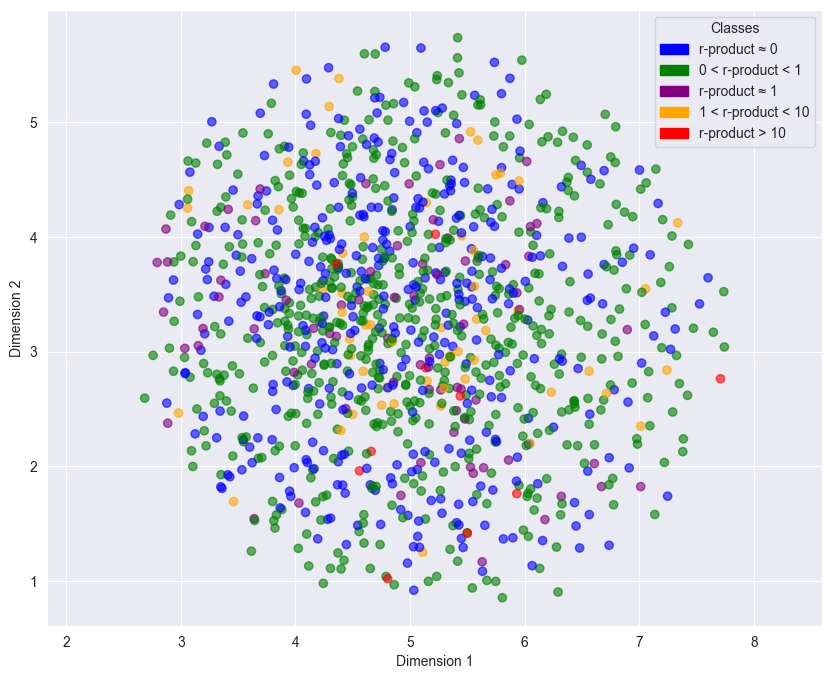

In [69]:
import json
import numpy as np
import umap
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as mpatches

# Load the JSON data
with open('./collected_data/extracted_data_collected.json', 'r') as file:
    data = json.load(file)

# Function to sort and combine fingerprints
def sort_and_combine_fingerprints(fingerprint_1, fingerprint_2, fingerprint_solvent):
    if sum(fingerprint_1) < sum(fingerprint_2):
        fingerprint_1, fingerprint_2 = fingerprint_2, fingerprint_1
    combined_fingerprint = (np.array(fingerprint_1) + np.array(fingerprint_2) + np.array(fingerprint_solvent))
    return combined_fingerprint

# Prepare data for UMAP and collect r1*r2 products for coloring
fingerprints = []
colors = []
color_labels = []
for entry in data:
    fingerprint_1 = entry['fingerprint_1']
    fingerprint_2 = entry['fingerprint_2']
    fingerprint_solvent = entry['solvent_fingerprint']
    combined_fingerprint = sort_and_combine_fingerprints(fingerprint_1, fingerprint_2, fingerprint_solvent)
    
    r1 = entry['r_values'].get('constant_1')
    r2 = entry['r_values'].get('constant_2')
    
    if r1 is not None and r2 is not None:
        fingerprints.append(combined_fingerprint)
        product = r1 * r2
        if product <= 0.1:
            colors.append('blue')
            color_labels.append('r-product ≈ 0')
        elif 0.1 < product <= 1:
            colors.append('green')
            color_labels.append('0 < r-product < 1')
        elif 1 < product <= 1.5:
            colors.append('purple')
            color_labels.append('r-product ≈ 1')
        elif 1.5 < product <= 10:
            colors.append('orange')
            color_labels.append('1 < r-product < 10')
        elif product > 10:
            colors.append('red')
            color_labels.append('r-product > 10')

# Ensure fingerprints and colors have the same length
fingerprints = np.array(fingerprints)
colors = np.array(colors)

# Verify the lengths are the same
print(f'Number of fingerprints: {len(fingerprints)}')
print(f'Number of colors: {len(colors)}')

# Scale the data
scaled_fingerprints = StandardScaler().fit_transform(fingerprints)

# Initialize UMAP and fit_transform the data
reducer = umap.UMAP()
embedding = reducer.fit_transform(scaled_fingerprints)

# Verify the lengths are the same after transformation
print(f'Number of embedding points: {len(embedding)}')
print(f'Number of colors: {len(colors)}')

# Define the order of colors and labels
ordered_labels_colors = [
    ('r-product ≈ 0', 'blue'),
    ('0 < r-product < 1', 'green'),
    ('r-product ≈ 1', 'purple'),
    ('1 < r-product < 10', 'orange'),
    ('r-product > 10', 'red')
]

# Create a 2D scatter plot
plt.figure(figsize=(10, 8))
scatter = plt.scatter(embedding[:, 0], embedding[:, 1], c=colors, alpha=0.6)
plt.gca().set_aspect('equal', 'datalim')

# Create legend
unique_color_labels = sorted(set(color_labels))
patches = [mpatches.Patch(color=color, label=label) for label, color in ordered_labels_colors if label in unique_color_labels]
plt.legend(handles=patches, title='Classes')

plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')

plt.savefig('2D_plot.pdf', bbox_inches='tight', dpi=300)
plt.show()


In [1]:
import json
from collections import Counter

# Load the JSON data
with open('collected_data/extracted_data_collected2.json', 'r') as file:
    data = json.load(file)

# Initialize counters and tracking variables
missing_solvent_count = 0
solvent_none = 0
missing_temperature_count = 0
missing_r_values_count = 0
missing_conf_intervals_count = 0

solvent_counter = Counter()
temperature_counter = Counter()
temperatures = []

# Analyze the data
for entry in data:
    if 'solvent' not in entry:
        missing_solvent_count += 1
    elif entry['solvent'] is None and entry['method']=='bulk':
        solvent_none += 1
    elif entry['solvent'] is None:
        missing_solvent_count += 1
    else:
        solvent_counter[entry['solvent']] += 1
    
    if 'temperature' not in entry or entry['temperature'] is None:
        missing_temperature_count += 1
    else:
        temperature_counter[entry['temperature']] += 1
        temperatures.append(entry['temperature'])
    
    if 'r_values' not in entry or not entry['r_values'] or entry['r_values'] is None:
        missing_r_values_count += 1
    
    if 'conf_intervals' not in entry or not entry['conf_intervals'] or entry['conf_intervals'] is None:
        missing_conf_intervals_count += 1

# Print the results
print(f"Missing solvent count: {missing_solvent_count}, Solvent none count: {solvent_none}")
print(f"Missing temperature count: {missing_temperature_count}")
print(f"Missing r_values count: {missing_r_values_count}")
print(f"Missing conf_intervals count: {missing_conf_intervals_count}")

# Calculate the total count of all solvents and temperatures
total_solvents = sum(solvent_counter.values())
total_temperatures = sum(temperature_counter.values())

print("\nSolvent occurrence count:")
for solvent, count in solvent_counter.items():
    print(f"{solvent}: {count}")
    
print(f"\nTotal number of unique solvents: {len(solvent_counter)}")
print(f"Total count of all solvents: {total_solvents}")

print("\nTemperature occurrence count:")
for temperature, count in temperature_counter.items():
    print(f"{temperature}: {count}")

print(f"\nTotal number of unique temperatures: {len(temperature_counter)}")
print(f"\nTotal number of unique temperatures: {len(temperature_counter)}")

print(f"Total count of all temperatures: {total_temperatures}")
print(f"Total count of all temperatures: {total_temperatures}")

Missing solvent count: 34, Solvent none count: 218
Missing temperature count: 45
Missing r_values count: 0
Missing conf_intervals count: 0

Solvent occurrence count:
ClC(Cl)(Cl)Cl: 5
ClC(Cl)Cl: 24
CC(C)=O: 30
C1COCCO1: 44
CC#N: 12
Cc1ccccc1: 58
O=C1CCCCC1: 25
c1ccccc1: 299
CC(C)(C)O: 14
CC(C)=O.O: 1
O: 52
CCO: 21
CO: 27
CN(C)C=O: 130
CCC(C)=O: 14
COC(=O)C(C)C: 1
CN1CCCC1=O: 4
C1CCCCC1: 1
CS(C)=O: 13
C1CCOC1: 46
ClCCl: 7
CCCCCC: 8
CC(=O)O: 3
CCOC(C)=O.c1ccccc1: 1
CCCCCCC: 7
CCOC(C)=O: 2
ClCCCl: 14
CCO.O: 1
Clc1ccccc1: 5
CC(C)=O.CO: 1
CC(C)O: 3
FC(F)(Cl)C(F)(Cl)Cl: 5
O=S(Cl)Cl: 2
COCCO: 2
CC#N.CCO: 1
COc1ccccc1: 1
N#Cc1ccccc1: 1
O=[N+]([O-])c1ccccc1: 1

Total number of unique solvents: 38
Total count of all solvents: 886

Temperature occurrence count:
60.0: 529
70.0: 103
20.0: 10
75.0: 35
65.0: 47
80.0: 43
5.0: 8
50.0: 134
45.0: 10
30.0: 36
60.3: 3
40.0: 8
110.0: 6
-78.0: 9
138.0: 1
130.0: 8
85.0: 4
55.0: 4
100.0: 3
76.0: 1
78.0: 3
150.0: 9
41.5: 2
86.5: 3
38.5: 1
67.5: 1
64.0: 2
160.0: 

/var/folders/tv/b0y73fwd4zn44s4jmxl5169w0000gn/T/ipykernel_58710/1763215826.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90)


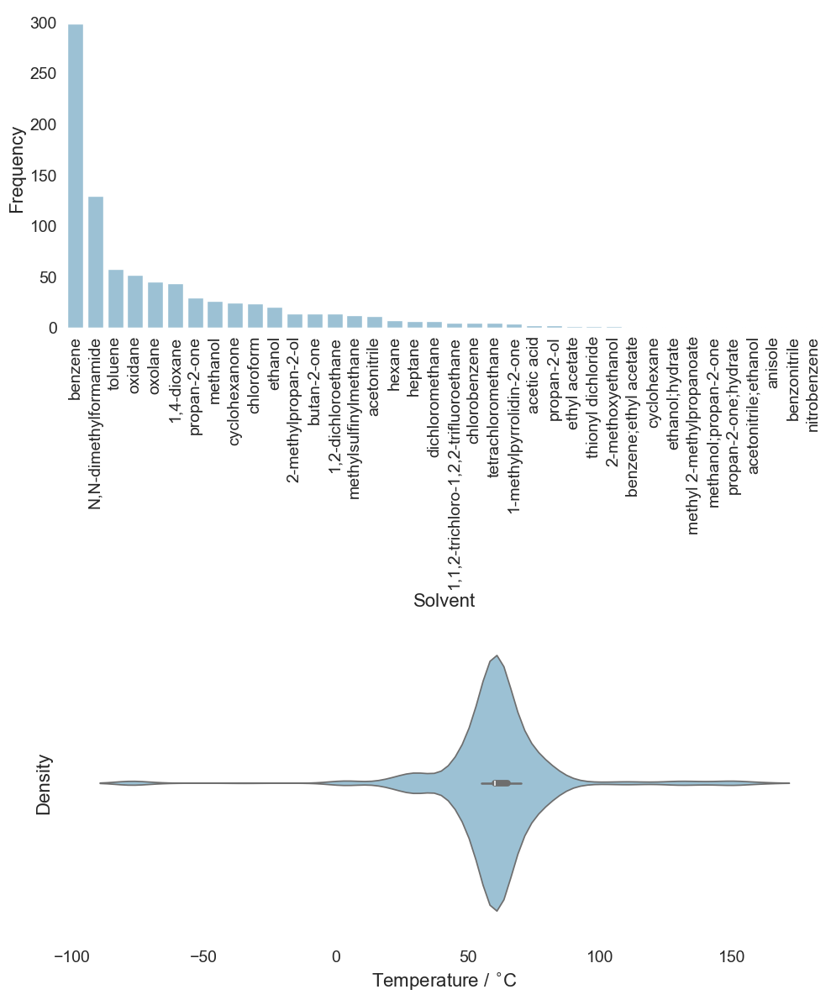

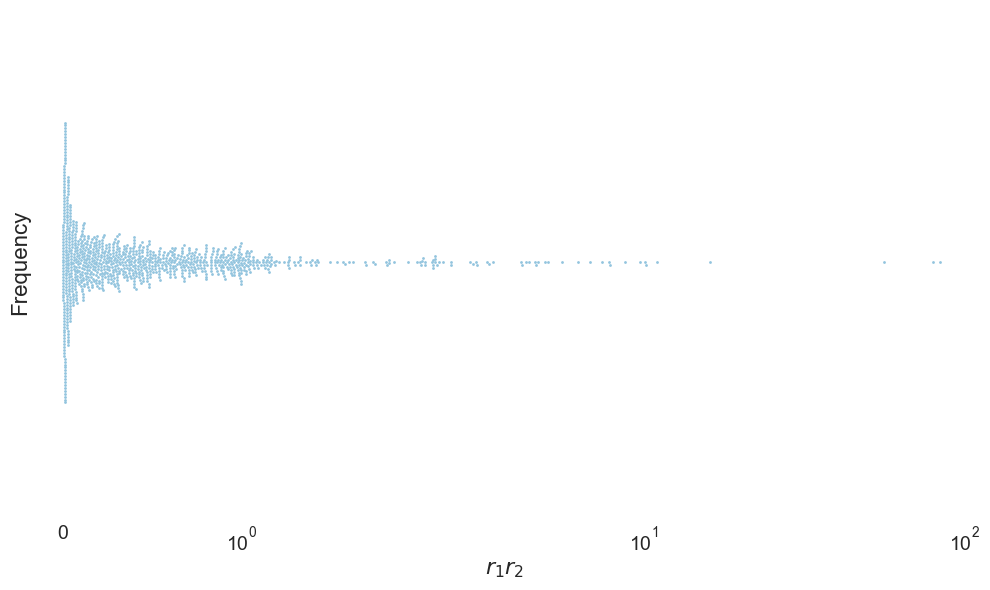

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import copolextractor.utils as utils


# DataFrame für Temperaturen
temperature_df = pd.DataFrame({'temperature': temperatures})

# DataFrame für Lösungsmittel
solvent_names = [utils.smiles_to_name(smiles) for smiles in solvent_counter.keys()]
solvent_counts = list(solvent_counter.values())
solvent_data = {'solvent': solvent_names, 'count': solvent_counts}
solvent_df = pd.DataFrame(solvent_data)
solvent_df = solvent_df.sort_values(by='count', ascending=False)

# Daten aus JSON-Datei laden
with open('collected_data/extracted_data_collected2.json', 'r') as file:
    data = json.load(file)

# Gültige Einträge filtern
valid_entries = [entry for entry in data if entry['r_values'] is not None 
                 and entry['r_values']['constant_1'] is not None 
                 and entry['r_values']['constant_2'] is not None 
                 and (entry['r_values']['constant_1'] * entry['r_values']['constant_2']) > 0]

# r1*r2 berechnen
r1r2 = [entry['r_values']['constant_1'] * entry['r_values']['constant_2'] for entry in valid_entries]
mean_columns = {'r1r2': r1r2}

# Subplots erstellen
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 12))

# Barplot erstellen
sns.barplot(x='solvent', y='count', data=solvent_df, color='#92C4DE', ax=axes[0])
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90)
axes[0].set_xlabel('Solvent', fontsize=16)
axes[0].set_ylabel('Frequency', fontsize=16)
axes[0].tick_params(axis='both', which='major', labelsize=14)
axes[0].grid(False)
axes[0].set_facecolor('white')

# Violinplot erstellen
sns.violinplot(x='temperature', data=temperature_df, color='#92C4DE', ax=axes[1])
axes[1].set_xlabel('Temperature / $^{\circ}$C', fontsize=16)
axes[1].set_ylabel('Density', fontsize=16)
axes[1].tick_params(axis='both', which='major', labelsize=14)
axes[1].grid(True)
axes[1].set_facecolor('white')

# Layout anpassen und speichern
plt.tight_layout()
fig.savefig('combined_bar_violin_plots.pdf', bbox_inches='tight', dpi=300)
plt.show()

# Separates Plot für Swarmplot
fig, ax = plt.subplots(figsize=(10, 6))
sns.swarmplot(x=mean_columns['r1r2'], ax=ax, s=2, color='#92C4DE')
ax.set_xscale('symlog')
ax.set_xlabel('$r_1r_2$', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.tick_params(axis='both', which='major', labelsize=14)
ax.grid(True)
ax.set_facecolor('white')
ax.set_xlim(-0.1, 100)

# Layout anpassen und speichern
plt.tight_layout()
fig.savefig('swarmplot_r1r2.pdf', bbox_inches='tight', dpi=300)
plt.show()

In [71]:
import json


data_file = './collected_data/extracted_data_collected2.json'

# Load the JSON data
with open(data_file, 'r') as file:
    data = json.load(file)

def is_within_deviation(actual_product, expected_product, deviation=0.10):
    if expected_product == 0:
        return actual_product == 0
    return abs(actual_product - expected_product) / abs(expected_product) <= deviation

# Initialize counters for matching and non-matching entries
matching_count = 0
non_matching_count = 0
skipped_count = 0

# Analyze the data
for entry in data:
    r1 = entry['r_values'].get('constant_1')
    r2 = entry['r_values'].get('constant_2')
    r_product = entry.get('r-product')
    
    if r_product is None:
        skipped_count += 1
        continue
    
    actual_product = r1 * r2
    
    # Check for division by zero
    if r_product == 0:
        deviation = float('inf') if actual_product != 0 else 0
    else:
        deviation = abs(actual_product - r_product) / abs(r_product)
    
    if is_within_deviation(actual_product, r_product):
        matching_count += 1
        entry['r-product_filter'] = False
    else:
        print('calculated: ', actual_product)
        print('extracted: ', r_product)
        print('deviation: ', deviation)
        non_matching_count += 1
        entry['r-product_filter'] = True # reaction should be filtered out

# Print the results
print(f"Matching entries count: {matching_count}")
print(f"Non-matching entries count: {non_matching_count}")
print(f"Skipped entries count (r-product is None): {skipped_count}")

with open(data_file, 'w') as file:
            json.dump(data, file, indent=4)


calculated:  0.0174
extracted:  0.02
deviation:  0.1300000000000001
calculated:  0.247
extracted:  0.83
deviation:  0.7024096385542169
calculated:  0.021
extracted:  0.21
deviation:  0.9
calculated:  -0.84
extracted:  0.25
deviation:  4.359999999999999
calculated:  -0.585
extracted:  0.15
deviation:  4.9
calculated:  -1.6800000000000002
extracted:  0.08
deviation:  22.000000000000004
calculated:  -1.365
extracted:  0.15
deviation:  10.1
calculated:  -1.474
extracted:  0.15
deviation:  10.826666666666666
calculated:  -0.78
extracted:  0.33
deviation:  3.3636363636363638
calculated:  0.705
extracted:  1.42
deviation:  0.5035211267605634
calculated:  0.44999999999999996
extracted:  2.22
deviation:  0.7972972972972974
calculated:  0.44
extracted:  2.28
deviation:  0.8070175438596491
calculated:  0.19499000000000002
extracted:  0.254
deviation:  0.23232283464566922
calculated:  0.8781700000000001
extracted:  1.014
deviation:  0.13395463510848116
calculated:  0.0234
extracted:  0.02
deviatio

In [2]:
from rdkit import Chem
from rdkit.Chem import Descriptors
import json


data_file = '../data_extraction/data_extraction_GPT-4o/collected_data/extracted_data_with_fp.json'

# Load the JSON data
with open(data_file, 'r') as file:
    data = json.load(file)
    
failed_smiles = set()

def calculate_logP(smiles):
    try:
        mol = Chem.MolFromSmiles(smiles)
        if mol is not None:
            logP = Descriptors.MolLogP(mol)
            return logP
        else:
            print(f"Conversion failed for SMILES: {smiles}")
            return None
    except Exception as e:
        print(f"Error processing SMILES: {smiles} with error {e}")
        return None

for reaction in data:
    if reaction['solvent'] is None:
        continue
    smiles = reaction['solvent']
    logP_value = calculate_logP(smiles)
    if logP_value is not None:
        reaction['solvent_logP'] = logP_value
        print(f"The LogP value for {smiles} is {logP_value}.")
    else:
        print(f"Failed to calculate LogP for SMILES: {smiles}")
        failed_smiles.add(smiles)

print(failed_smiles)
with open(data_file, 'w') as file:
    json.dump(data, file, indent=4)

JSONDecodeError: Expecting value: line 136592 column 12 (char 2327272)